# Data Analytics Capstone Project

## Education Success Rates based on Various factors 
<b>Author: Naiema Elsaadi
<br><b>Date: November 21, 2023

## Introduction
<b> This project focuses on Education. Education is often the most important pillar
of success in the world today. Success in the classroom can be a good indicator
of future success in employment, as well as be the beginning of a life of financial
fulfillment. The data problems that this project hopes to analyze, are the factors
that lead to student success in school vs the factors that lead to failure in school.
This is significantly important in today’s world, because education is proven to
be very important in the future success of most people. This Project will attempt
to highlight the main factors that lead to student success and student failures,
so that people can be more aware of them.

## Importing Libraries

In [1]:

## Importing Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.cm as cm
import matplotlib as mpl
import warnings

## Importing Specific Modules from scikit-learn

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn import svm
from sklearn.ensemble import AdaBoostClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression

## Importing Metrics and Preprocessing Tools

from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import roc_auc_score, precision_score, recall_score, accuracy_score, f1_score, roc_curve
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

## Additional Import and Setup
warnings.filterwarnings('ignore')
%matplotlib inline

## Data Collection
<b>This data source is a source that contains information about academic success
and some variables that are connected to it. This source is found on Kaggle, it shows the Education Success Rates based on Various factors, and it is called ”Predict Student’s Dropout, Academic Success”
<br><b>The link to the source is:
https://www.kaggle.com/datasets/naveenkumar20bps1137/predict-students-dropout-and-academic-success?select=dataset.csv

## Data Loading
<br><b> The data was loaded from a CSV file named "data.csv" using the panda library in Python.

In [2]:
## read a CSV file 
df = pd.read_csv("data.csv")
## Print the Data
print(df)

      Marital status  Application mode  Application order  Course  \
0                  1                17                  5     171   
1                  1                15                  1    9254   
2                  1                 1                  5    9070   
3                  1                17                  2    9773   
4                  2                39                  1    8014   
...              ...               ...                ...     ...   
4419               1                 1                  6    9773   
4420               1                 1                  2    9773   
4421               1                 1                  1    9500   
4422               1                 1                  1    9147   
4423               1                10                  1    9773   

      Daytime/evening attendance\t  Previous qualification  \
0                                1                       1   
1                                1             

# Exploratory Data Analysis

<b>
Exploratory Data Analysis (EDA) is a critical step in the data analysis process. It involves examining and visualizing the dataset to gain a <b>better understanding of its characteristics, structure, and relationships between variables.

## Data Summary:
<b> The data summary was started by obtaining a general overview of the dataset using functions like head(), info(), tail(), dtypes, counts() and describe() to look at the first few rows, data types, and summary statistics.

In [3]:
# View all of the data
df

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125.0,1,1,1,...,0,6,8,5,12.666667,0,15.5,2.8,-4.06,Graduate
4420,1,1,2,9773,1,1,120.0,105,1,1,...,0,6,6,2,11.000000,0,11.1,0.6,2.02,Dropout
4421,1,1,1,9500,1,1,154.0,1,37,37,...,0,8,9,1,13.500000,0,13.9,-0.3,0.79,Dropout
4422,1,1,1,9147,1,1,180.0,1,37,37,...,0,5,6,5,12.000000,0,9.4,-0.8,-3.12,Graduate


In [4]:
# Display the First Few Rows of the DataFrame
df.head()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate


In [5]:
# Display the last few rows of the DataFrame
df.tail()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
4419,1,1,6,9773,1,1,125.0,1,1,1,...,0,6,8,5,12.666667,0,15.5,2.8,-4.06,Graduate
4420,1,1,2,9773,1,1,120.0,105,1,1,...,0,6,6,2,11.000000,0,11.1,0.6,2.02,Dropout
4421,1,1,1,9500,1,1,154.0,1,37,37,...,0,8,9,1,13.500000,0,13.9,-0.3,0.79,Dropout
4422,1,1,1,9147,1,1,180.0,1,37,37,...,0,5,6,5,12.000000,0,9.4,-0.8,-3.12,Graduate
4423,1,10,1,9773,1,1,152.0,22,38,37,...,0,6,6,6,13.000000,0,12.7,3.7,-1.70,Graduate


In [6]:
# Check the shape 
df.shape

(4424, 37)

In [7]:
# Check the basic information of the DataFrame
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4424 entries, 0 to 4423
Data columns (total 37 columns):
 #   Column                                          Non-Null Count  Dtype  
---  ------                                          --------------  -----  
 0   Marital status                                  4424 non-null   int64  
 1   Application mode                                4424 non-null   int64  
 2   Application order                               4424 non-null   int64  
 3   Course                                          4424 non-null   int64  
 4   Daytime/evening attendance	                     4424 non-null   int64  
 5   Previous qualification                          4424 non-null   int64  
 6   Previous qualification (grade)                  4424 non-null   float64
 7   Nacionality                                     4424 non-null   int64  
 8   Mother's qualification                          4424 non-null   int64  
 9   Father's qualification                   

In [8]:
##  Display the types of DataFrames
df.dtypes

Marital status                                      int64
Application mode                                    int64
Application order                                   int64
Course                                              int64
Daytime/evening attendance\t                        int64
Previous qualification                              int64
Previous qualification (grade)                    float64
Nacionality                                         int64
Mother's qualification                              int64
Father's qualification                              int64
Mother's occupation                                 int64
Father's occupation                                 int64
Admission grade                                   float64
Displaced                                           int64
Educational special needs                           int64
Debtor                                              int64
Tuition fees up to date                             int64
Gender        

In [9]:
# Summary Statistics
df.describe()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP
count,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,...,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000,4424.000000
mean,1.178571,18.669078,1.727848,8856.642631,0.890823,4.577758,132.613314,1.873192,19.561935,22.275316,...,0.137658,0.541817,6.232143,8.063291,4.435805,10.230206,0.150316,11.566139,1.228029,0.001969
std,0.605747,17.484682,1.313793,2063.566416,0.311897,10.216592,13.188332,6.914514,15.603186,15.343108,...,0.690880,1.918546,2.195951,3.947951,3.014764,5.210808,0.753774,2.663850,1.382711,2.269935
min,1.000000,1.000000,0.000000,33.000000,0.000000,1.000000,95.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.600000,-0.800000,-4.060000
25%,1.000000,1.000000,1.000000,9085.000000,1.000000,1.000000,125.000000,1.000000,2.000000,3.000000,...,0.000000,0.000000,5.000000,6.000000,2.000000,10.750000,0.000000,9.400000,0.300000,-1.700000
50%,1.000000,17.000000,1.000000,9238.000000,1.000000,1.000000,133.100000,1.000000,19.000000,19.000000,...,0.000000,0.000000,6.000000,8.000000,5.000000,12.200000,0.000000,11.100000,1.400000,0.320000
75%,1.000000,39.000000,2.000000,9556.000000,1.000000,1.000000,140.000000,1.000000,37.000000,37.000000,...,0.000000,0.000000,7.000000,10.000000,6.000000,13.333333,0.000000,13.900000,2.600000,1.790000
max,6.000000,57.000000,9.000000,9991.000000,1.000000,43.000000,190.000000,109.000000,44.000000,44.000000,...,12.000000,19.000000,23.000000,33.000000,20.000000,18.571429,12.000000,16.200000,3.700000,3.510000


In [10]:
# Displaying the first 10 rows of the DataFrame
df.head(10)

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate
5,2,39,1,9991,0,19,133.1,1,37,37,...,0,5,17,5,11.500000,5,16.2,0.3,-0.92,Graduate
6,1,1,1,9500,1,1,142.0,1,19,38,...,0,8,8,8,14.345000,0,15.5,2.8,-4.06,Graduate
7,1,18,4,9254,1,1,119.0,1,37,37,...,0,5,5,0,0.000000,0,15.5,2.8,-4.06,Dropout
8,1,1,3,9238,1,1,137.0,62,1,1,...,0,6,7,6,14.142857,0,16.2,0.3,-0.92,Graduate
9,1,1,1,9238,1,1,138.0,1,1,19,...,0,6,14,2,13.500000,0,8.9,1.4,3.51,Dropout


In [11]:
# Display the column names of the DataFrame:
df.columns

Index(['Marital status', 'Application mode', 'Application order', 'Course',
       'Daytime/evening attendance\t', 'Previous qualification',
       'Previous qualification (grade)', 'Nacionality',
       'Mother's qualification', 'Father's qualification',
       'Mother's occupation', 'Father's occupation', 'Admission grade',
       'Displaced', 'Educational special needs', 'Debtor',
       'Tuition fees up to date', 'Gender', 'Scholarship holder',
       'Age at enrollment', 'International',
       'Curricular units 1st sem (credited)',
       'Curricular units 1st sem (enrolled)',
       'Curricular units 1st sem (evaluations)',
       'Curricular units 1st sem (approved)',
       'Curricular units 1st sem (grade)',
       'Curricular units 1st sem (without evaluations)',
       'Curricular units 2nd sem (credited)',
       'Curricular units 2nd sem (enrolled)',
       'Curricular units 2nd sem (evaluations)',
       'Curricular units 2nd sem (approved)',
       'Curricular units 2nd

In [12]:
# Count the target values for each column
df.Target.value_counts()

Graduate    2209
Dropout     1421
Enrolled     794
Name: Target, dtype: int64

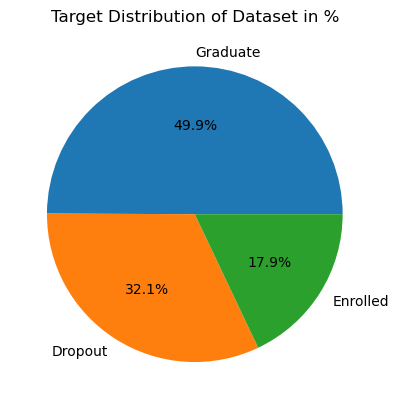

In [13]:
# Store the value counts in a variable
students_target =df['Target'].value_counts()

# Visualize the target variable percentages
plt.pie(students_target, labels=students_target.index, autopct='%2.1f%%')
plt.title('Target Distribution of Dataset in %')
plt.show()

<b> Approximately 50% of students in the dataset have graduated.

In [14]:
# Count the number of unique values in each column of the DataFrame
df.nunique()

Marital status                                      6
Application mode                                   18
Application order                                   8
Course                                             17
Daytime/evening attendance\t                        2
Previous qualification                             17
Previous qualification (grade)                    101
Nacionality                                        21
Mother's qualification                             29
Father's qualification                             34
Mother's occupation                                32
Father's occupation                                46
Admission grade                                   620
Displaced                                           2
Educational special needs                           2
Debtor                                              2
Tuition fees up to date                             2
Gender                                              2
Scholarship holder          

In [15]:
# Count the number of unique values in  column 'Age at enrollment' of the DataFrame
df['Age at enrollment'].unique()

array([20, 19, 45, 50, 18, 22, 21, 34, 37, 43, 55, 39, 29, 24, 27, 23, 26,
       33, 35, 25, 44, 36, 47, 28, 38, 30, 31, 32, 40, 42, 48, 49, 46, 41,
       70, 60, 53, 51, 52, 54, 61, 58, 59, 17, 57, 62], dtype=int64)

##  Data Cleaning and Preprocessing

<b> Data cleaning and preprocessing are crucial steps in any data analysis or machine learning project, including those related to education success rates. These steps help ensure that the data is accurate, consistent, and ready for analysis.
<br><b>Here are the key steps involved in data cleaning and preprocessing for this project.

<b>1) Handling Missing Data:</b>

In [16]:
## Checking for null values
df.isnull().sum()

Marital status                                    0
Application mode                                  0
Application order                                 0
Course                                            0
Daytime/evening attendance\t                      0
Previous qualification                            0
Previous qualification (grade)                    0
Nacionality                                       0
Mother's qualification                            0
Father's qualification                            0
Mother's occupation                               0
Father's occupation                               0
Admission grade                                   0
Displaced                                         0
Educational special needs                         0
Debtor                                            0
Tuition fees up to date                           0
Gender                                            0
Scholarship holder                                0
Age at enrol

In [17]:
# Remove rows with missing values
df.dropna(inplace=True)
df

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125.0,1,1,1,...,0,6,8,5,12.666667,0,15.5,2.8,-4.06,Graduate
4420,1,1,2,9773,1,1,120.0,105,1,1,...,0,6,6,2,11.000000,0,11.1,0.6,2.02,Dropout
4421,1,1,1,9500,1,1,154.0,1,37,37,...,0,8,9,1,13.500000,0,13.9,-0.3,0.79,Dropout
4422,1,1,1,9147,1,1,180.0,1,37,37,...,0,5,6,5,12.000000,0,9.4,-0.8,-3.12,Graduate


In [18]:
# Impute missing values
df['Nacionality'].fillna(df['Nacionality'].mean(), inplace=True)
df

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125.0,1,1,1,...,0,6,8,5,12.666667,0,15.5,2.8,-4.06,Graduate
4420,1,1,2,9773,1,1,120.0,105,1,1,...,0,6,6,2,11.000000,0,11.1,0.6,2.02,Dropout
4421,1,1,1,9500,1,1,154.0,1,37,37,...,0,8,9,1,13.500000,0,13.9,-0.3,0.79,Dropout
4422,1,1,1,9147,1,1,180.0,1,37,37,...,0,5,6,5,12.000000,0,9.4,-0.8,-3.12,Graduate


In [19]:
# Specify the columns for which the missing values will be filled with their means
columns_to_fill = ['Marital status', 'Application mode', 'Application order']

# Fill missing values with the means of the specified columns
df[columns_to_fill] = df[columns_to_fill].fillna(df[columns_to_fill].mean())

# Display the first few rows of the DataFrame to verify the changes
df.head()


,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate


<b> 2- Handling Duplicates:<br>
    Check for and remove duplicate rows to avoid redundancy in the dataset.

In [20]:
# Check for duplicates
duplicates = df.duplicated()

# Remove duplicates
df.drop_duplicates(inplace=True)
df

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.000000,0,10.8,1.4,1.74,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,13.666667,0,13.9,-0.3,0.79,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.000000,0,10.8,1.4,1.74,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.400000,0,9.4,-0.8,-3.12,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.000000,0,13.9,-0.3,0.79,Graduate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125.0,1,1,1,...,0,6,8,5,12.666667,0,15.5,2.8,-4.06,Graduate
4420,1,1,2,9773,1,1,120.0,105,1,1,...,0,6,6,2,11.000000,0,11.1,0.6,2.02,Dropout
4421,1,1,1,9500,1,1,154.0,1,37,37,...,0,8,9,1,13.500000,0,13.9,-0.3,0.79,Dropout
4422,1,1,1,9147,1,1,180.0,1,37,37,...,0,5,6,5,12.000000,0,9.4,-0.8,-3.12,Graduate


<B>3- Round all the float values present inside the dataset to their nearest number</B>

In [21]:
# Round all float columns to their nearest whole number (0 decimal places)
df = df.round(0)
df

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122.0,1,19,12,...,0,0,0,0,0.0,0,11.0,1.0,2.0,Dropout
1,1,15,1,9254,1,1,160.0,1,1,3,...,0,6,6,6,14.0,0,14.0,-0.0,1.0,Graduate
2,1,1,5,9070,1,1,122.0,1,37,37,...,0,6,0,0,0.0,0,11.0,1.0,2.0,Dropout
3,1,17,2,9773,1,1,122.0,1,38,37,...,0,6,10,5,12.0,0,9.0,-1.0,-3.0,Graduate
4,2,39,1,8014,0,1,100.0,1,37,38,...,0,6,6,6,13.0,0,14.0,-0.0,1.0,Graduate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125.0,1,1,1,...,0,6,8,5,13.0,0,16.0,3.0,-4.0,Graduate
4420,1,1,2,9773,1,1,120.0,105,1,1,...,0,6,6,2,11.0,0,11.0,1.0,2.0,Dropout
4421,1,1,1,9500,1,1,154.0,1,37,37,...,0,8,9,1,14.0,0,14.0,-0.0,1.0,Dropout
4422,1,1,1,9147,1,1,180.0,1,37,37,...,0,5,6,5,12.0,0,9.0,-1.0,-3.0,Graduate


<b>4- Convert all the float values to integers

In [22]:
# Convert all float columns to integers
df[['Admission grade', 'Previous qualification (grade)', 'Curricular units 1st sem (grade)', 'Curricular units 2nd sem (grade)', 'Unemployment rate', 'Inflation rate', 'GDP']] = df[['Admission grade', 'Previous qualification (grade)', 'Curricular units 1st sem (grade)', 'Curricular units 2nd sem (grade)', 'Unemployment rate', 'Inflation rate', 'GDP']].astype(np.int64) 
df.head()

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nacionality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122,1,19,12,...,0,0,0,0,0,0,11,1,2,Dropout
1,1,15,1,9254,1,1,160,1,1,3,...,0,6,6,6,14,0,14,0,1,Graduate
2,1,1,5,9070,1,1,122,1,37,37,...,0,6,0,0,0,0,11,1,2,Dropout
3,1,17,2,9773,1,1,122,1,38,37,...,0,6,10,5,12,0,9,-1,-3,Graduate
4,2,39,1,8014,0,1,100,1,37,38,...,0,6,6,6,13,0,14,0,1,Graduate


<b>5- Rename one column

In [23]:
# Rename the column
df = df.rename(columns={'Nacionality': 'Nationality'})
df

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nationality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122,1,19,12,...,0,0,0,0,0,0,11,1,2,Dropout
1,1,15,1,9254,1,1,160,1,1,3,...,0,6,6,6,14,0,14,0,1,Graduate
2,1,1,5,9070,1,1,122,1,37,37,...,0,6,0,0,0,0,11,1,2,Dropout
3,1,17,2,9773,1,1,122,1,38,37,...,0,6,10,5,12,0,9,-1,-3,Graduate
4,2,39,1,8014,0,1,100,1,37,38,...,0,6,6,6,13,0,14,0,1,Graduate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125,1,1,1,...,0,6,8,5,13,0,16,3,-4,Graduate
4420,1,1,2,9773,1,1,120,105,1,1,...,0,6,6,2,11,0,11,1,2,Dropout
4421,1,1,1,9500,1,1,154,1,37,37,...,0,8,9,1,14,0,14,0,1,Dropout
4422,1,1,1,9147,1,1,180,1,37,37,...,0,5,6,5,12,0,9,-1,-3,Graduate


<b> 6- Change 'Dropout' to 0, 'Graduate' to 1 and 'Enrolled' to 2 in 'Target' column

In [24]:
# Change 'Dropout' to 0, 'Graduate' to 1 and 'Enrolled' to 2 in 'Target' column
df = df.replace({ 'Target' : { 'Dropout' : 0, 'Graduate' : 1, 'Enrolled' : 2 } })
df

,Marital status,Application mode,Application order,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nationality,Mother's qualification,Father's qualification,...,Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),Unemployment rate,Inflation rate,GDP,Target
0,1,17,5,171,1,1,122,1,19,12,...,0,0,0,0,0,0,11,1,2,0
1,1,15,1,9254,1,1,160,1,1,3,...,0,6,6,6,14,0,14,0,1,1
2,1,1,5,9070,1,1,122,1,37,37,...,0,6,0,0,0,0,11,1,2,0
3,1,17,2,9773,1,1,122,1,38,37,...,0,6,10,5,12,0,9,-1,-3,1
4,2,39,1,8014,0,1,100,1,37,38,...,0,6,6,6,13,0,14,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,1,1,6,9773,1,1,125,1,1,1,...,0,6,8,5,13,0,16,3,-4,1
4420,1,1,2,9773,1,1,120,105,1,1,...,0,6,6,2,11,0,11,1,2,0
4421,1,1,1,9500,1,1,154,1,37,37,...,0,8,9,1,14,0,14,0,1,0
4422,1,1,1,9147,1,1,180,1,37,37,...,0,5,6,5,12,0,9,-1,-3,1


<b> 7- Drop all of the columns that are not required

In [25]:
# Drop all of the columns that are not required
# Drop columns by index
df1 = df.drop(columns=['Application mode', 'Application order', 'Debtor', 'Marital status', 'Unemployment rate', 'Inflation rate', ], axis=1)
# Save the 'data' DataFrame to a new CSV file
df1.to_csv('cleandata.csv', index=False)
df1


,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nationality,Mother's qualification,Father's qualification,Mother's occupation,Father's occupation,Admission grade,...,Curricular units 1st sem (grade),Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),GDP,Target
0,171,1,1,122,1,19,12,5,9,127,...,0,0,0,0,0,0,0,0,2,0
1,9254,1,1,160,1,1,3,3,3,142,...,14,0,0,6,6,6,14,0,1,1
2,9070,1,1,122,1,37,37,9,9,125,...,0,0,0,6,0,0,0,0,2,0
3,9773,1,1,122,1,38,37,5,3,120,...,13,0,0,6,10,5,12,0,-3,1
4,8014,0,1,100,1,37,38,9,9,142,...,12,0,0,6,6,6,13,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4419,9773,1,1,125,1,1,1,5,4,122,...,14,0,0,6,8,5,13,0,-4,1
4420,9773,1,1,120,105,1,1,9,9,119,...,12,0,0,6,6,2,11,0,2,0
4421,9500,1,1,154,1,37,37,9,9,150,...,15,0,0,8,9,1,14,0,1,0
4422,9147,1,1,180,1,37,37,7,4,154,...,14,0,0,5,6,5,12,0,-3,1


## Univariate Analysis
<b>
Examine individual variables in isolation. Using histograms, bar charts, and summary statistics to understand the distribution and central tendencies of each variable.

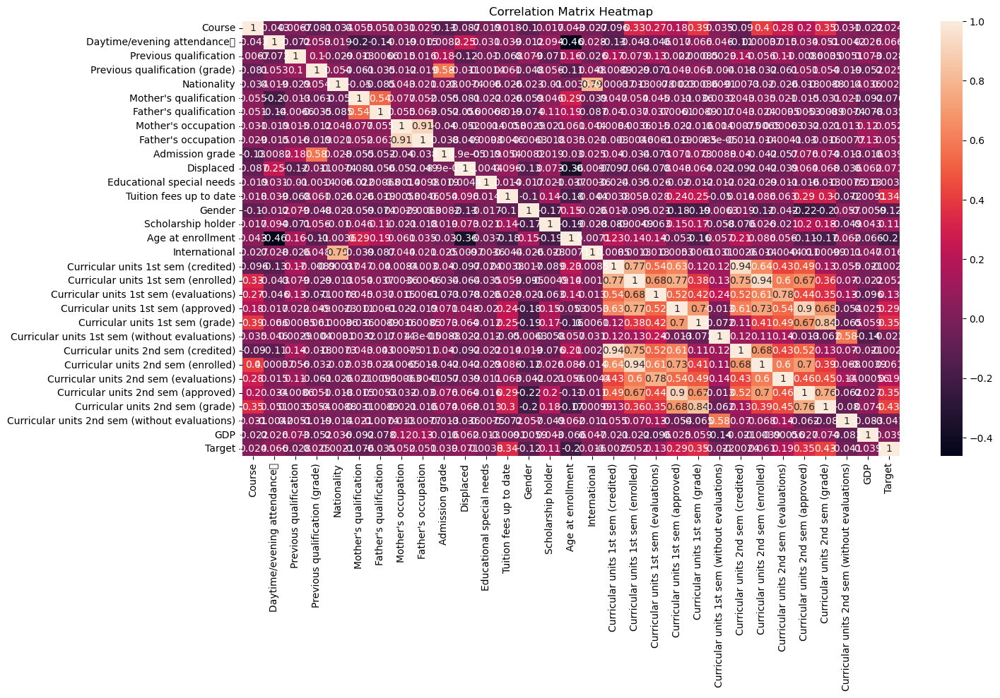

In [26]:
## Relationships Analysis
## Relationships between variables
# Set the figure size
plt.figure(figsize=(15, 8))

# Create a heatmap using Seaborn to visualize the correlation matrix
sns.heatmap(df1.select_dtypes(include=np.number).corr(), annot=True)

# Add a title to the heatmap
plt.title('Correlation Matrix Heatmap')

# Display the plot
plt.show()


<b>The heatmap above shows the correlations between all of the variables. Correlations between smaller subsets of the variables are seen below, with the correlations between the demographic variables in one heatmap, the correlations between the socio-economic variables in another heatmap, the correlations between the macro-economic enrollment variables in another heatmap, and finally the correlations between the academic variables in another heatmap.

In [27]:
# Demographic data
demo_data = df1[[ "Nationality", "Displaced", "Gender", "Age at enrollment", "International", "Target"]]

# Socio-economic data
se_data = df1[["Mother's qualification", "Father's qualification", "Mother's occupation", "Father's occupation", "Educational special needs", "Tuition fees up to date", "Scholarship holder", "Target"]]

# Macro-economic Enrollment Data
me_data = df1[[  'GDP', 'Course', 'Daytime/evening attendance\t', 'Previous qualification', 'Target']]

# Academic data
academic_data = df1[['Curricular units 1st sem (credited)',
       'Curricular units 1st sem (enrolled)',
       'Curricular units 1st sem (evaluations)',
       'Curricular units 1st sem (approved)',
       'Curricular units 1st sem (grade)',
       'Curricular units 1st sem (without evaluations)',
       'Curricular units 2nd sem (credited)',
       'Curricular units 2nd sem (enrolled)',
       'Curricular units 2nd sem (evaluations)',
       'Curricular units 2nd sem (approved)',
       'Curricular units 2nd sem (grade)',
       'Curricular units 2nd sem (without evaluations)', 'Target']]

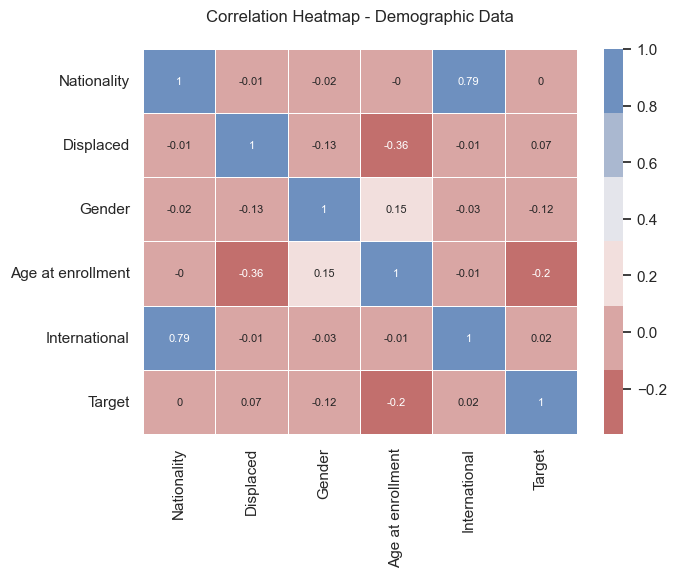

In [28]:
# Create the plot
sns.set(rc={"figure.figsize": (7, 5)})
sns.heatmap(demo_data.corr().round(2), linewidths=0.5,
            annot=True, annot_kws={"size": 8},
            cmap=sns.color_palette("vlag_r"))
# Customize the labels
plt.title('Correlation Heatmap - Demographic Data', pad=20)
# Show the plot
plt.show()

The heatmap above shows the correlations between all of the demographic variables.

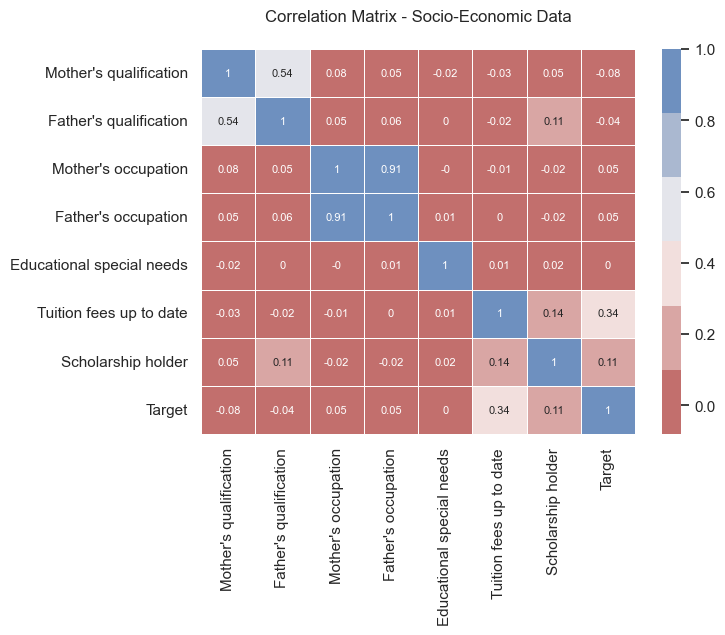

In [29]:
# Create the plot
sns.set(rc={"figure.figsize": (7, 5)})
sns.heatmap(se_data.corr().round(2), linewidths=0.5,
            annot=True, annot_kws={"size": 8},
            cmap=sns.color_palette("vlag_r"))
# Customize the labels
plt.title('Correlation Matrix - Socio-Economic Data', pad=20)
# Show the plot
plt.show()

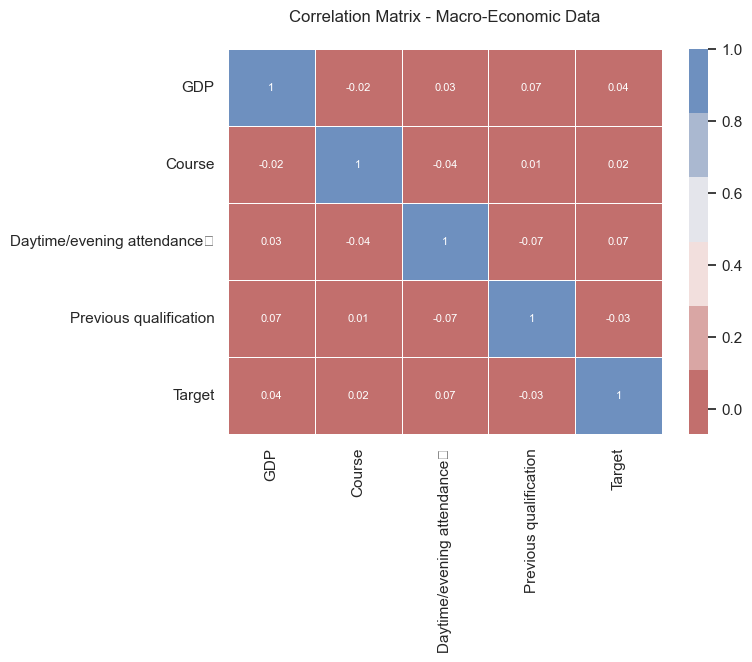

In [30]:
# Create the plot
sns.set(rc={"figure.figsize": (7, 5)})
sns.heatmap(me_data.corr().round(2), linewidths=0.5,
            annot=True, annot_kws={"size": 8},
            cmap=sns.color_palette("vlag_r"))
# Customize the labels
plt.title('Correlation Matrix - Macro-Economic Data', pad=20)
# Show the plot
plt.show()

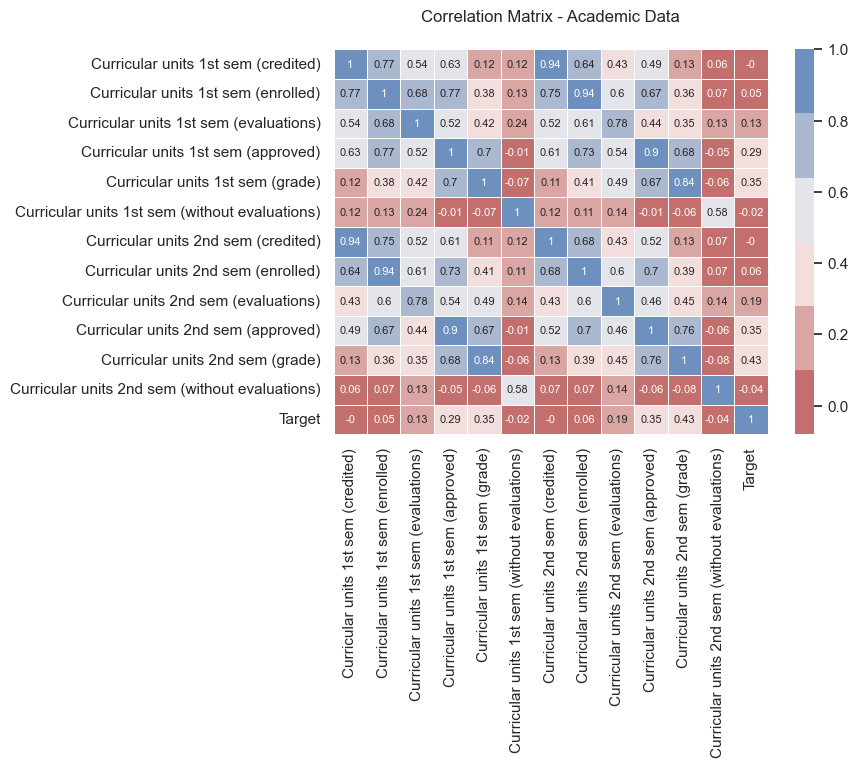

In [31]:
# Create the plot
sns.set(rc={"figure.figsize": (7, 5)})
sns.heatmap(academic_data.corr().round(2), linewidths=0.5,
            annot=True, annot_kws={"size": 8},
            cmap=sns.color_palette("vlag_r"))
# Customize the labels
plt.title('Correlation Matrix - Academic Data', pad=20)
# Show the plot
plt.show()

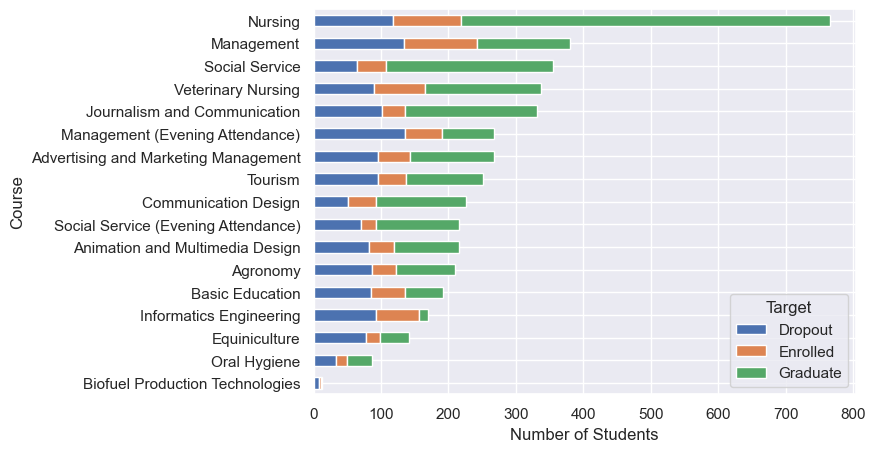

In [32]:
# Student's course affecting the academic success of students
# Revert numerical values in the 'Target' column back to categorical labels

df['Target'] = df['Target'].replace({0: 'Dropout', 1: 'Graduate', 2: 'Enrolled'})

student_course = df.groupby(['Course', 'Target']).size().reset_index().pivot(columns='Target', index='Course', values=0)

# Let's rename the index of the DataFrame
student_course = student_course.rename(index={
    33:'Biofuel Production Technologies',
    171:'Animation and Multimedia Design',
    8014:'Social Service (Evening Attendance)',
    9003:'Agronomy',9070:'Communication Design',
    9085:'Veterinary Nursing',
    9119:'Informatics Engineering',
    9130:'Equiniculture',
    9147:'Management',
    9238:'Social Service',
    9254:'Tourism',
    9500:'Nursing',
    9556:'Oral Hygiene',
    9670:'Advertising and Marketing Management',
    9773:'Journalism and Communication',
    9853:'Basic Education',
    9991:'Management (Evening Attendance)'})

student_course_total = student_course.sum(axis=1)
student_course_sorted = student_course_total.sort_values(ascending=True)
student_course.loc[student_course_sorted.index].plot(kind='barh', stacked=True)

plt.xlabel('Number of Students')
plt.show()

The above chart shows the number of student's who graduated/enrolled/dropped out of school based on the courses they took and their majors. The data shown here, shows that nursing majors have the highest graduation rates, while informative engineering majors have the lowest graduation rates.

<B>Seaborn's pairplot function can visually explore relationships, patterns, and potential correlations between variables in the dataset. This makes it a very usefull technique for exploratory data analysis, and because of that, it is being used for this project.

In [33]:
# Create a pair plot
sns.pairplot(df1)

# Show the plot
plt.show()

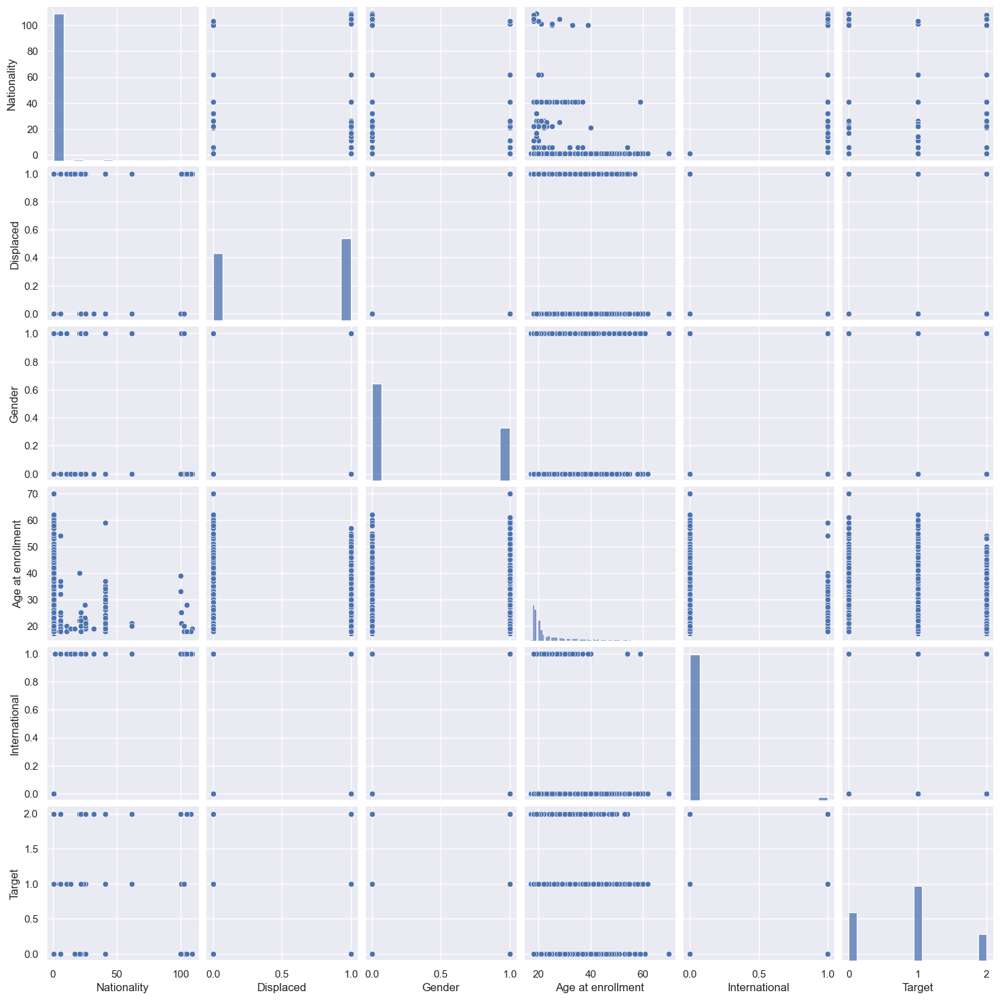

In [34]:
# Create a pair plot
sns.pairplot(demo_data)

# Show the plot
plt.show()

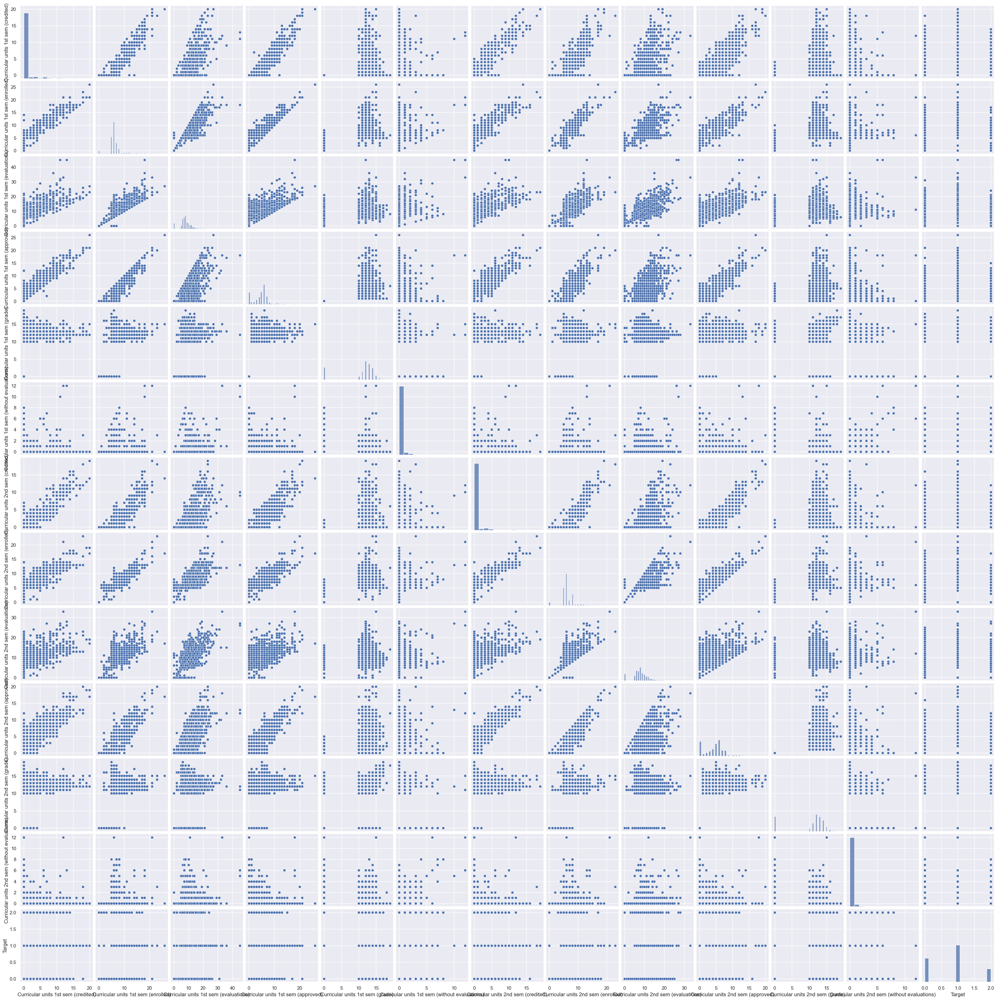

In [35]:
# Create a pair plot
sns.pairplot(academic_data)

# Show the plot
plt.show()

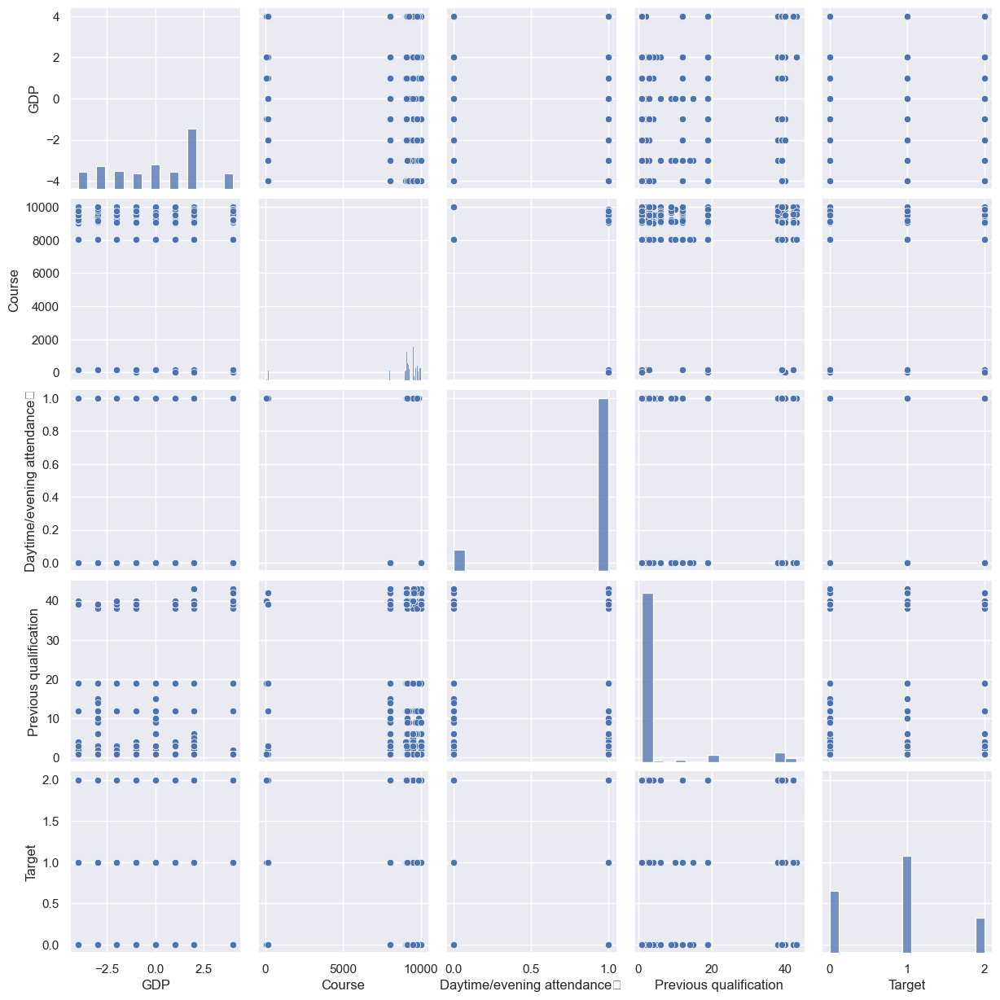

In [36]:
# Create a pair plot
sns.pairplot(me_data)

# Show the plot
plt.show()

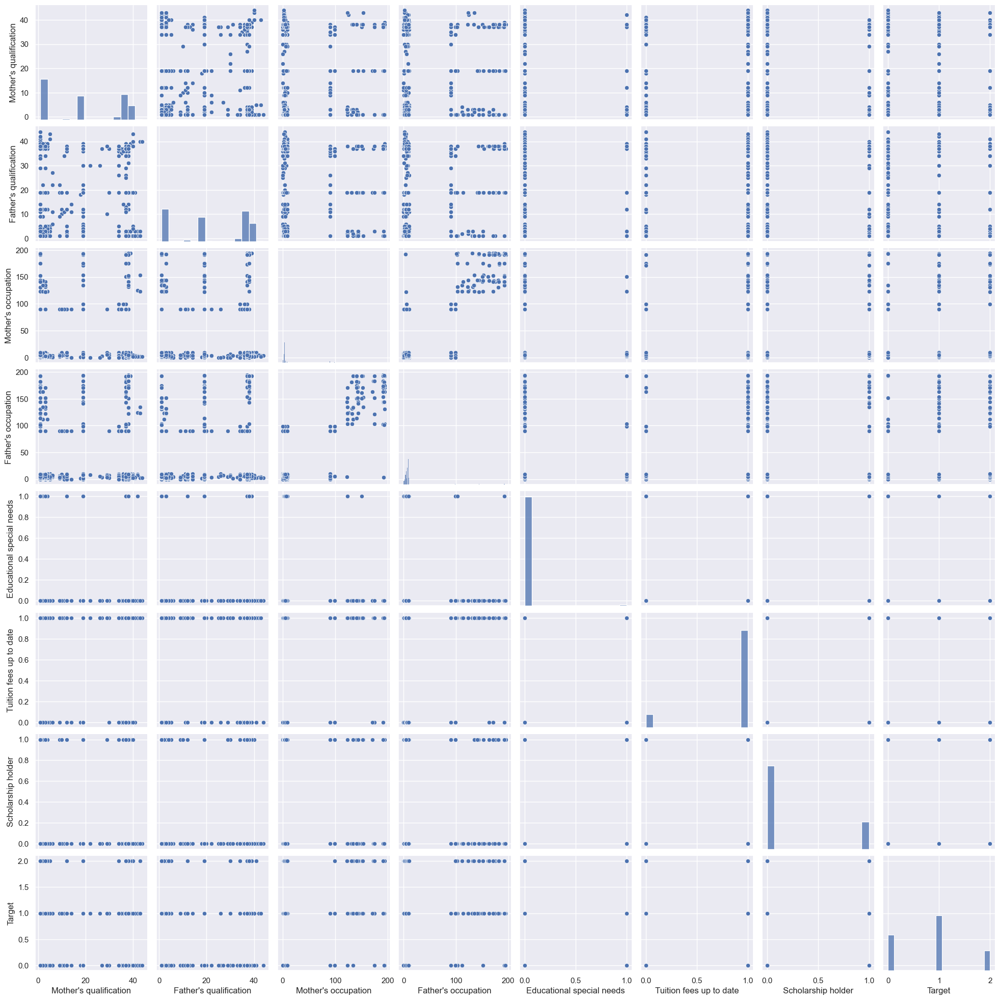

In [37]:
# Create a pair plot
sns.pairplot(se_data)

# Show the plot
plt.show()

<b>Creating a relational scatter plot with the variables "Mother's qualification," "Father's qualification," and differentiating points by the "Gender" variable.

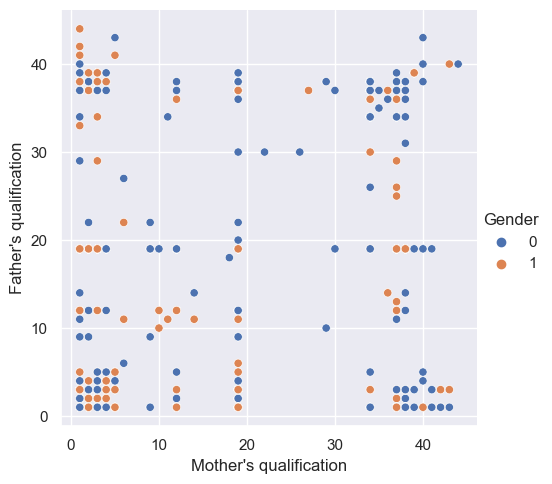

In [38]:
# Create a relational scatter plot
sns.relplot(x= "Mother's qualification", y= "Father's qualification", hue='Gender', data=df1) 
# Show the plot
plt.show()

The above graph shows the relational scatter plot between the father's and the mother's qualifications. In the gender section, 0 means female and 1 means male.

<b>Creating a distribution plot (histogram) for the "Admission grade" variable in the dataset. 
<br>This plot allows to visualize the distribution of values for that particular variable.

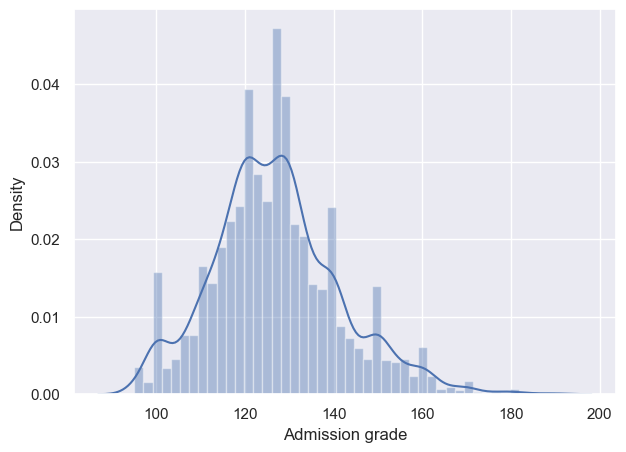

In [39]:
# Create a distribution plot for 'Admission grade'
sns.distplot(df1['Admission grade'])

# Show the plot
plt.show()


<b>Creating a box plot using Seaborn's catplot for all of the variables

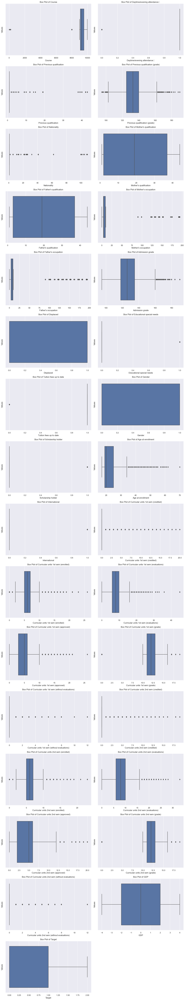

In [40]:

# Select numerical columns for the box plots
numerical_columns = df1.select_dtypes(include=['int', 'float']).columns

# Set the number of subplots based on the number of numerical columns
num_plots = len(numerical_columns)
num_rows = (num_plots // 2) + (num_plots % 2)  # Ensure an even layout

# Set the figure size
plt.figure(figsize=(15, 5 * num_rows))

# Create box plots for each numerical column
for i, column in enumerate(numerical_columns, start=1):
    plt.subplot(num_rows, 2, i)
    sns.boxplot(x=df1[column])
    plt.title(f'Box Plot of {column}')
    plt.xlabel(column)
    plt.ylabel('Values')

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()


<b>Histogram:
Visualizing the distribution of a numerical variable by creating a histogram.

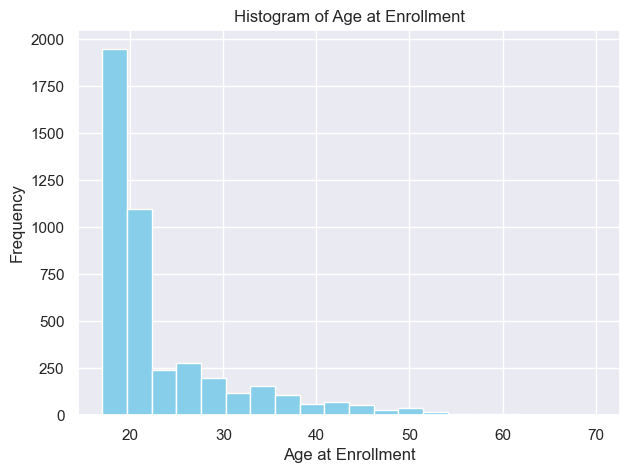

In [41]:
## Creating a histogram of the 'Age at enrollment' variable 
plt.hist(df1['Age at enrollment'], bins=20, color='skyblue')
plt.xlabel('Age at Enrollment')
plt.ylabel('Frequency')
plt.title('Histogram of Age at Enrollment')
plt.show()


The histogram above shows the distribution of the ages of the student in the dataset

<b> Generating a box plot for the specified columns, providing a visual representation of the distribution of values and highlighting any potential outliers.

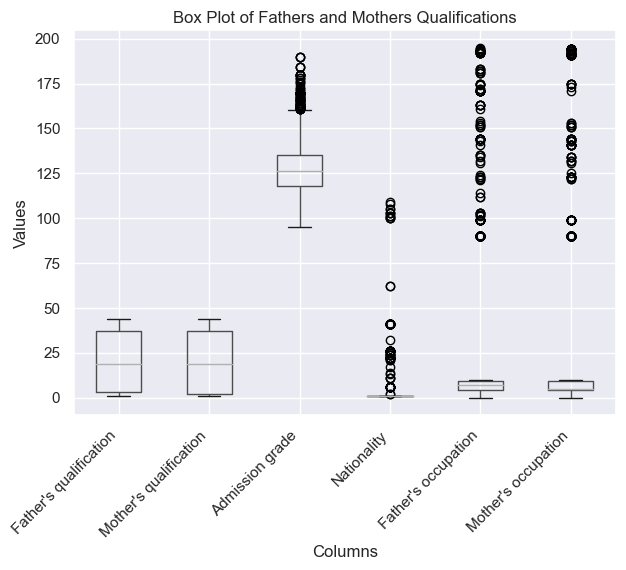

In [42]:
## Generate a combined box plot for the specified numerical columns, providing a visual representation of their distributions.

# Select multiple numerical columns for the box plot
numerical_columns = ["Father's qualification", "Mother's qualification", 'Admission grade', 'Nationality', "Father's occupation" , "Mother's occupation"]

# Create a box plot for the selected columns
df1[numerical_columns].boxplot()

# Add labels and title
plt.xlabel('Columns')
plt.ylabel('Values')
plt.title('Box Plot of Fathers and Mothers Qualifications')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
# Show the plot
plt.show()


<B> 

Violin plots combines box plots and kernel density plots to display the distribution of numerical variables.

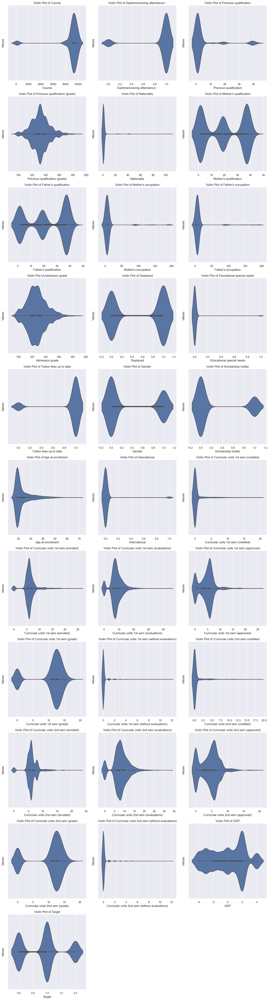

In [43]:

# Select numerical columns for the violin plots
numerical_columns = df1.select_dtypes(include=['int', 'float']).columns

# Set the number of subplots based on the number of numerical columns
num_plots = len(numerical_columns)
num_rows = (num_plots // 2) + (num_plots % 2)  # Ensure an even layout

# Set the figure size
plt.figure(figsize=(15, 5 * num_rows))

# Create violin plots for each numerical column
for i, column in enumerate(numerical_columns, start=1):
    plt.subplot(num_rows, 3, i)
    sns.violinplot(x=df1[column])
    plt.title(f'Violin Plot of {column}')
    plt.xlabel(column)
    plt.ylabel('Values')

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()



<b>Creating a box plot that shows the distribution of the data for the academic related variables. 

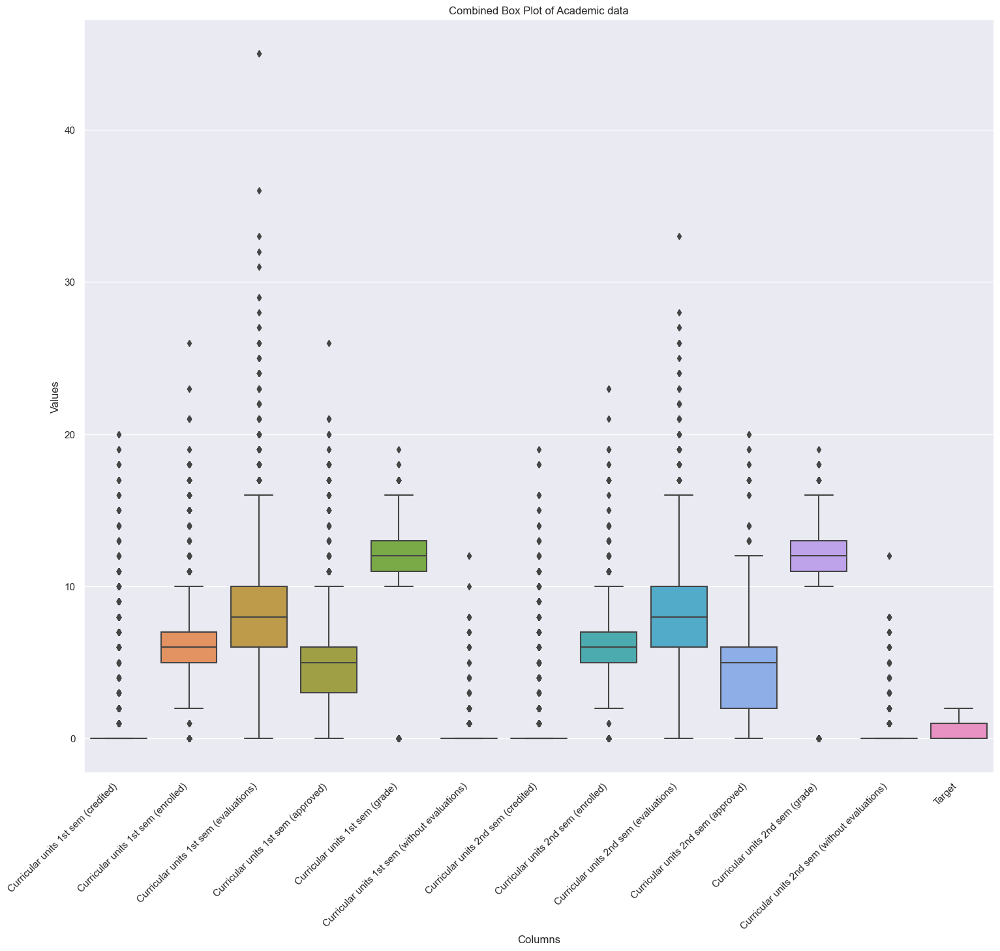

In [44]:
# Select numerical columns for the box plot
numerical_columns = academic_data.select_dtypes(include=['int', 'float']).columns

# Melt the DataFrame for Seaborn's box plot
melted_df = academic_data[numerical_columns].melt(var_name='Columns', value_name='Values')

# Set the figure size
plt.figure(figsize=(18, 15))

# Create a combined box plot using Seaborn
sns.boxplot(x='Columns', y='Values', data=melted_df)

# Add labels and title
plt.xlabel('Columns')
plt.ylabel('Values')
plt.title('Combined Box Plot of Academic data')

# Rotate x-axis labels for better visibility
plt.xticks(rotation=45, ha='right')

# Show the plot
plt.show()

The box plot above shows promising results and a good visualization of the data from the academic related variables.

<b>Creating a box plot that shows the distribution of the data for the macro-economic related variables.

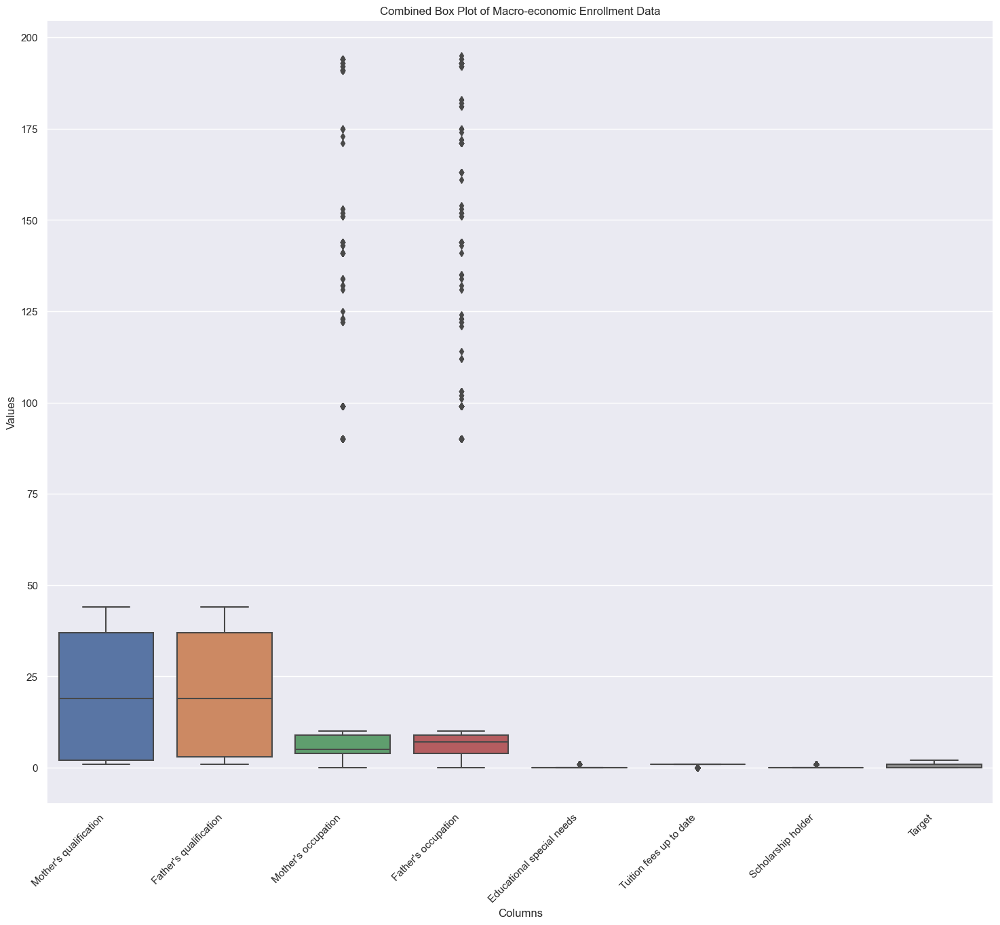

In [45]:
# Select numerical columns for the box plot
numerical_columns = se_data.select_dtypes(include=['int', 'float']).columns

# Melt the DataFrame for Seaborn's box plot
melted_df = se_data[numerical_columns].melt(var_name='Columns', value_name='Values')

# Set the figure size
plt.figure(figsize=(18, 15))

# Create a combined box plot using Seaborn
sns.boxplot(x='Columns', y='Values', data=melted_df)

# Add labels and title
plt.xlabel('Columns')
plt.ylabel('Values')
plt.title('Combined Box Plot of Macro-economic Enrollment Data')

# Rotate x-axis labels for better visibility
plt.xticks(rotation=45, ha='right')

# Show the plot
plt.show()

 ## Visualizing the dataset
<b>1) Visualizing the total number of students who dropout, graduated and enrolled

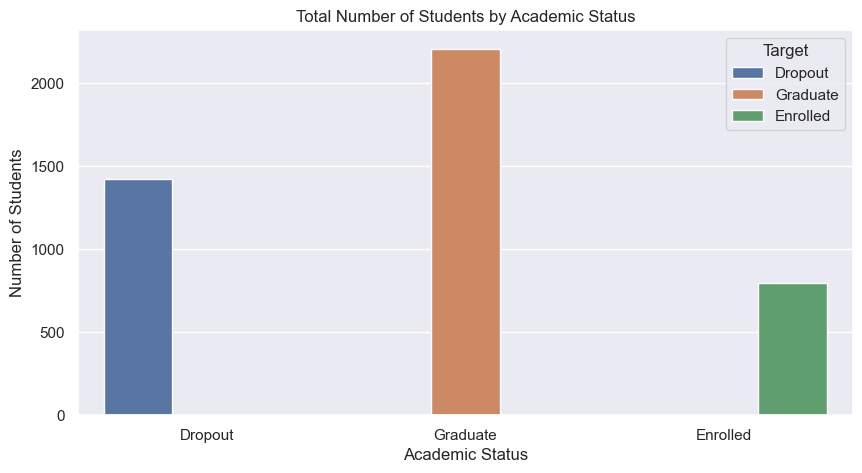

In [46]:
# Revert numerical values in the 'Target' column back to categorical labels
df3 = pd.read_csv("cleandata.csv")
df3['Target'] = df1['Target'].replace({0: 'Dropout', 1: 'Graduate', 2: 'Enrolled'})

# Set the figure size
sns.set(rc={'figure.figsize': (10, 5)})

# Create a count plot to visualize the total number of students for each academic status
sns.countplot(x=df3['Target'], hue=df3['Target'])

# Customize the plot
plt.title('Total Number of Students by Academic Status')
plt.xlabel('Academic Status')
plt.ylabel('Number of Students')

# Show the plot
plt.show()


The graph above visualizes the number of people in the dataset who graduated in comparison to the number of people in the dataset who dropped out and the number of people in the dataset who are currently enrolled.

<b>2) Visualizing the total number of students dropout, graduate and enrolled with respect to  Course

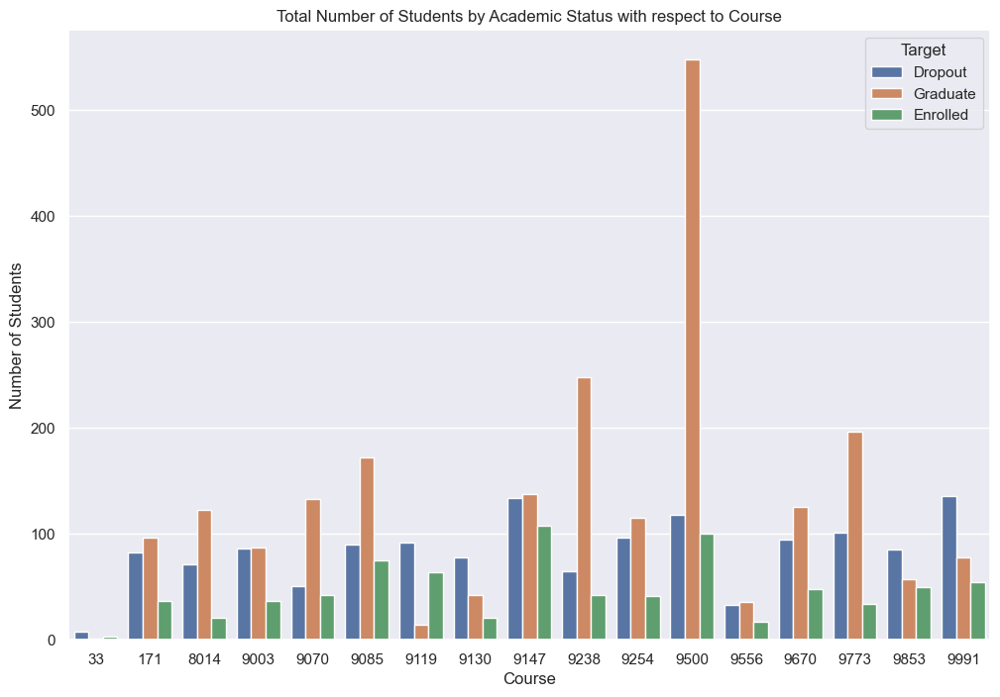

In [47]:
# Set the figure size
sns.set(rc={'figure.figsize': (12, 8)})

# Create a count plot to visualize the total number of students for each academic status with respect to 'Course'
sns.countplot(x=df1['Course'], hue=df3['Target'])

# Customize the plot
plt.title('Total Number of Students by Academic Status with respect to Course')
plt.xlabel('Course')
plt.ylabel('Number of Students')

# Show the plot
plt.show()

The above graph shows the graduation vs dropout vs enrolled rates for different courses. The graph shows that certain courses have higher graduation rates than others.

<b>3) Visualizing the total number of students dropout, graduate and enrolled with respect to attendance

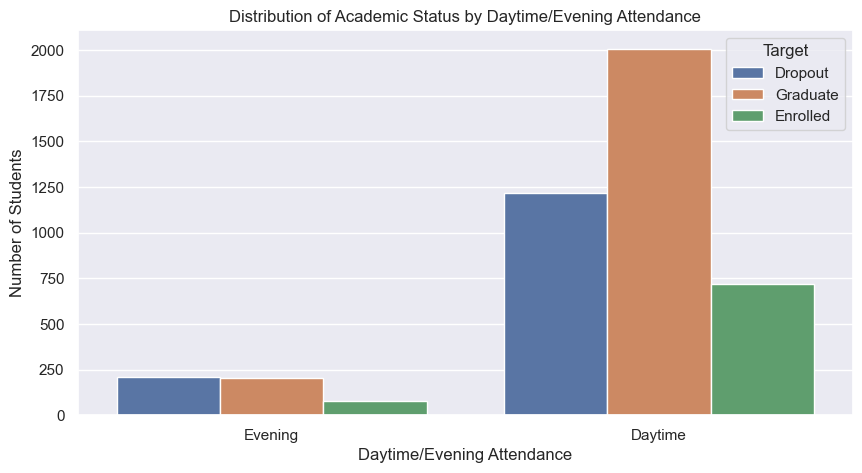

In [48]:
# Set the figure size
sns.set(rc={'figure.figsize': (10, 5)})

# Create a count plot to visualize the distribution of academic status by 'Daytime/evening attendance'
sns.countplot(x=df1['Daytime/evening attendance\t'], hue=df3['Target'])

# Customize the plot
plt.title('Distribution of Academic Status by Daytime/Evening Attendance')
plt.xlabel('Daytime/Evening Attendance')
plt.ylabel('Number of Students')

# Set x-axis labels
plt.xticks(ticks=[0, 1], labels=['Evening', 'Daytime'])

# Show the plot
plt.show()

The above graph shows that students who take their classes in the daytime are more likely to graduate than the students who take their classes in the evening.

<b>4) Visualizing the total number of students dropout, graduate and enrolled with respect to Gender

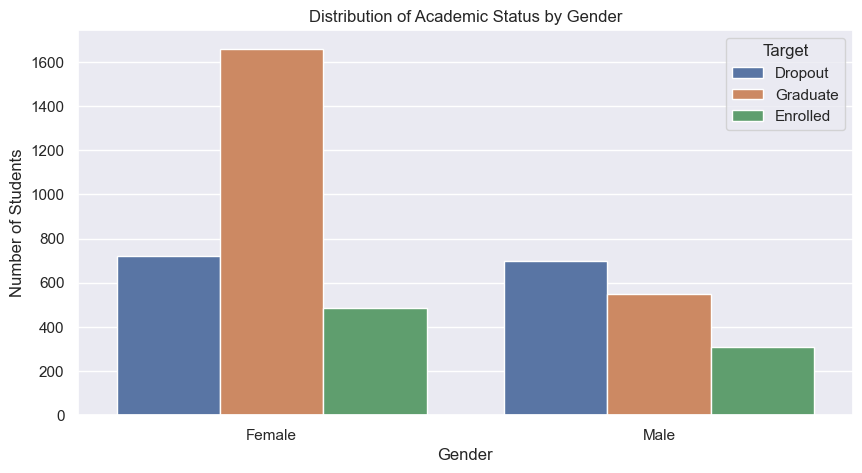

In [49]:


# Create a count plot to analyze the distribution of 'Target' by 'Gender'
sns.countplot(x=df3['Gender'], hue=df3['Target'])

# Customize the plot
plt.title('Distribution of Academic Status by Gender')
plt.xlabel('Gender')
plt.ylabel('Number of Students')

# Set x-axis labels
plt.xticks(ticks=[0, 1], labels=['Female', 'Male'])

# Show the plot
plt.show()

The graph above shows that the Female students in the data set have higher graduation rates than the Male students in the data set, showing that female students are more likely to graduate.

<b>5) Visualizing the total number of students dropout, graduate and enrolled with respect to Scholarship Holder

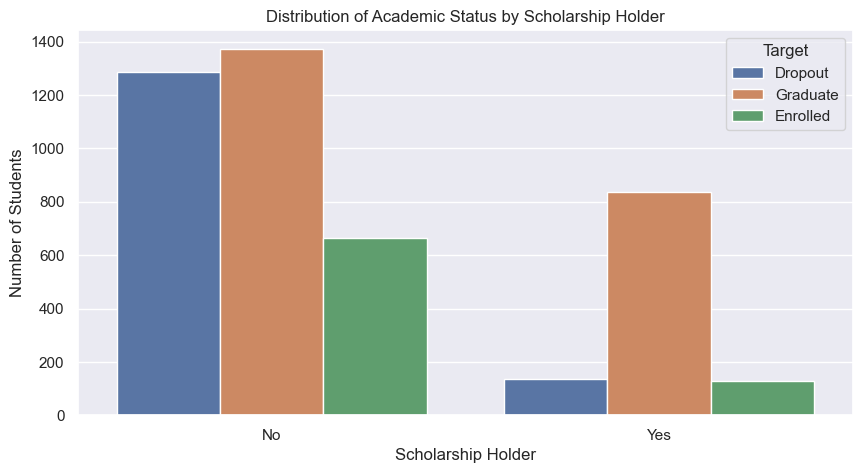

In [50]:
# Set the figure size
sns.set(rc={'figure.figsize': (10, 5)})

# Create a count plot to visualize the distribution of academic status by 'Scholarship holder'
sns.countplot(x=df1['Scholarship holder'], hue=df3['Target'])

# Customize the plot
plt.title('Distribution of Academic Status by Scholarship Holder')
plt.xlabel('Scholarship Holder')
plt.ylabel('Number of Students')

# Set x-axis labels
plt.xticks(ticks=[0, 1], labels=['No', 'Yes'])

# Show the plot
plt.show()


From the above graph, we can see that students with scholaships have higher chances of graduating than students who aren't scholarship holders.

<b>A histogram is a graphical representation of the distribution of a dataset. It is a way to visualize the underlying frequency distribution of a set of continuous or discrete data. The data is divided into intervals or bins, and the height of each bar in the histogram corresponds to the frequency (or count) of data points falling within that bin.

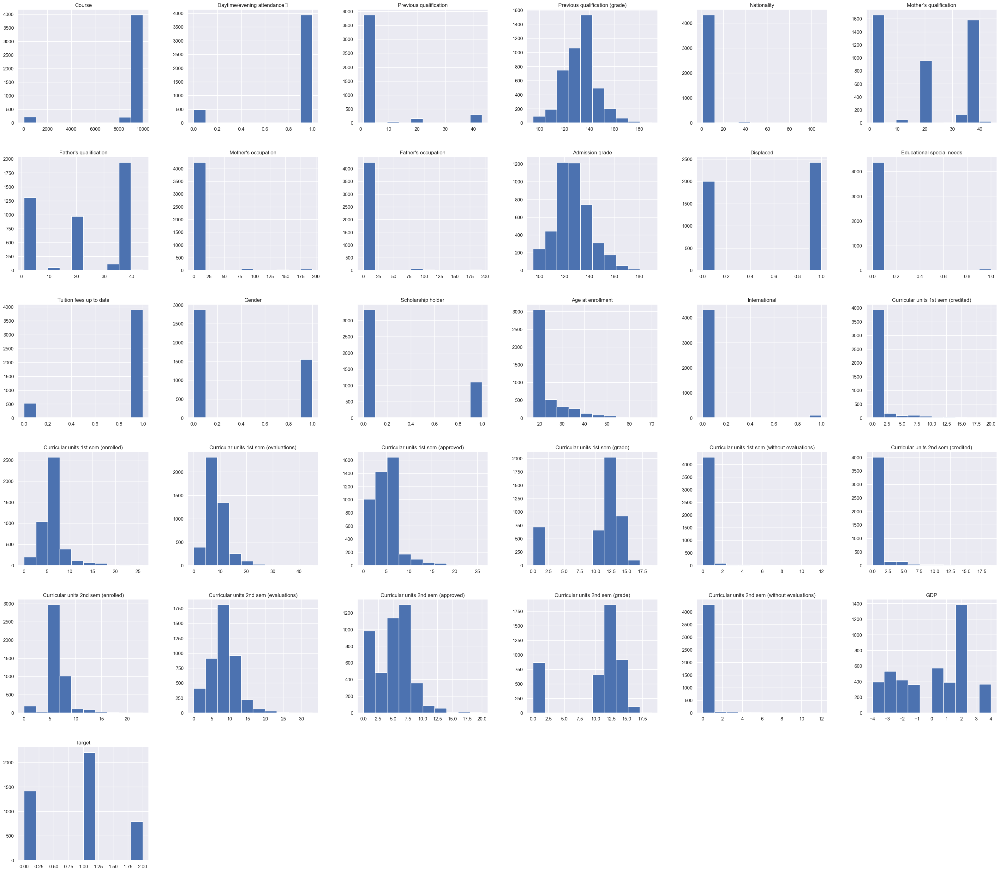

In [51]:
## histogram - visual representation
# create histograms for all DataFrame
sns.set_theme(style = 'darkgrid')
df1.hist(bins=10, figsize=(40, 35), grid=True, legend=None);

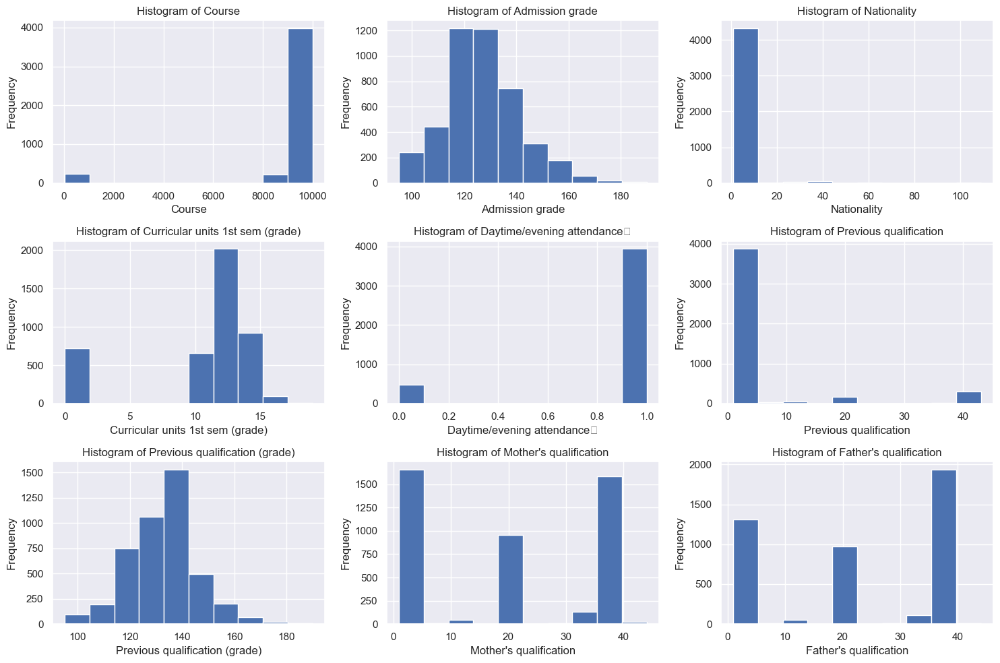

In [52]:


# Set the theme for the Seaborn plots
sns.set_theme(style='darkgrid')

# Specify the attributes you want to include in the histograms
selected_attributes = [ 'Course','Admission grade', 'Nationality', "Curricular units 1st sem (grade)" ,'Daytime/evening attendance\t', 'Previous qualification',"Previous qualification (grade)",  "Mother's qualification","Father's qualification" ]

# Set a larger figsize for better visibility
plt.figure(figsize=(15, 10))

# Loop through each selected attribute and create a subplot
for i, attribute in enumerate(selected_attributes, start=1):
    plt.subplot(3, 3, i)  # Adjust the number of rows and columns based on the number of attributes
    df1[attribute].hist(bins=10, grid=True)
    plt.title(f'Histogram of {attribute}')
    plt.xlabel(attribute)
    plt.ylabel('Frequency')

# Adjust layout to prevent overlapping
plt.tight_layout()
plt.show()
     

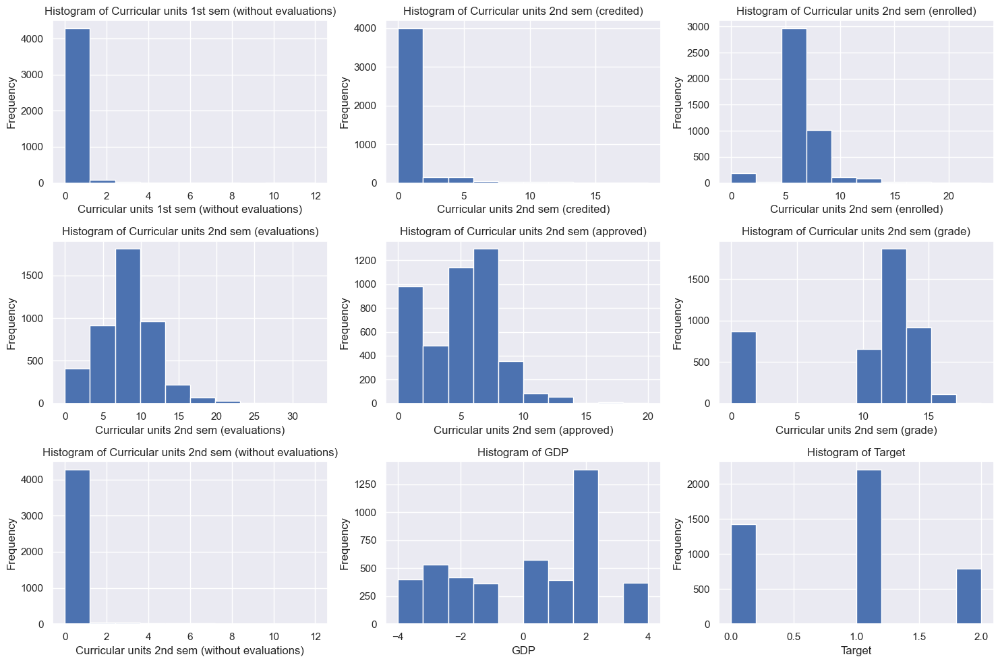

In [53]:


# Set the theme for the Seaborn plots
sns.set_theme(style='darkgrid')

# Specify the attributes you want to include in the histograms
selected_attributes = [ "Curricular units 1st sem (without evaluations)" ,"Curricular units 2nd sem (credited)", "Curricular units 2nd sem (enrolled)", "Curricular units 2nd sem (evaluations)", "Curricular units 2nd sem (approved)", "Curricular units 2nd sem (grade)", "Curricular units 2nd sem (without evaluations)", 'GDP', 'Target' ]
# Set a larger figsize for better visibility
plt.figure(figsize=(15, 10))

# Loop through each selected attribute and create a subplot
for i, attribute in enumerate(selected_attributes, start=1):
    plt.subplot(3, 3, i)  # Adjust the number of rows and columns based on the number of attributes
    df1[attribute].hist(bins=10, grid=True)
    plt.title(f'Histogram of {attribute}')
    plt.xlabel(attribute)
    plt.ylabel('Frequency')

# Adjust layout to prevent overlapping
plt.tight_layout()
plt.show()

<b>Attempting to extract the number of unique values for each column in the DataFrame

## Visualizations are powerful tools for Exploratory Data Analysis (EDA), as they enable analysts to quickly grasp the data distribution, identify relationships between variables, and pinpoint potential outliers. 
<b> The following code snippets aim to generate counts for each column in the DataFrame.  


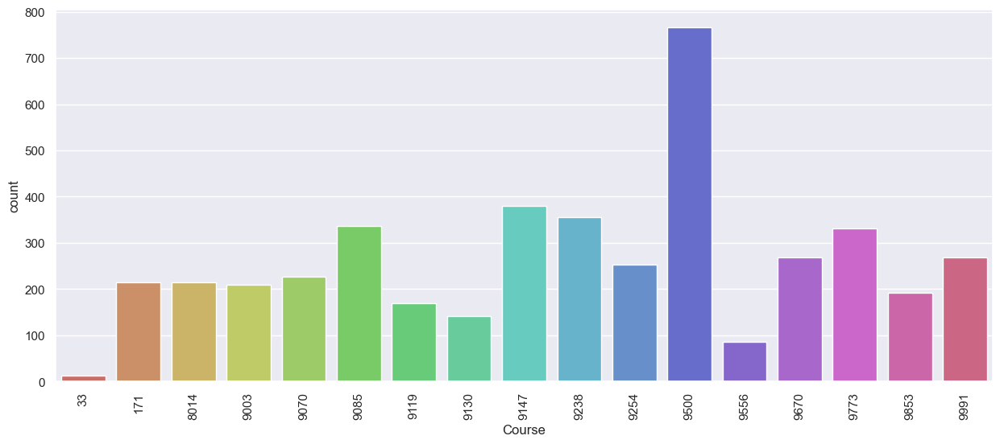

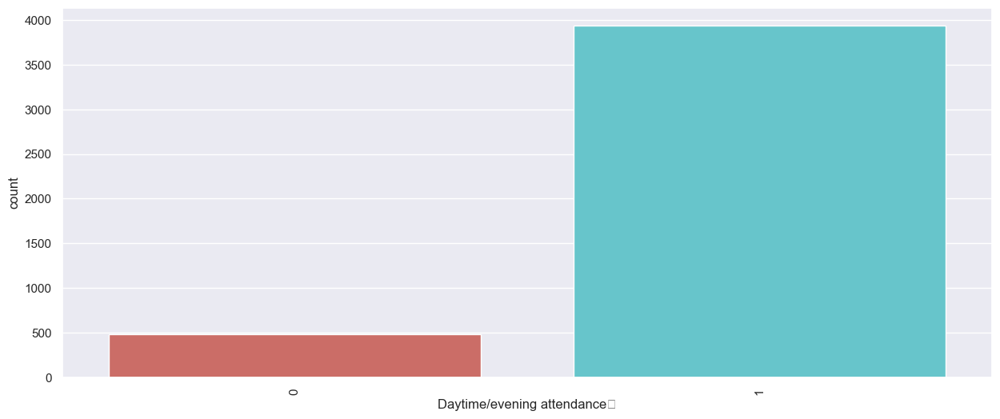

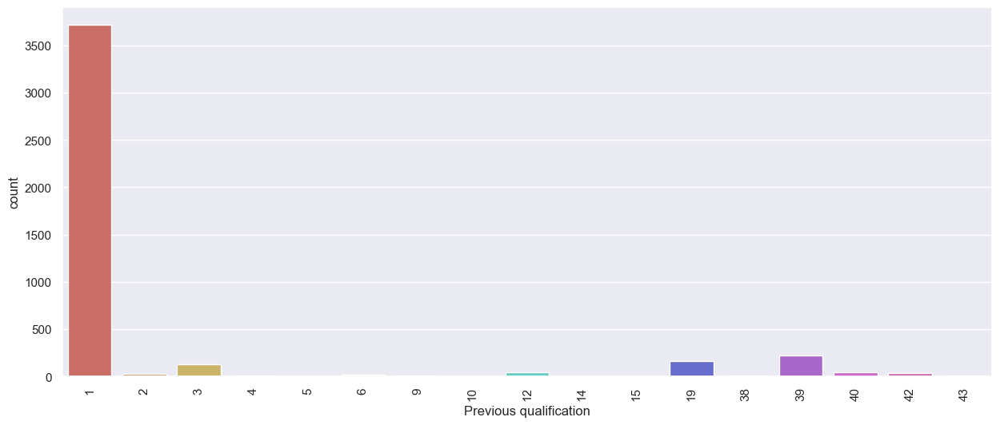

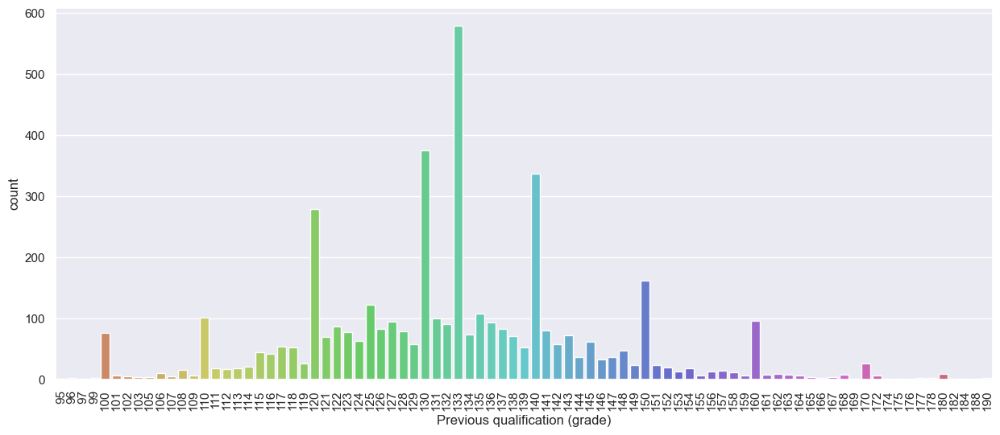

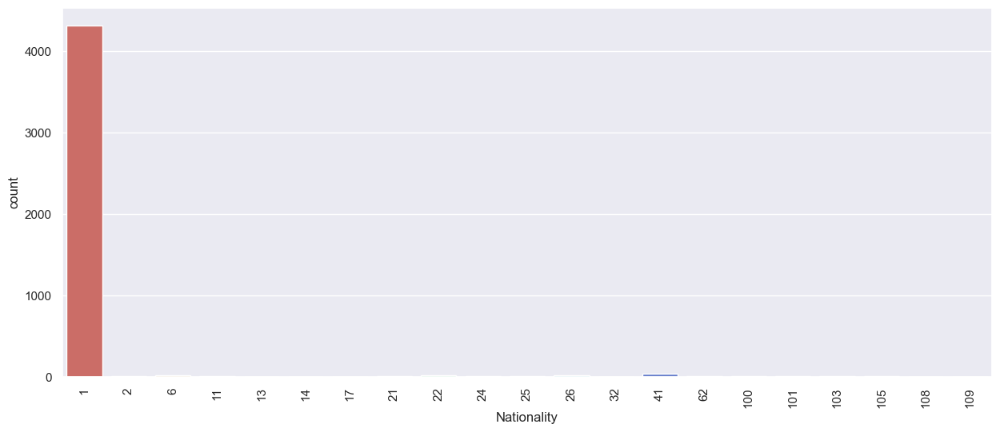

...

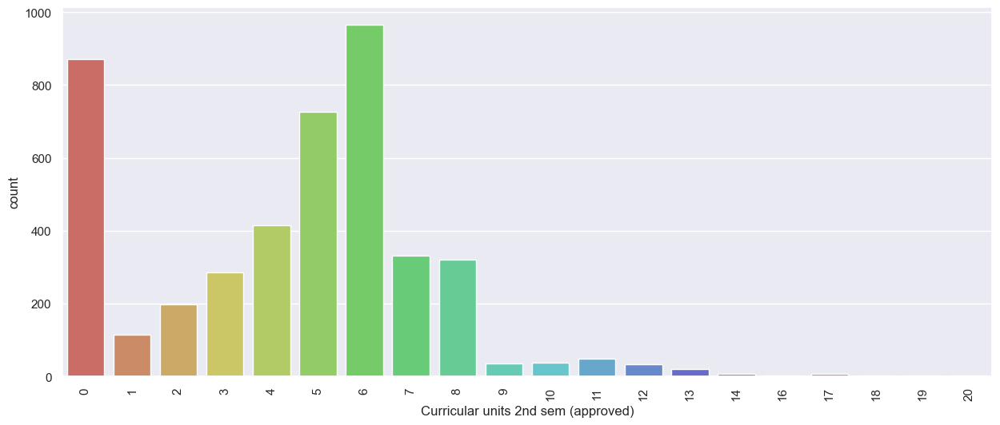

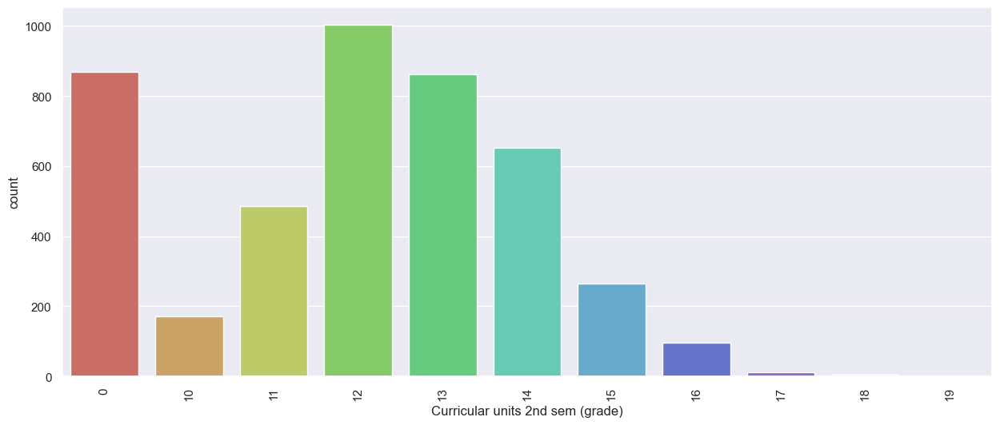

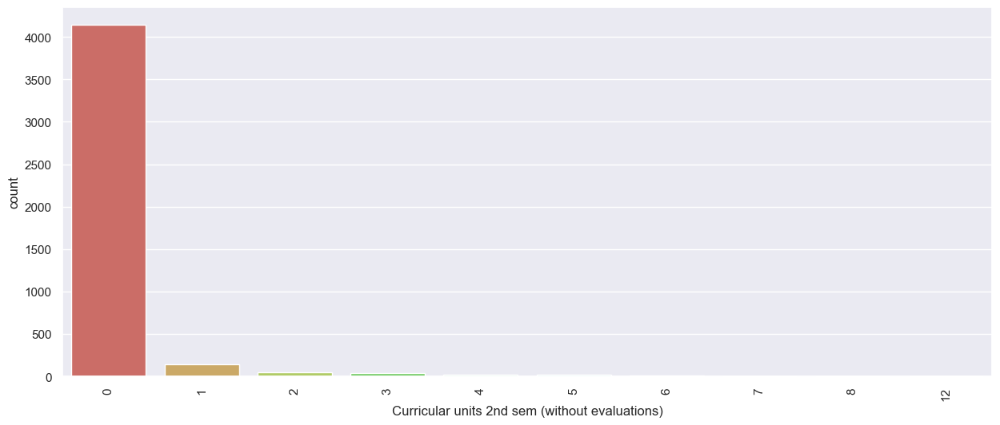

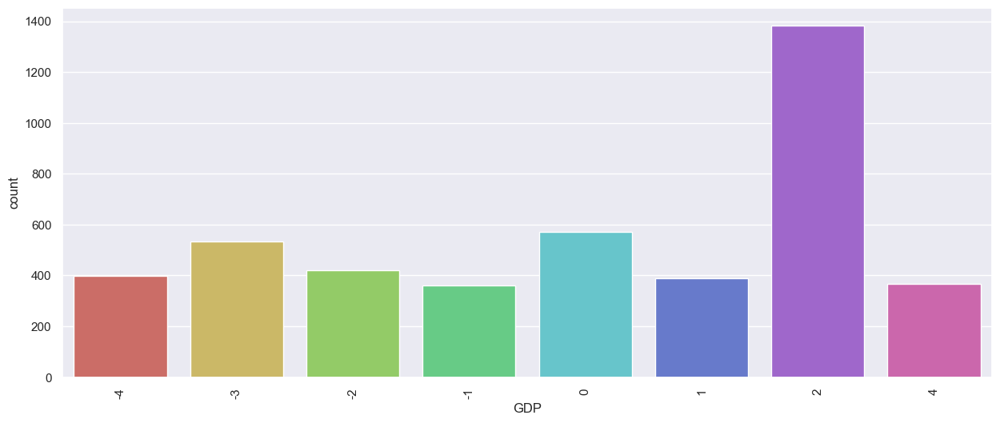

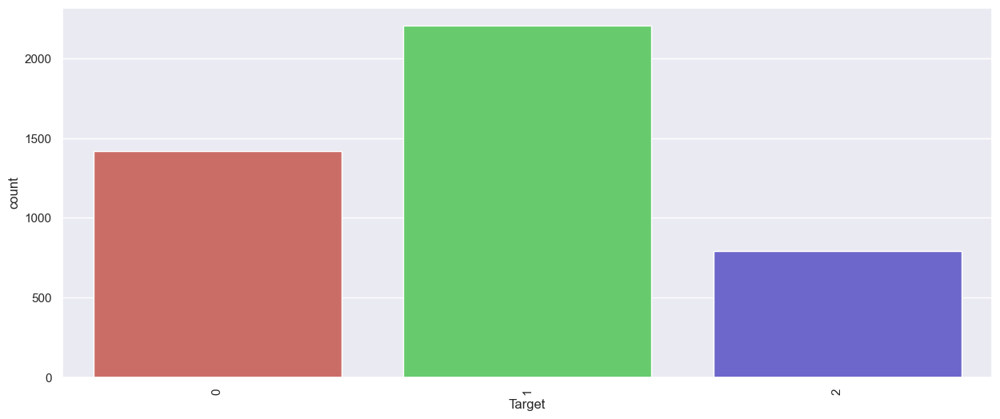

In [55]:
## create count plots for each column in DataFrame using Seaborn's countplot function
## Countplot is an effective way to visualize the distribution of categorical data in each column
for i in df1.columns:
 plt.figure(figsize=(15,6))
 sns.countplot(df1[i], data = df1, palette = 'hls')
 plt.xticks(rotation = 90)
 plt.show()

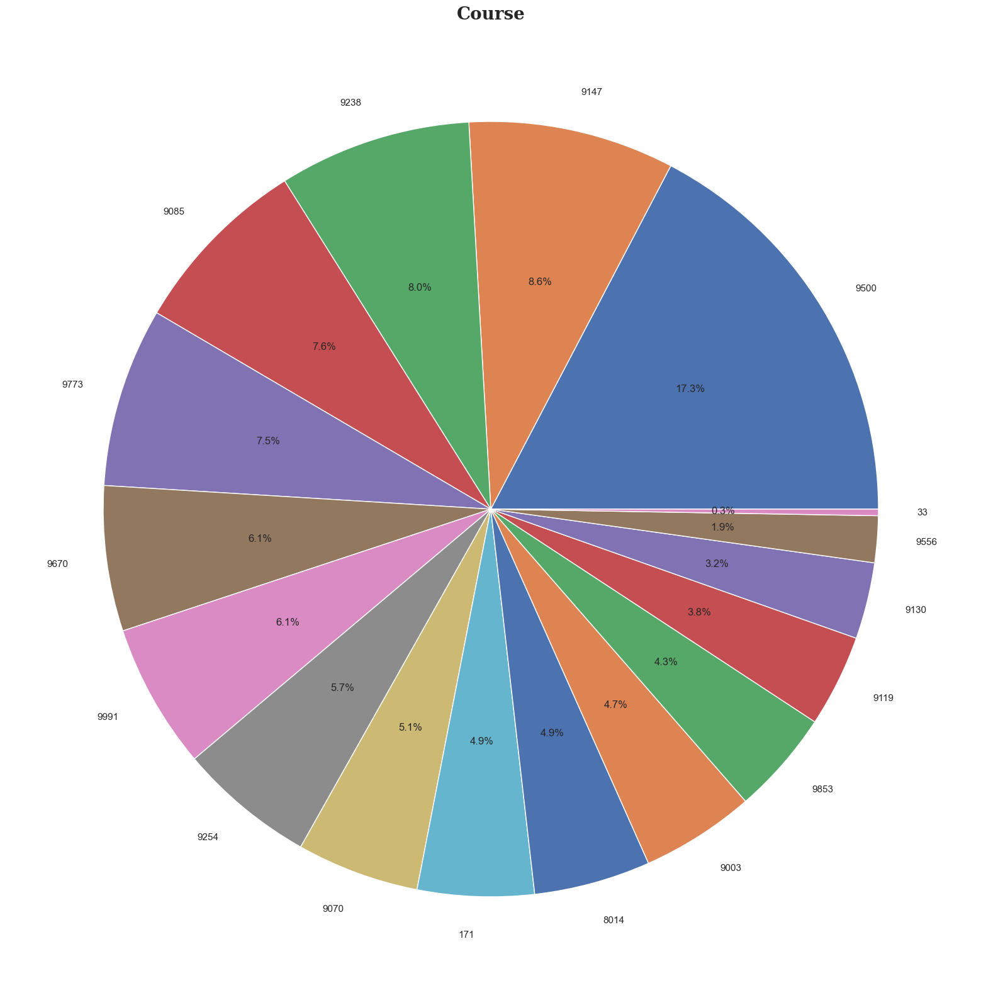

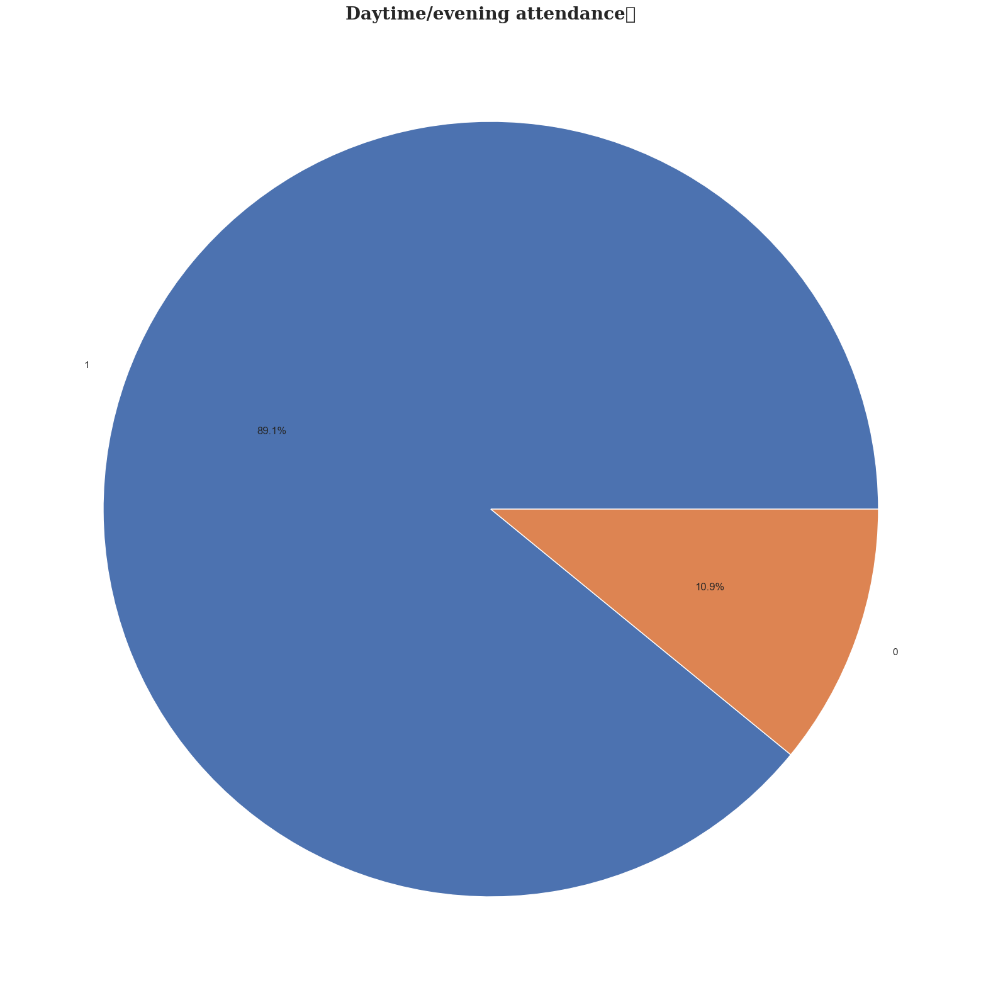

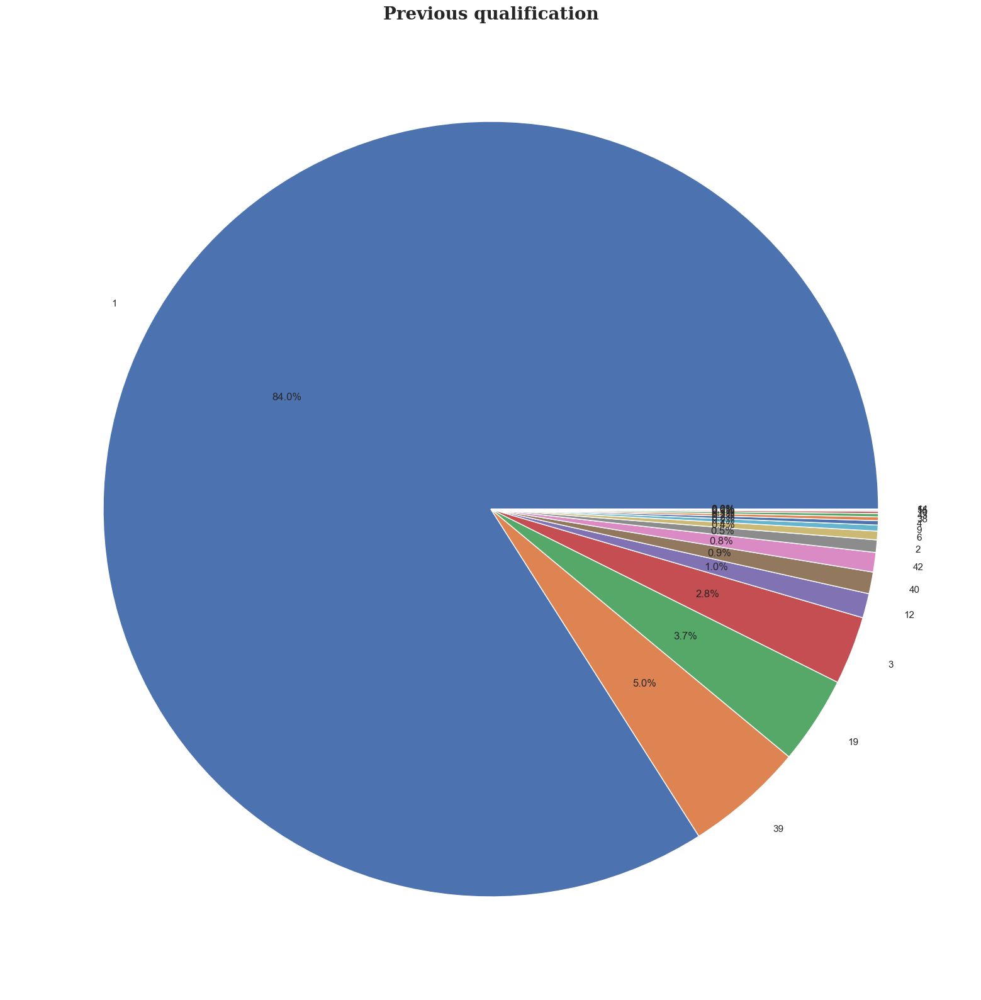

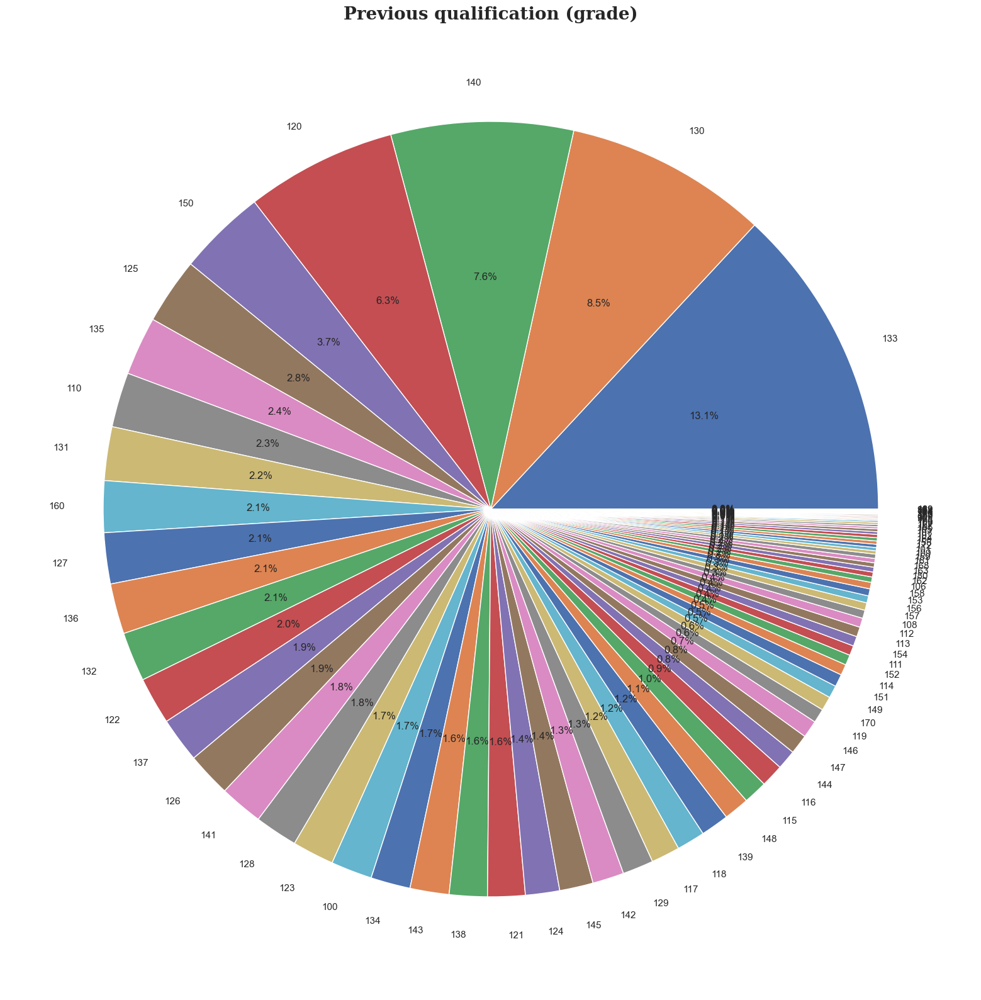

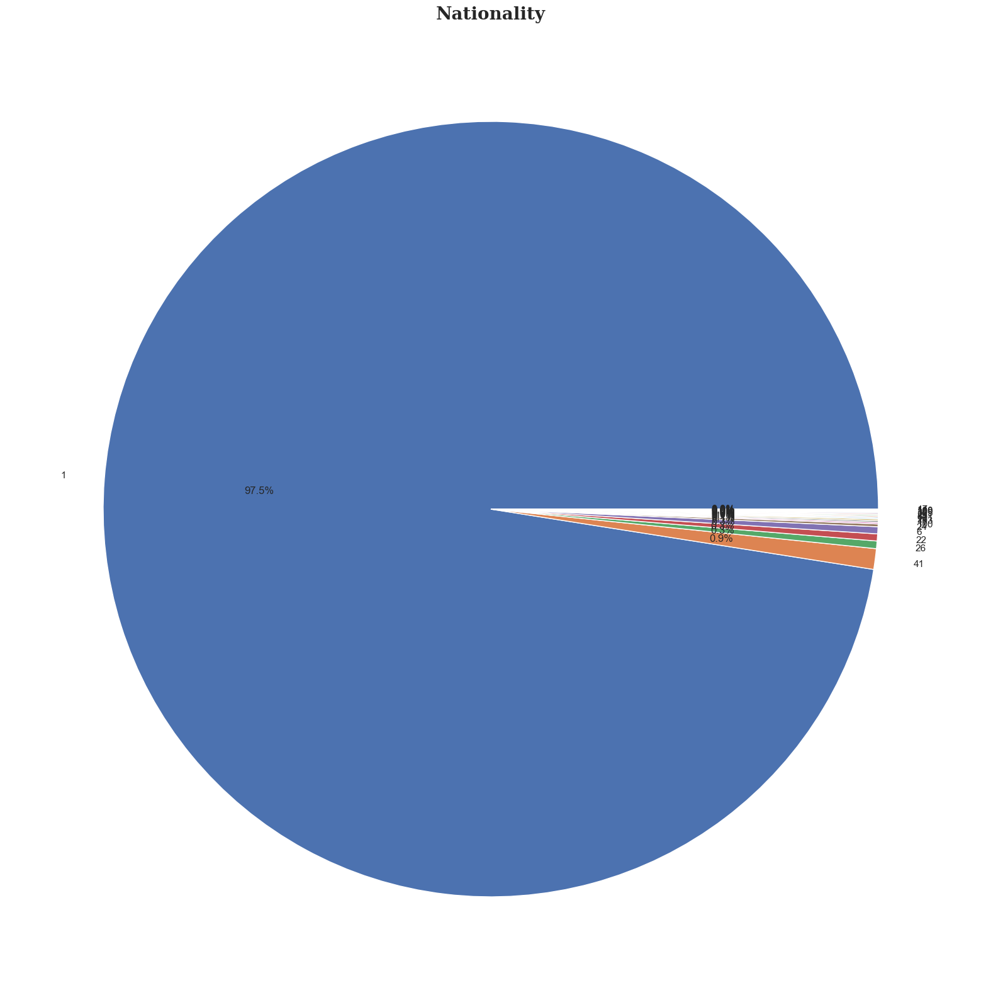

...

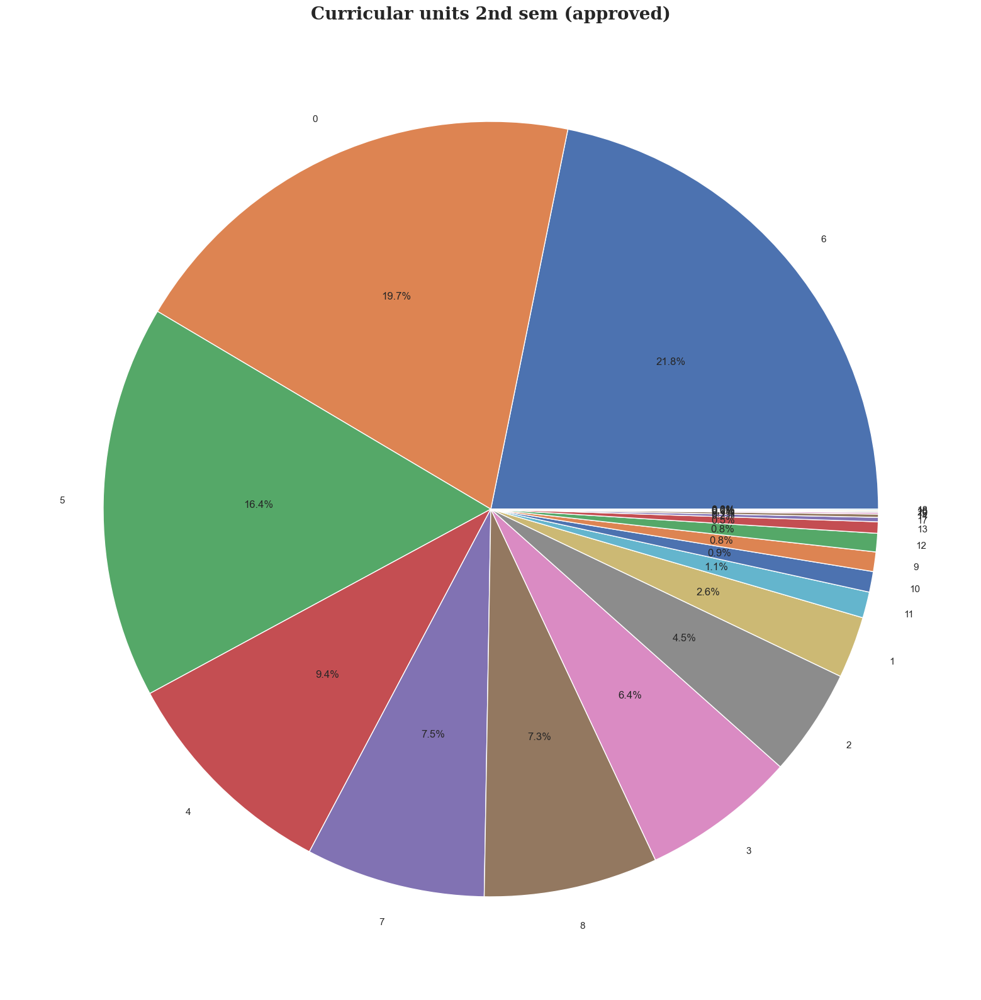

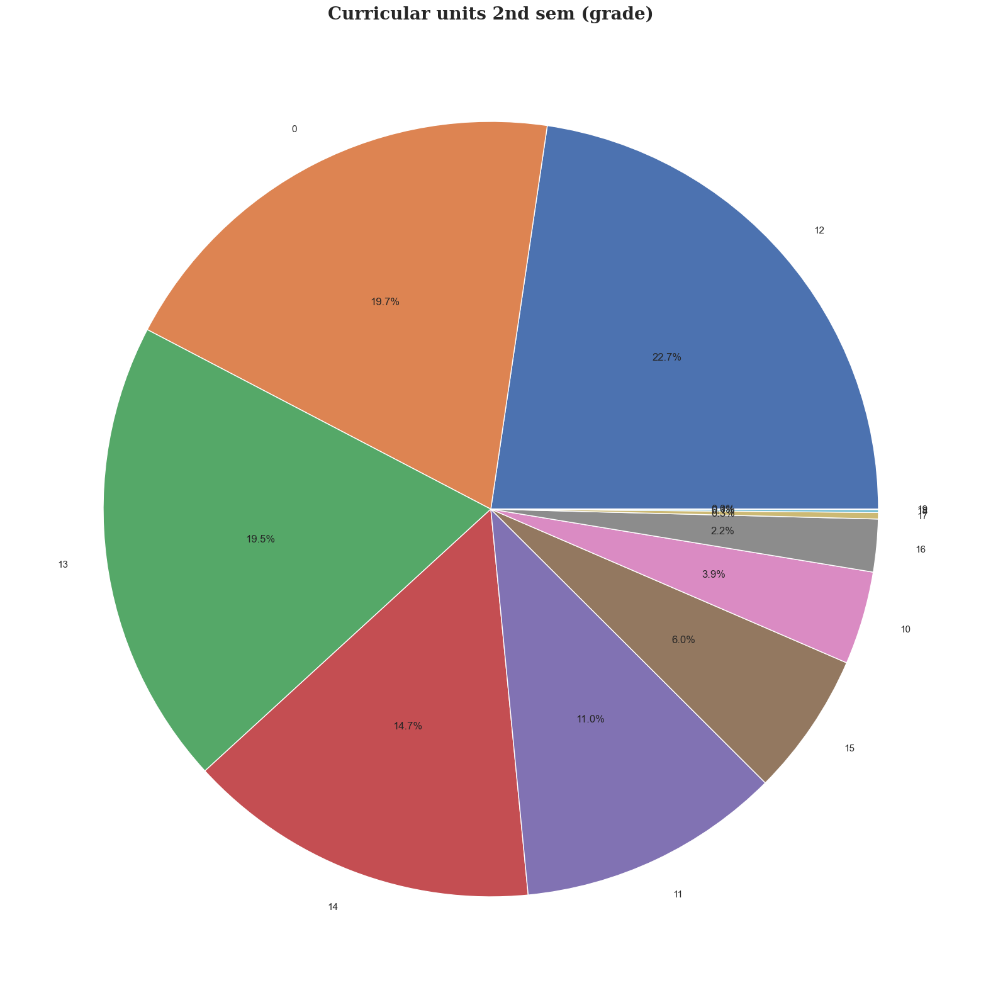

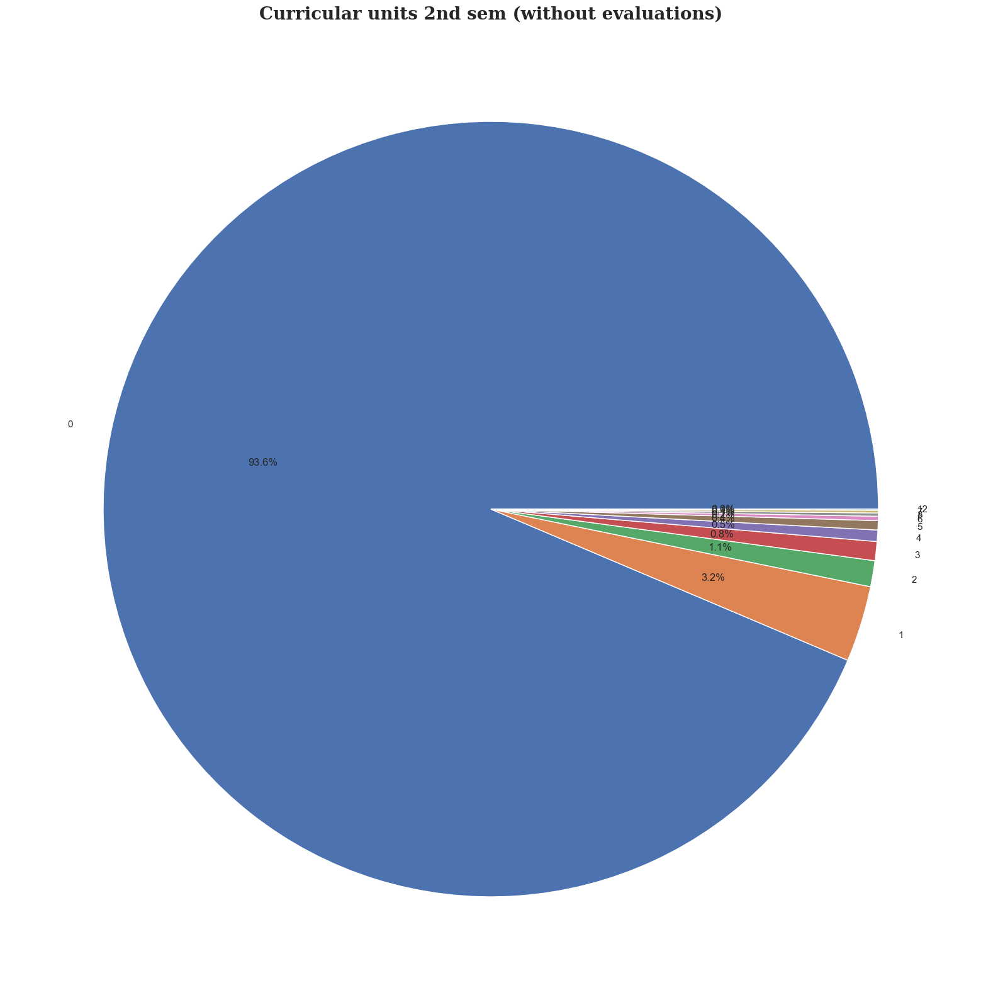

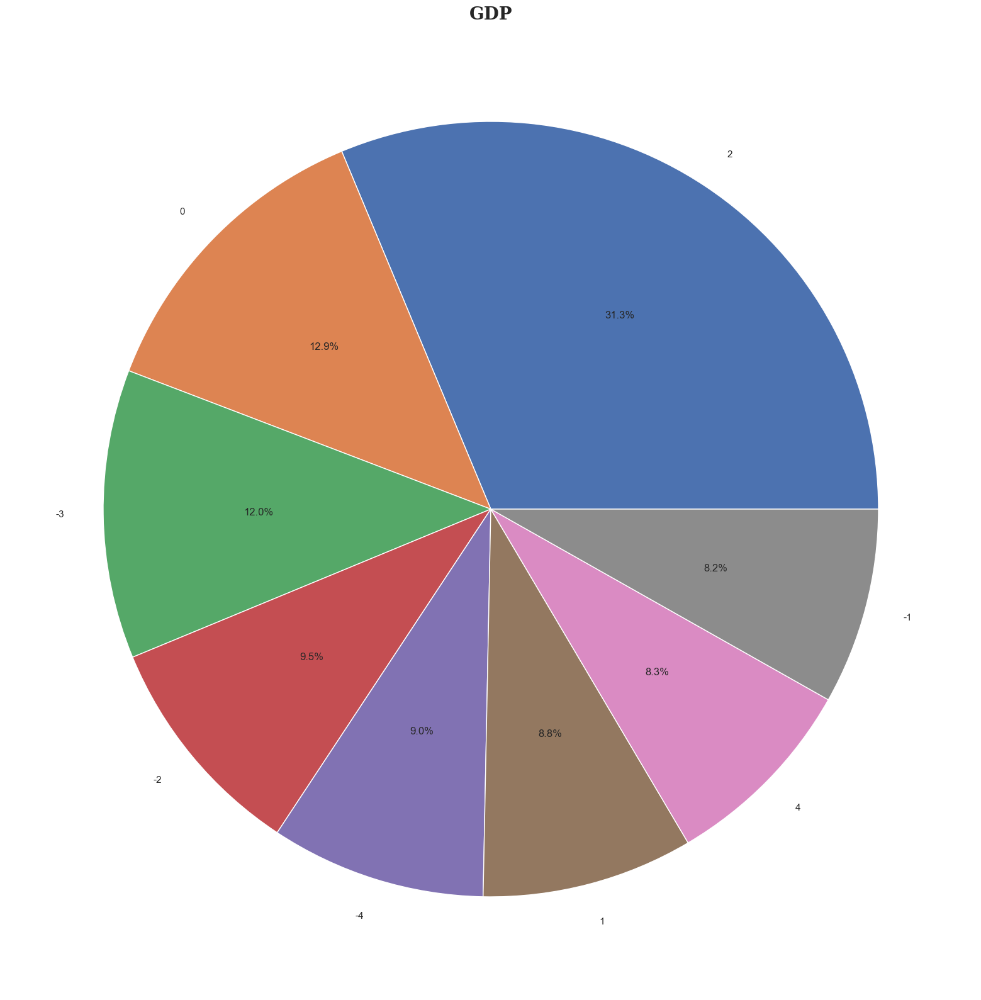

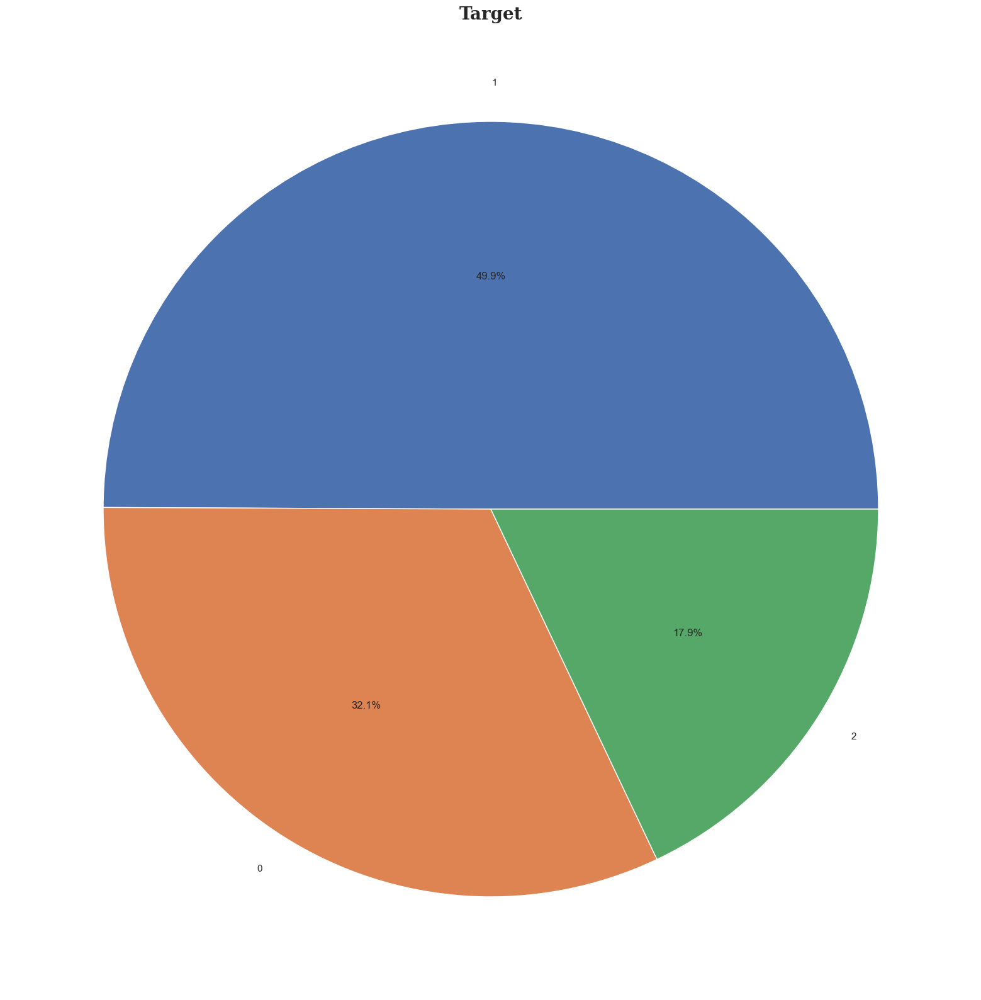

In [56]:
## Creating pie charts for each column in dataset. 
## Pie charts are a good way to represent the distribution of categorical data
for i in df1.columns:
    plt.figure(figsize=(30,20))
    plt.pie(df1[i].value_counts(), labels=df1[i].value_counts().index, autopct='%1.1f%%')
    hfont = {'fontname':'serif', 'weight': 'bold'}
    plt.title(i, size=20, **hfont)
    plt.show()

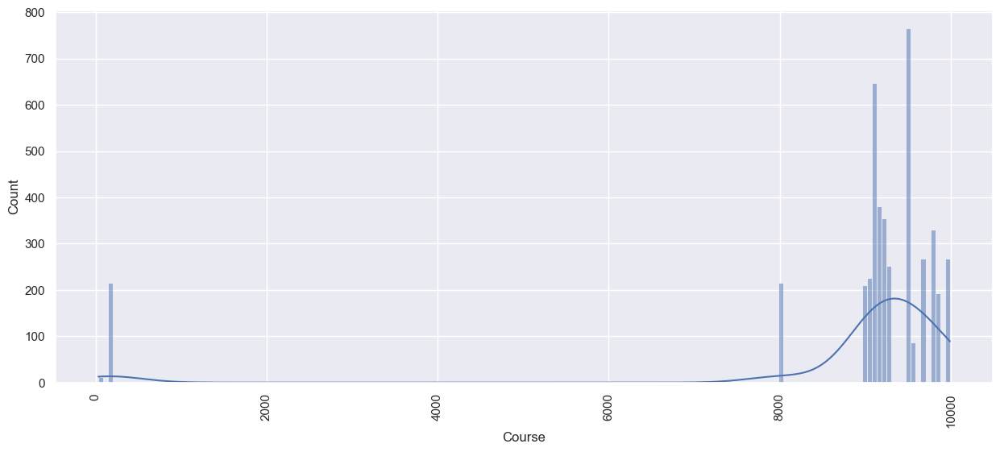

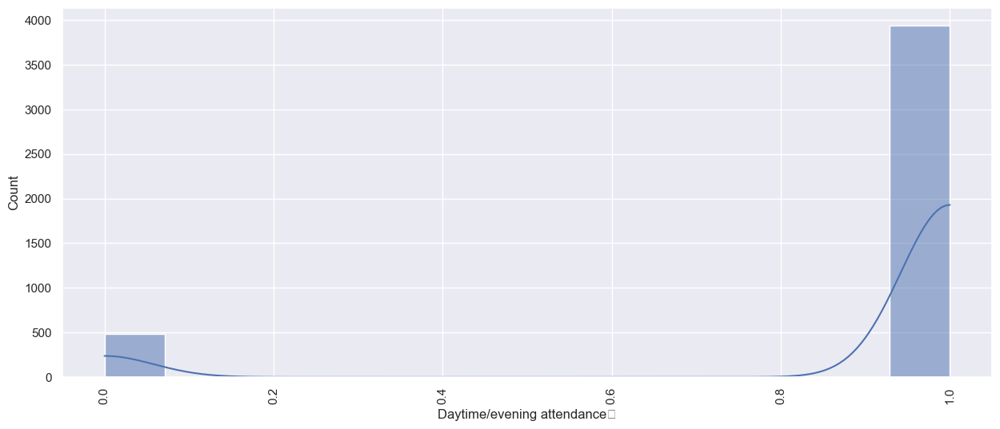

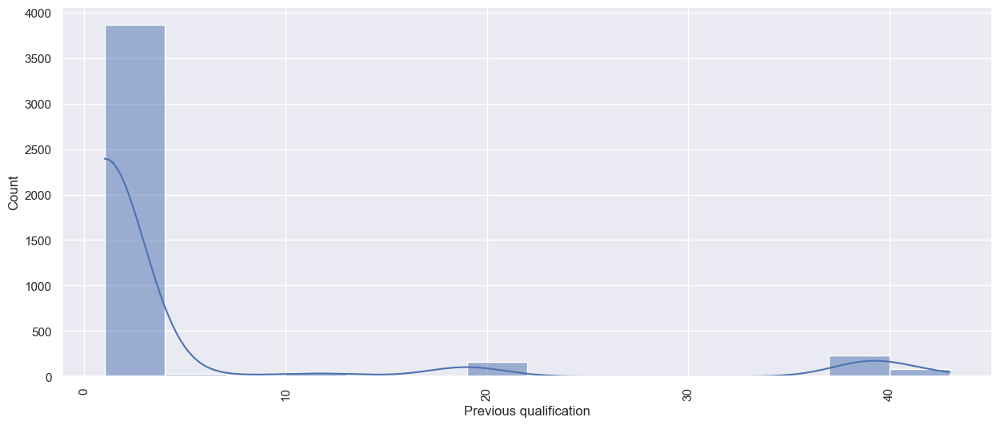

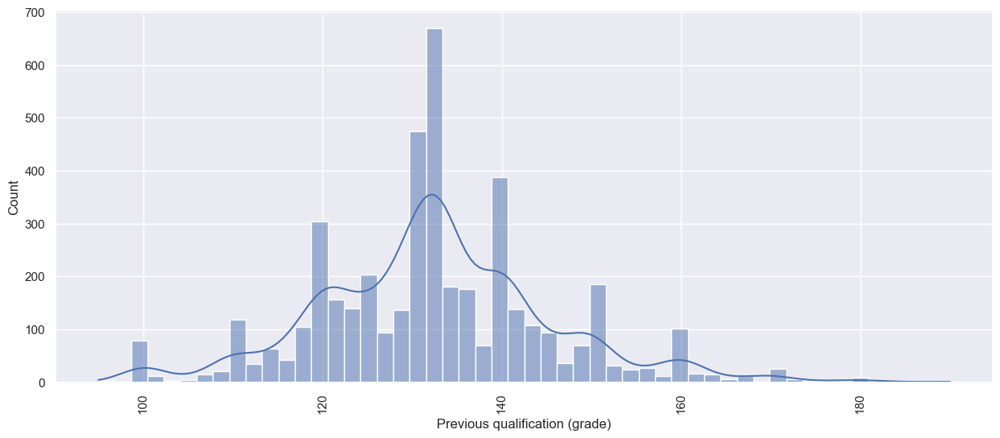

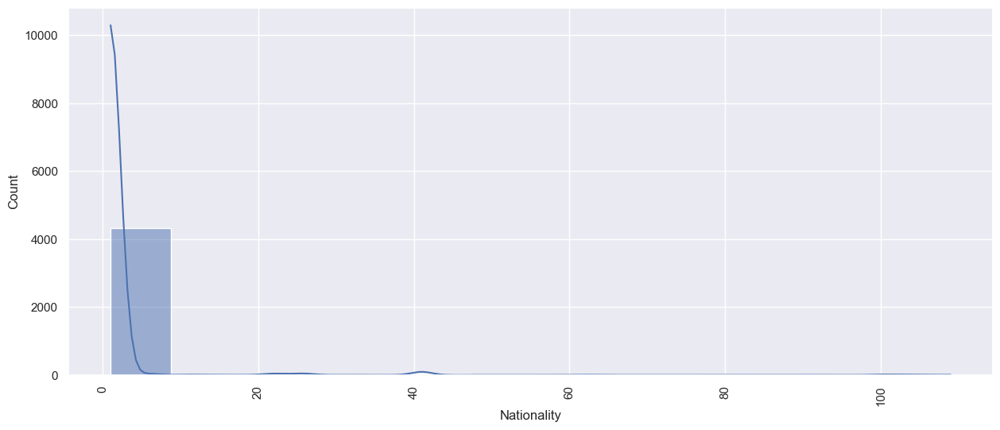

...

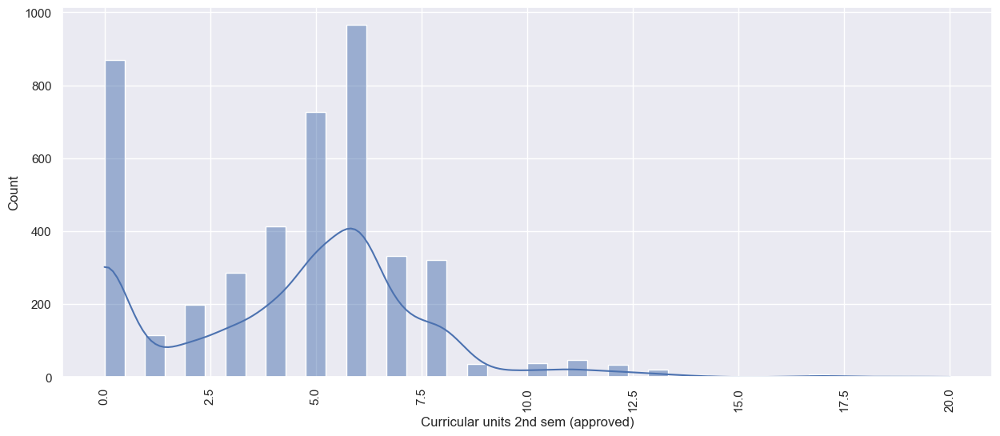

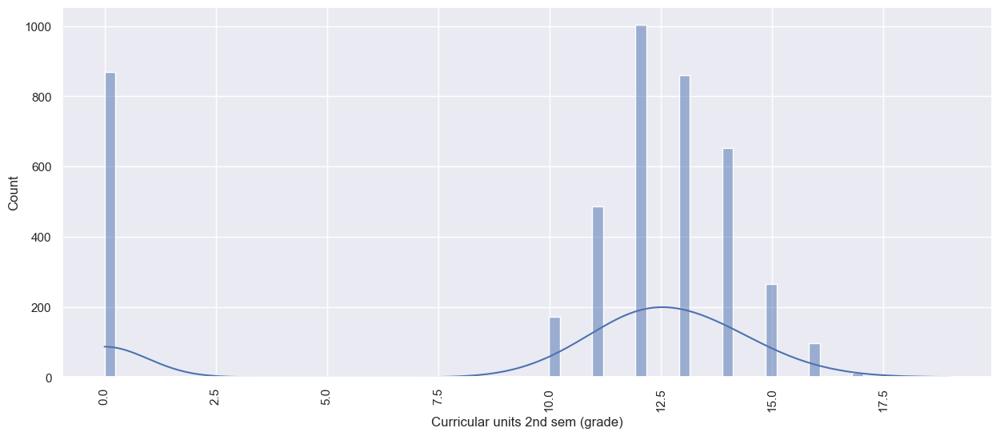

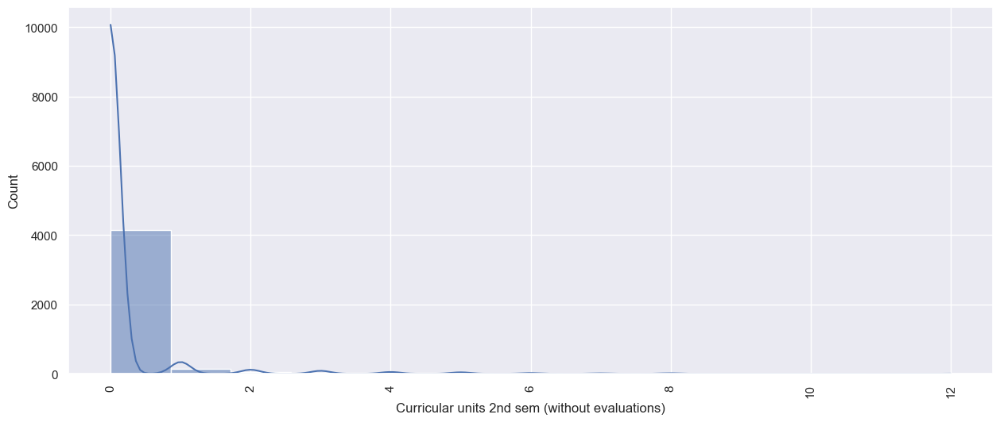

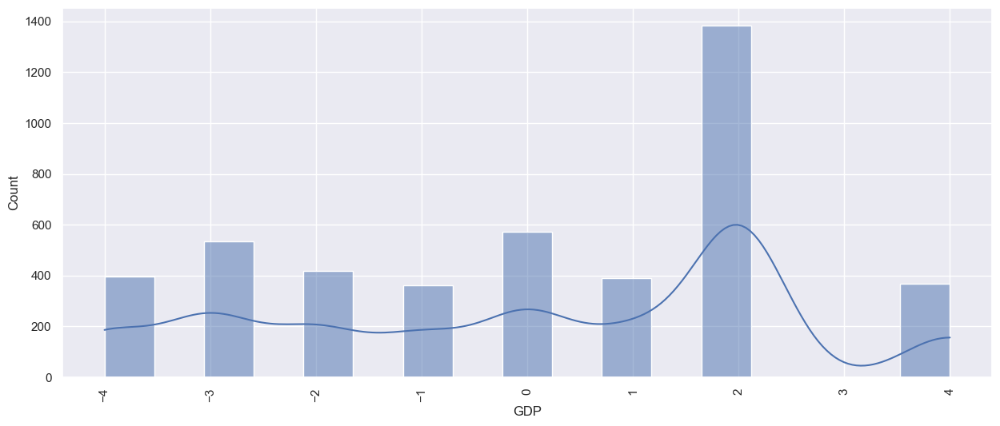

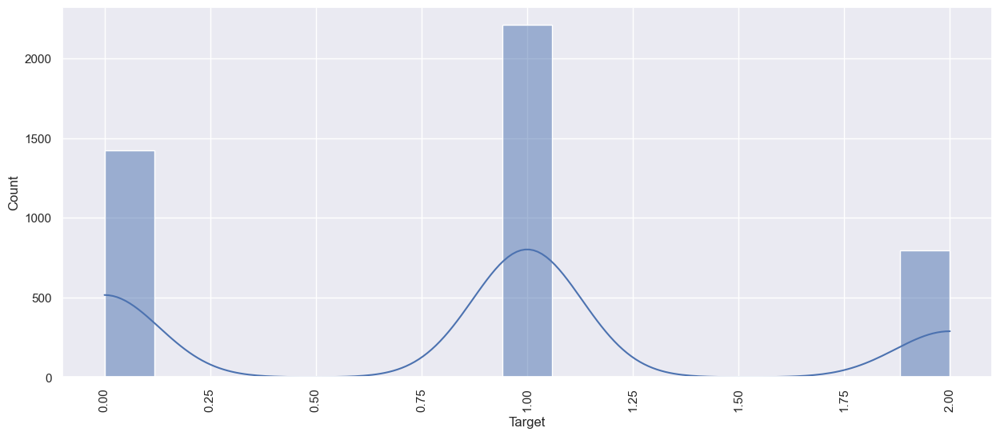

In [57]:
 ## Creating histograms for each column in dataset using sns.histplot.
## Histograms are a great way to visualize the distribution of numerical data.
for i in df1.columns:
    plt.figure(figsize=(15,6))
    sns.histplot(df1[i], kde = True, palette = 'hls')
    plt.xticks(rotation = 90)
    plt.show()

Index(['Course', 'Daytime/evening attendance\t', 'Previous qualification',
       'Previous qualification (grade)', 'Nationality',
       'Mother's qualification', 'Father's qualification',
       'Mother's occupation', 'Father's occupation', 'Admission grade',
       'Displaced', 'Educational special needs', 'Tuition fees up to date',
       'Gender', 'Scholarship holder', 'Age at enrollment', 'International',
       'Curricular units 1st sem (credited)',
       'Curricular units 1st sem (enrolled)',
       'Curricular units 1st sem (evaluations)',
       'Curricular units 1st sem (approved)',
       'Curricular units 1st sem (grade)',
       'Curricular units 1st sem (without evaluations)',
       'Curricular units 2nd sem (credited)',
       'Curricular units 2nd sem (enrolled)',
       'Curricular units 2nd sem (evaluations)',
       'Curricular units 2nd sem (approved)',
       'Curricular units 2nd sem (grade)',
       'Curricular units 2nd sem (without evaluations)', 'GDP'],
   

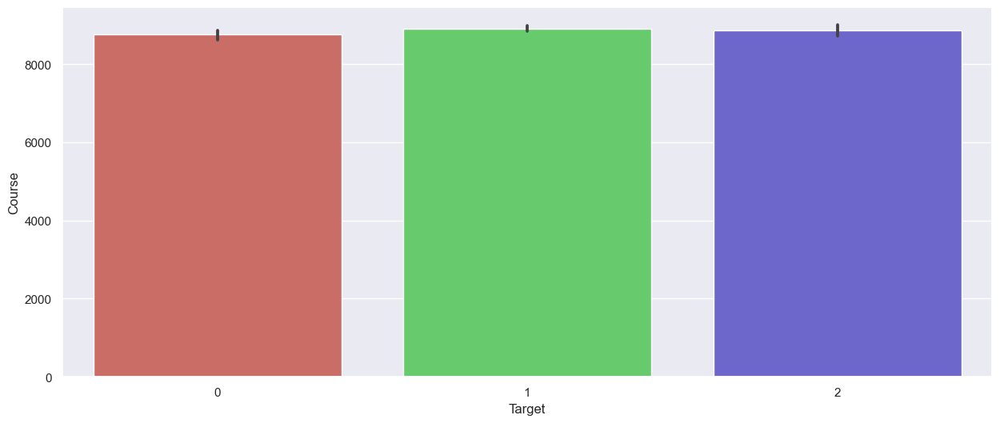

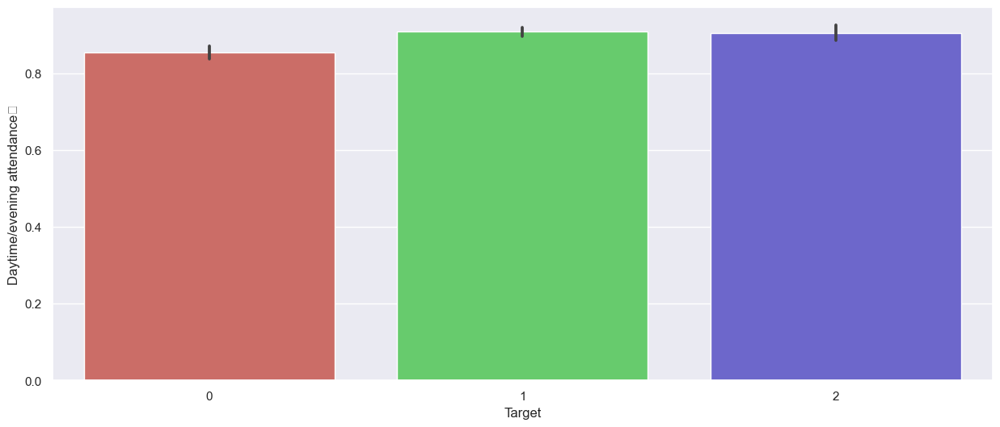

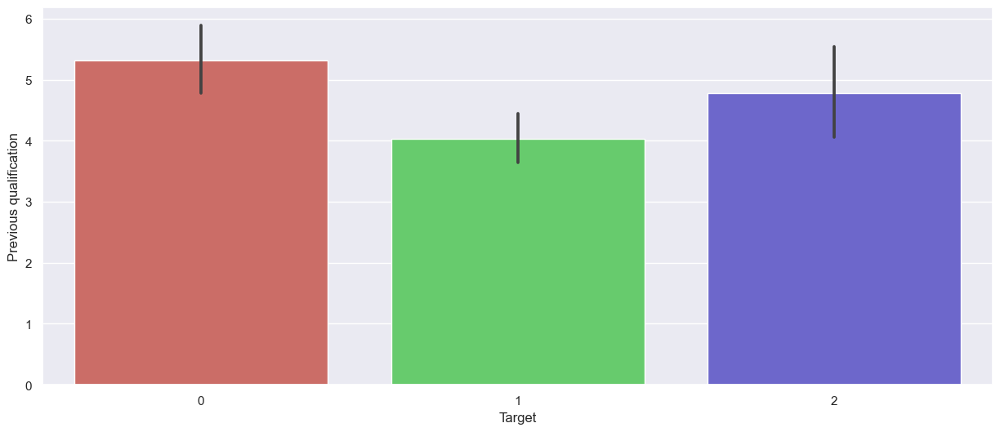

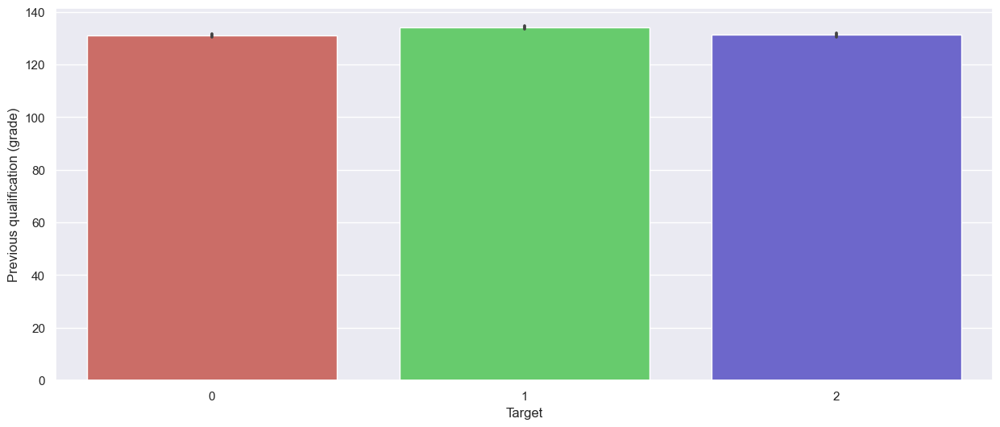

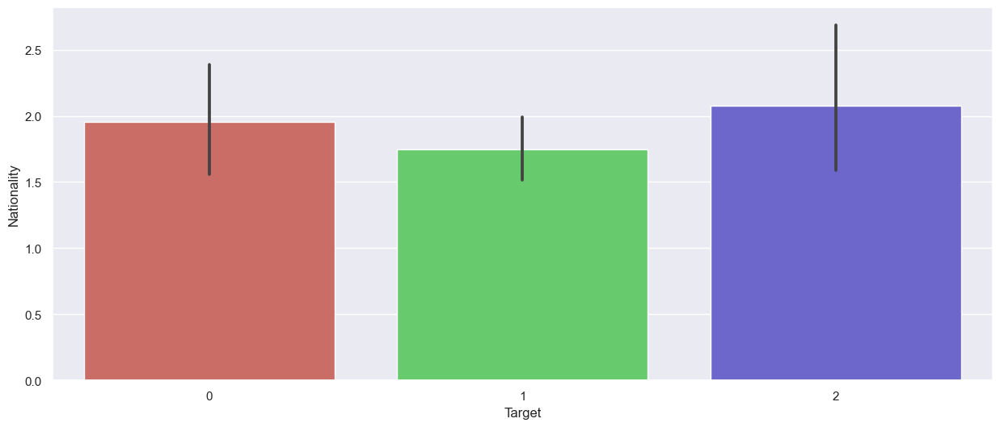

...

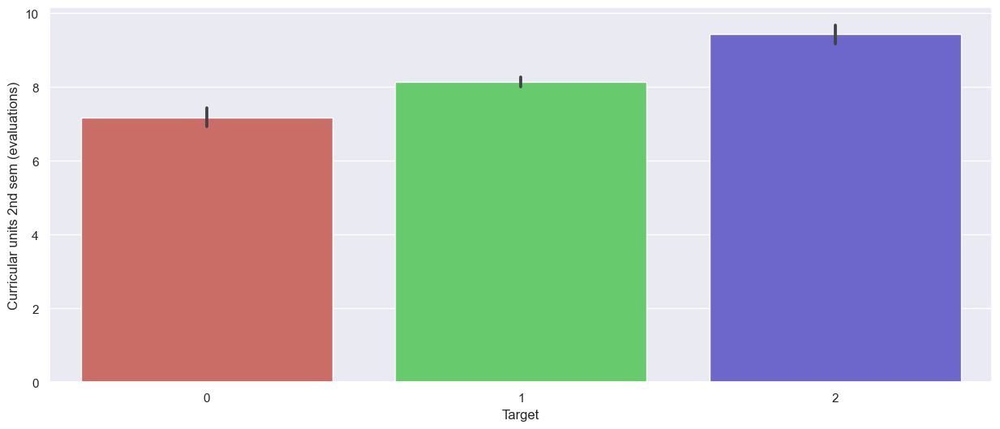

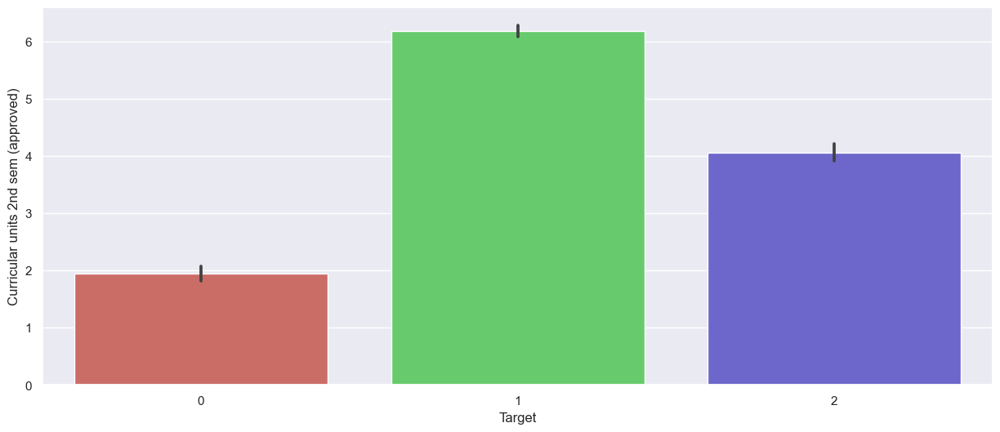

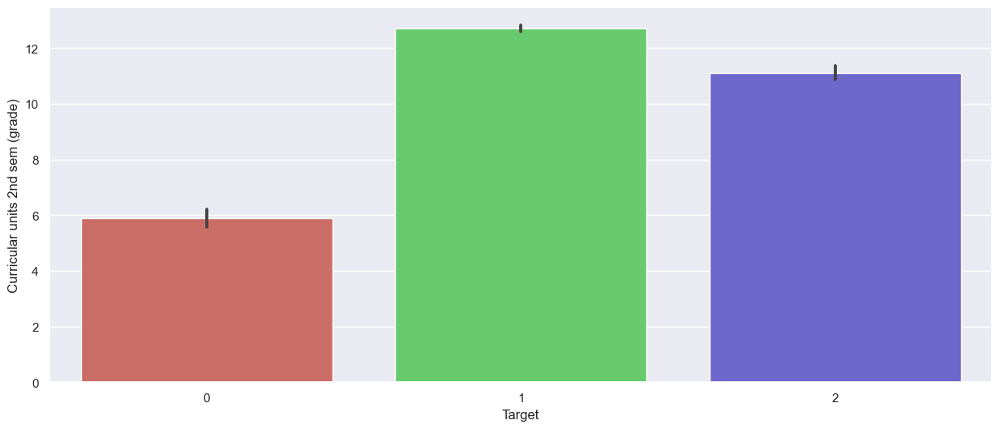

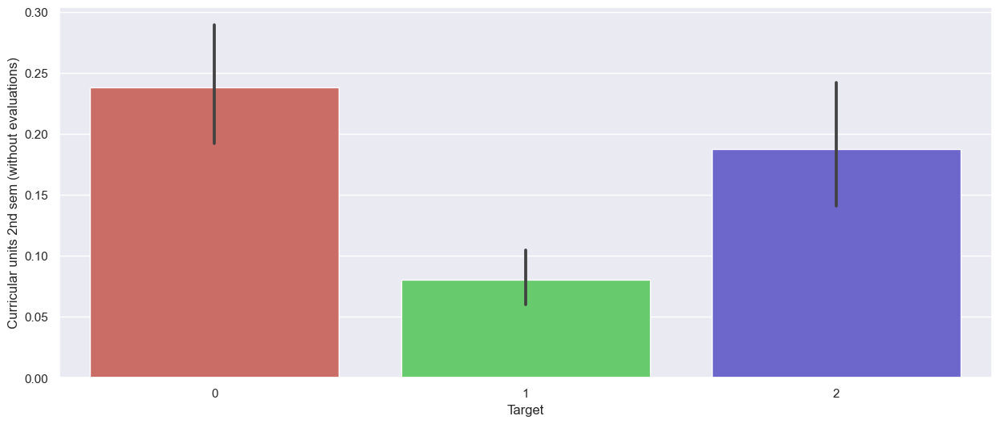

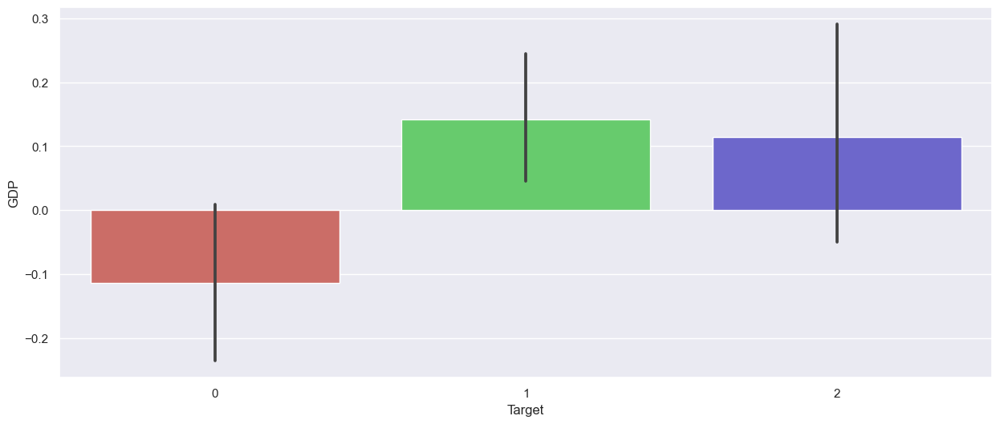

In [58]:
# Creating bar plots to visualize the relationship between the target variable (Target) and other features in dataset. 
# This is a good approach for understanding how different features might be related to the target variable.

df2 = df1.iloc[:, :-1] 
# Print column names for inspection
print(df2.columns)
for i in df2.columns:
  plt.figure(figsize=(15,6))
  sns.barplot(x = df1['Target'], y = df2[i], data = df1, palette = 'hls')
  plt.show()



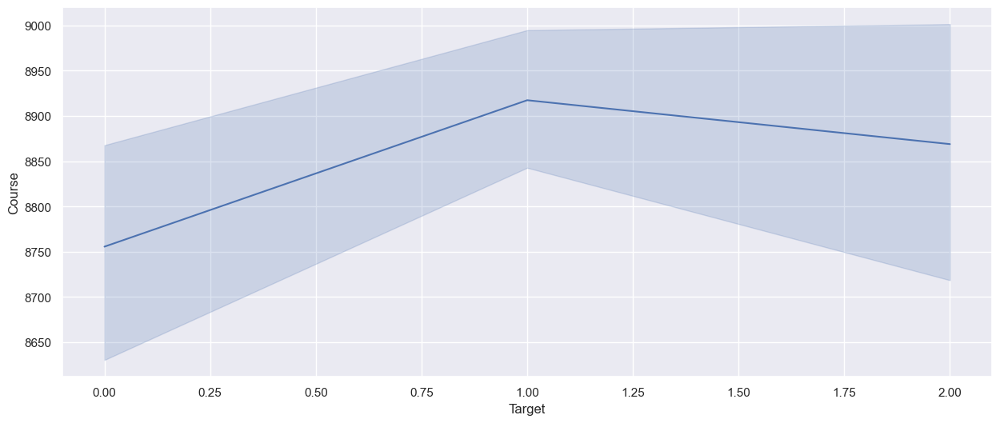

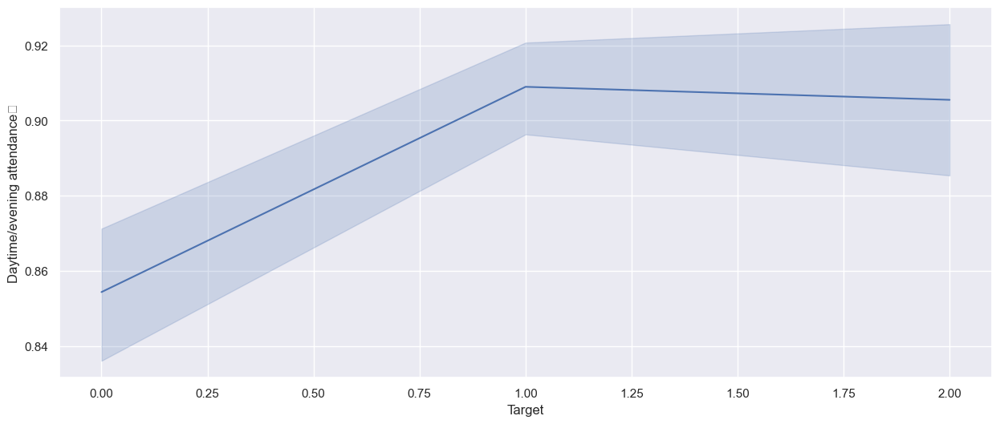

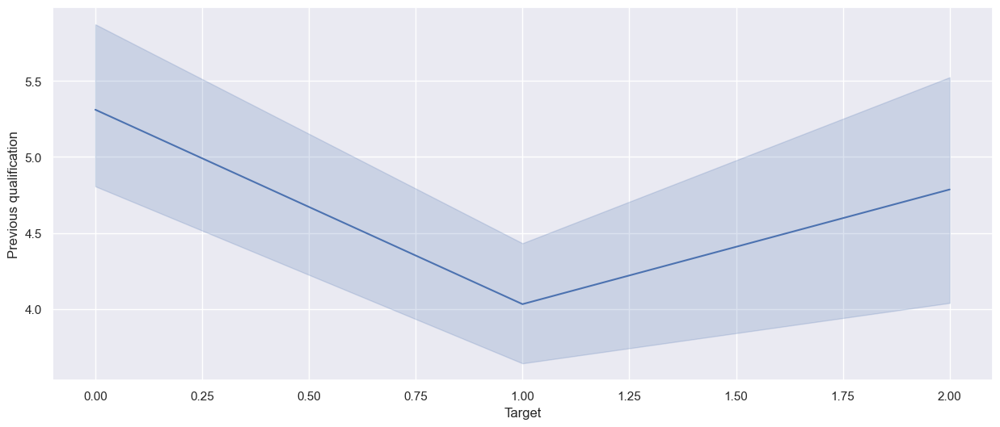

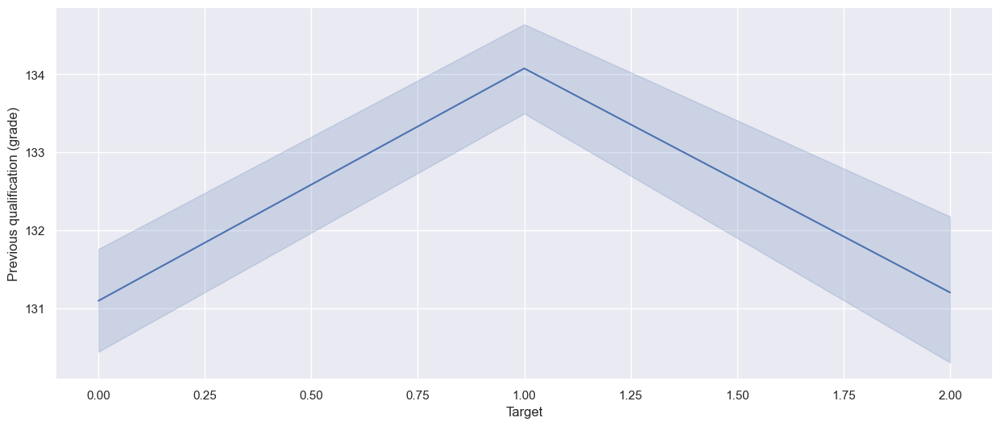

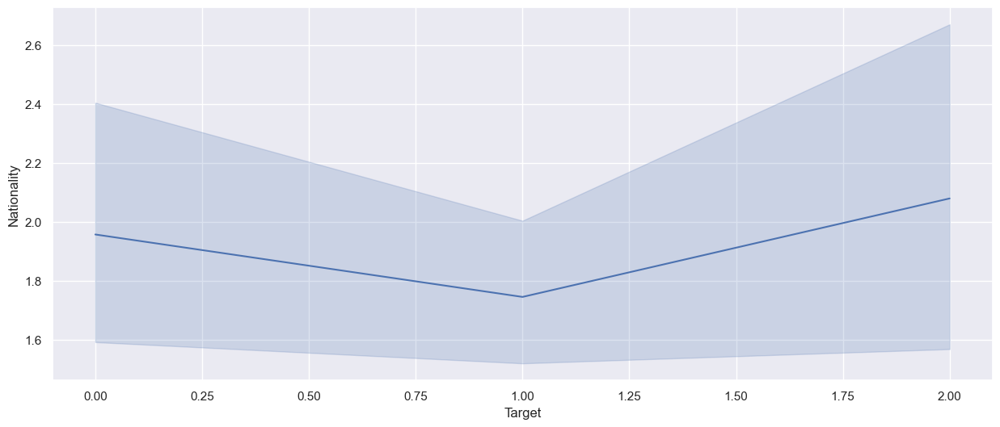

...

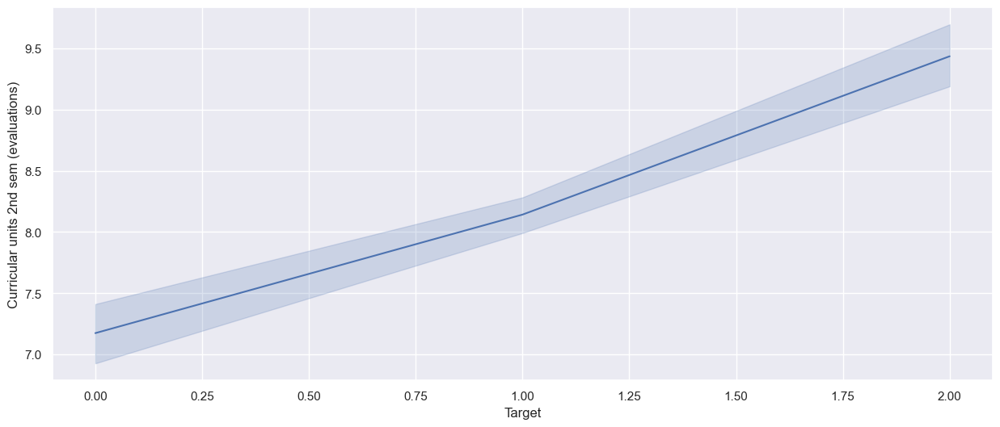

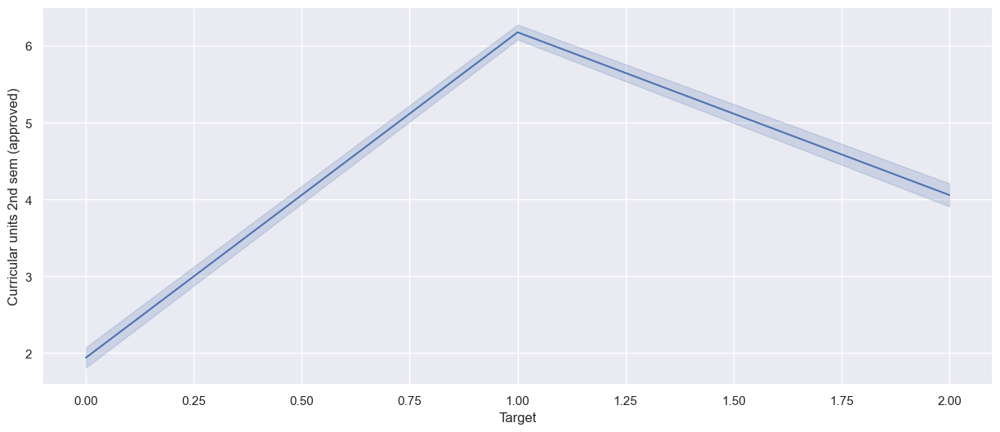

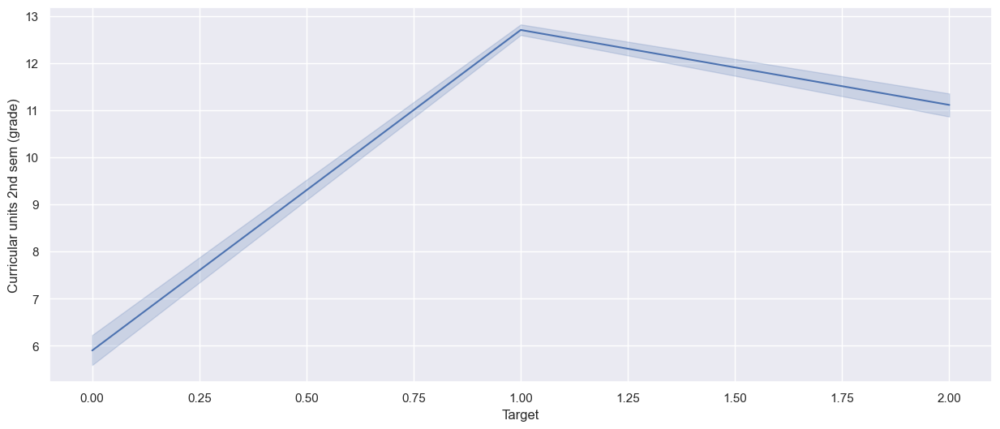

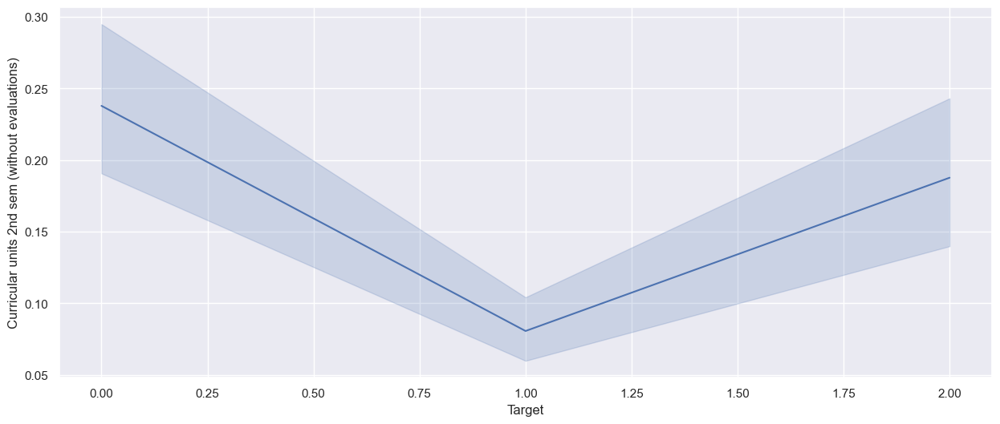

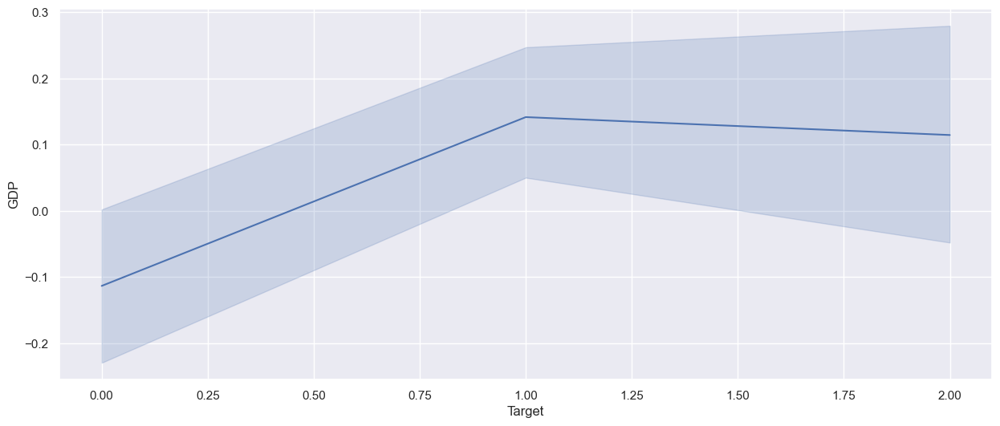

In [59]:
 # Using line plots to visualize the relationship between the target variable (Target) and other features in dataset. 
# Line plots are typically used to show the trend or pattern of a variable over a continuous axis.
for i in df2.columns:
  plt.figure(figsize=(15,6))
  sns.lineplot(x = df1['Target'], y = df2[i], data = df1, palette = 'hls')
  plt.show()

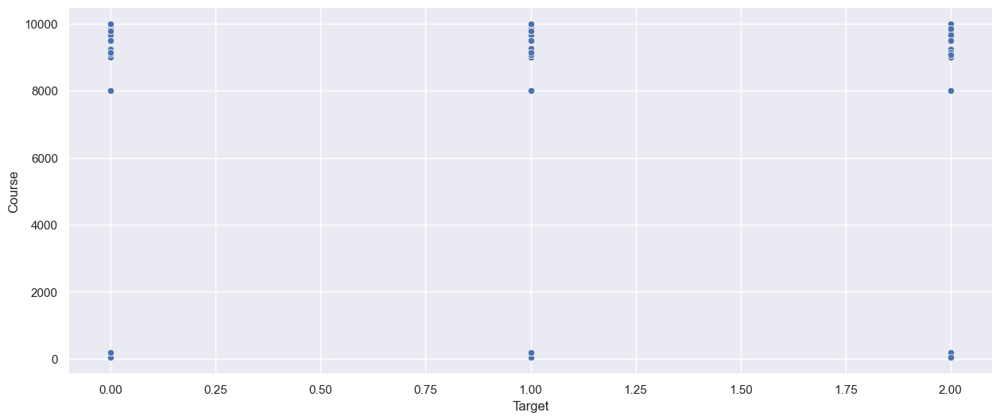

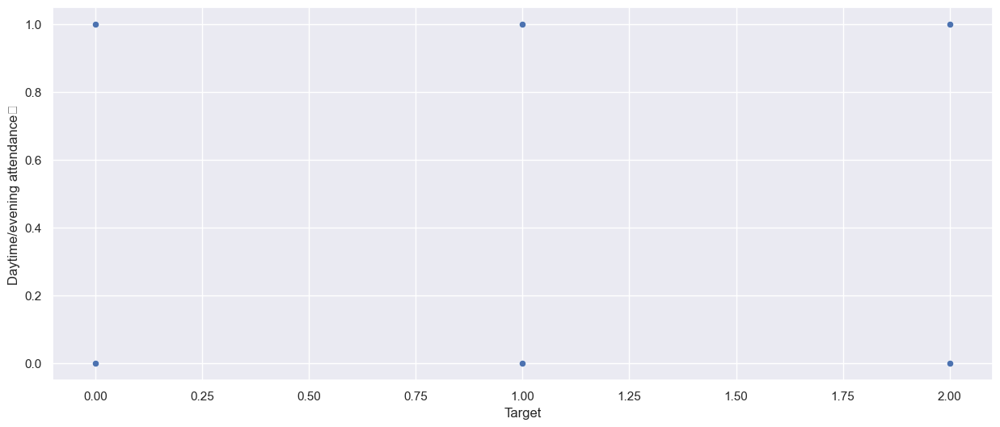

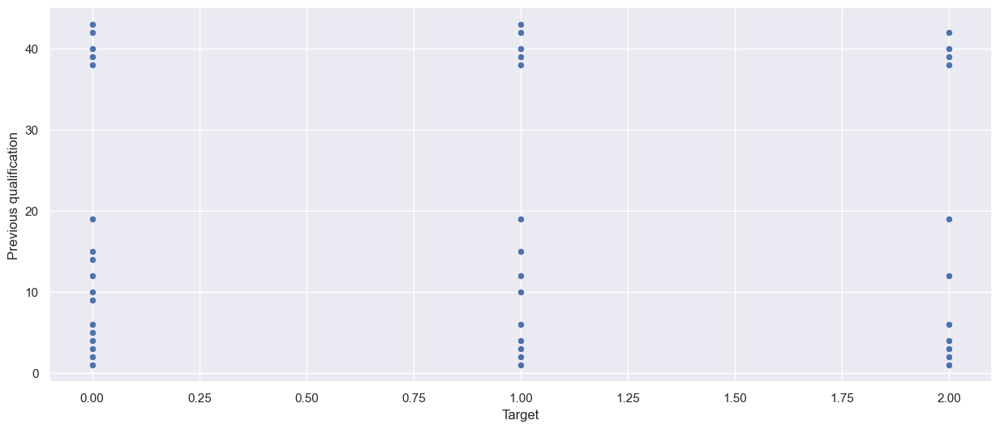

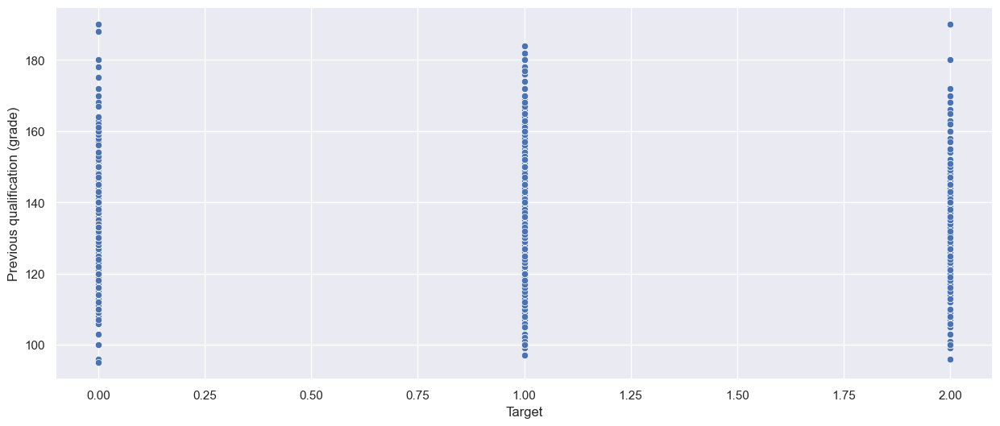

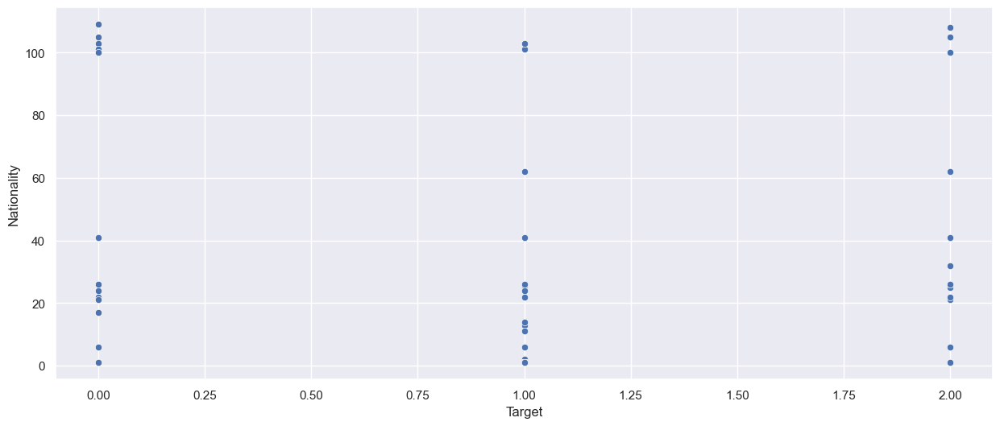

...

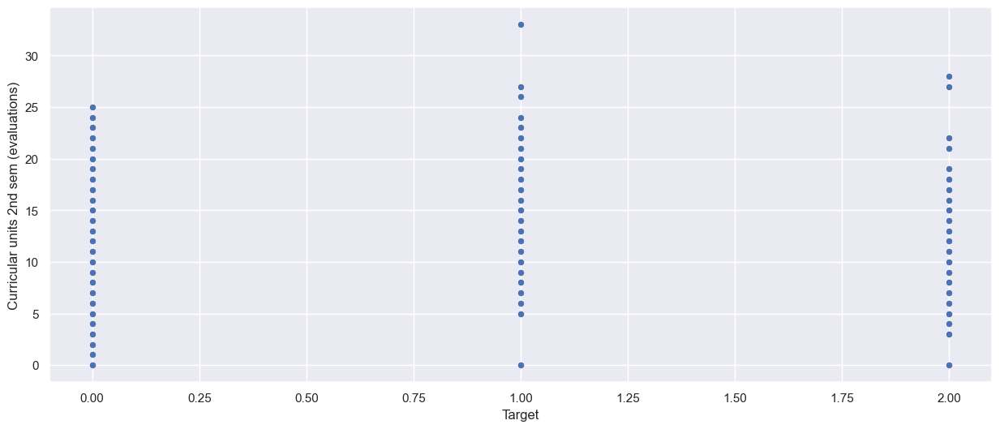

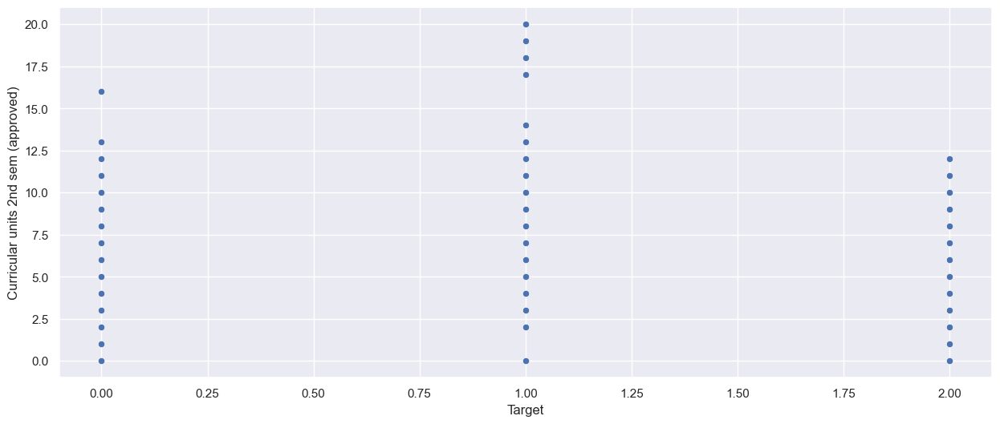

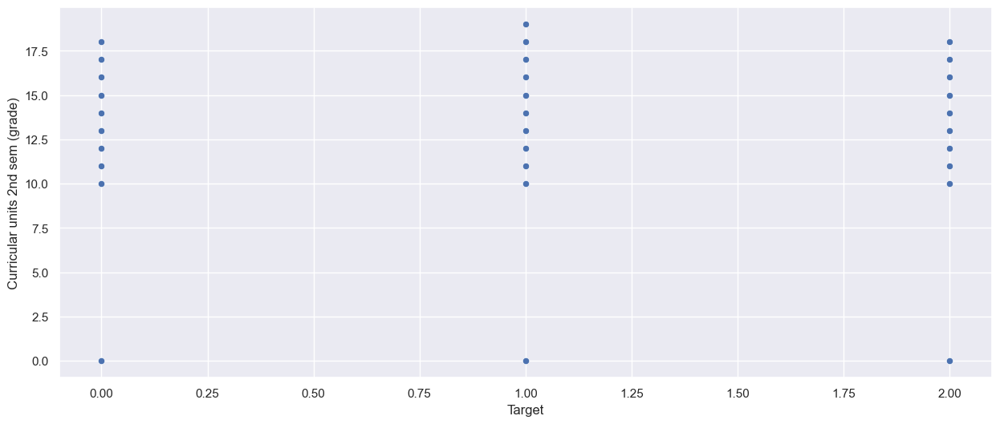

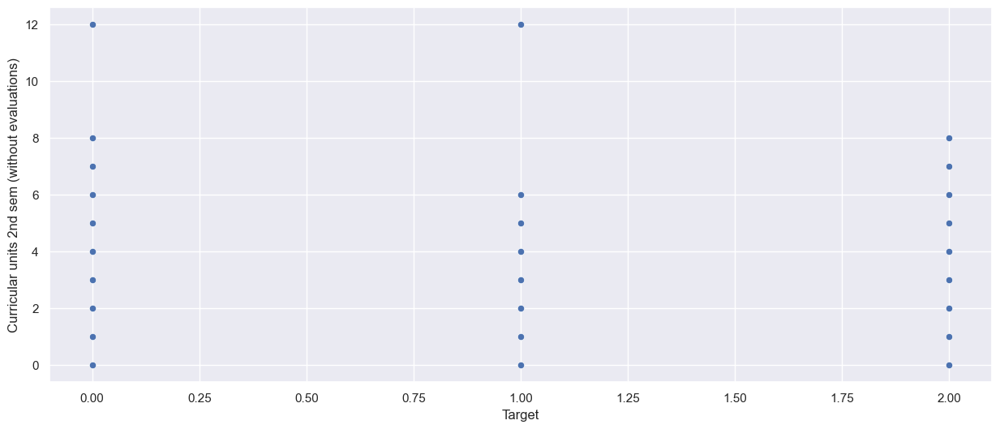

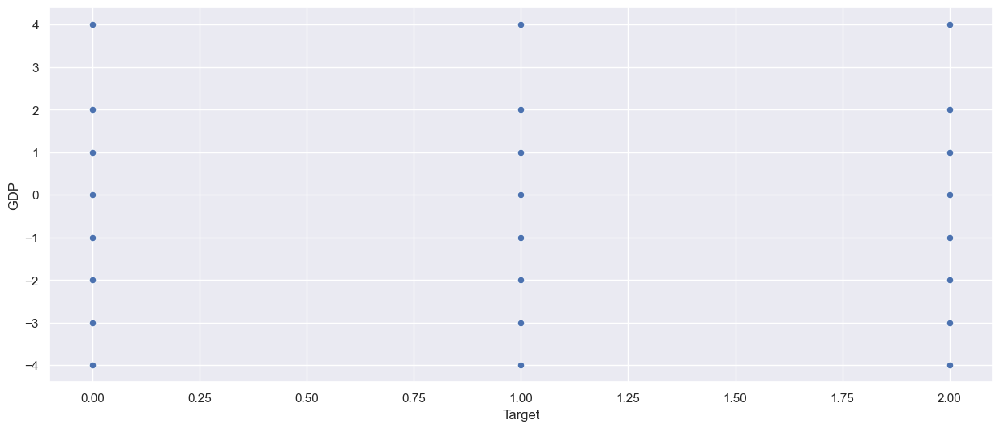

In [60]:
# using scatter plots to visualize the relationship between the target variable (Target) and other features in dataset.
# Scatter plots are useful for visualizing the distribution and relationship between two continuous variables.
for i in df2.columns:
  plt.figure(figsize=(15,6))
  sns.scatterplot(x = df1['Target'], y = df2[i], data = df1, palette = 'hls')
  plt.show()


<Figure size 1500x600 with 0 Axes>

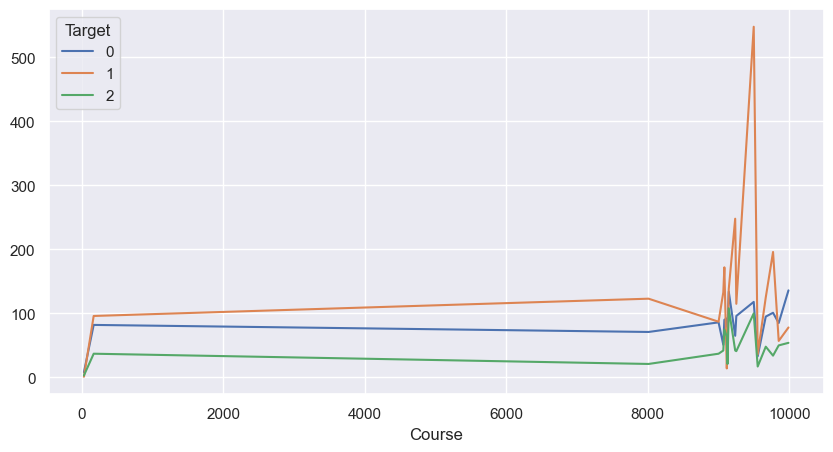

<Figure size 1500x600 with 0 Axes>

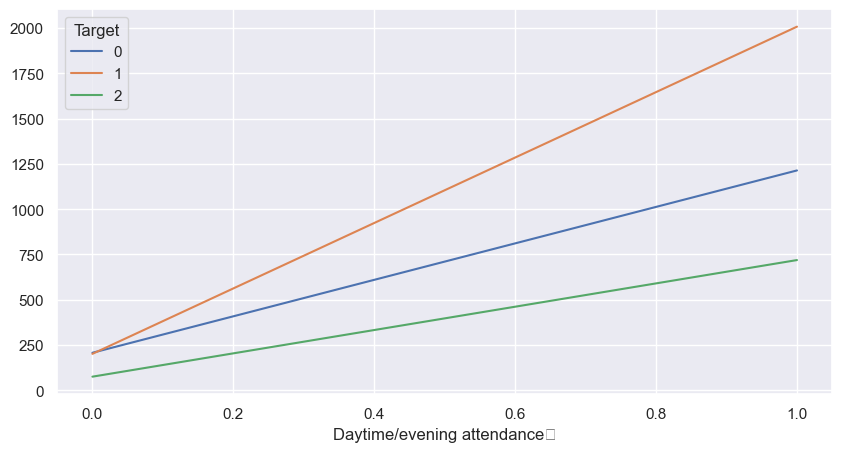

<Figure size 1500x600 with 0 Axes>

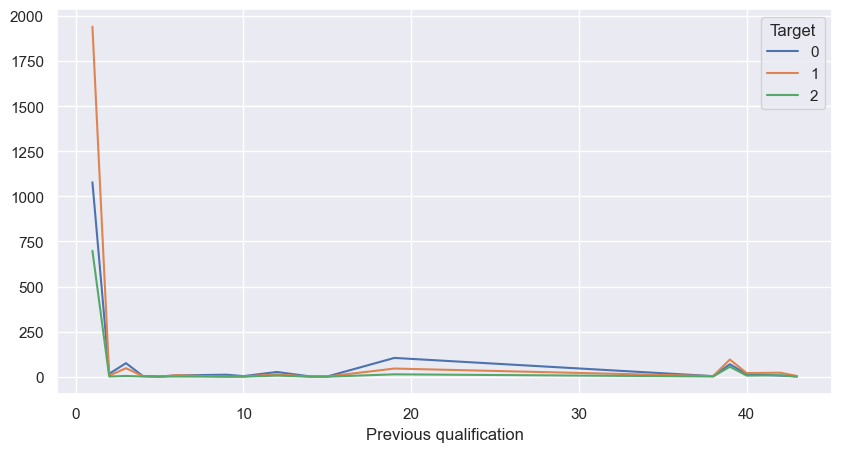

<Figure size 1500x600 with 0 Axes>

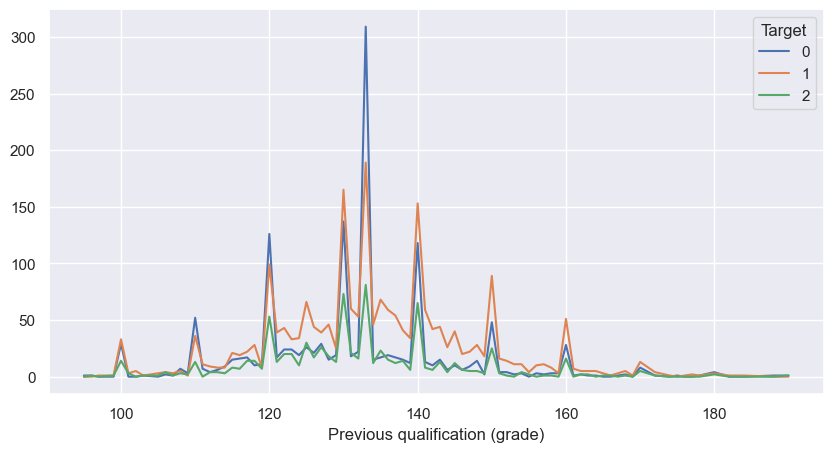

<Figure size 1500x600 with 0 Axes>

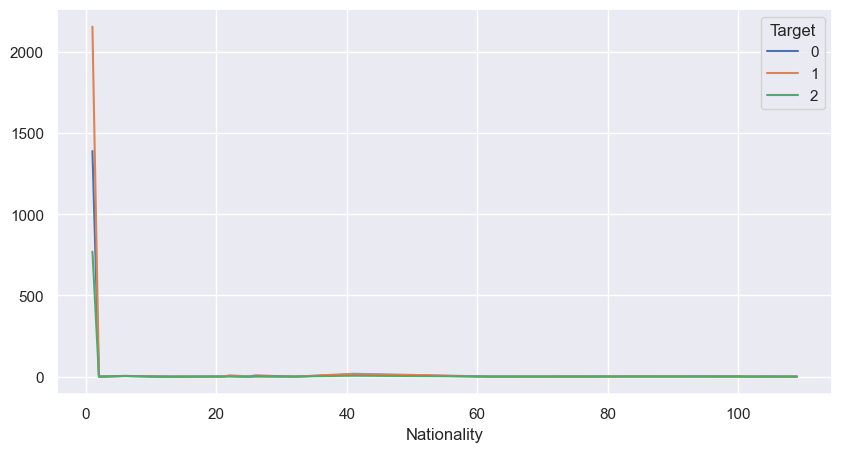

<Figure size 1500x600 with 0 Axes>

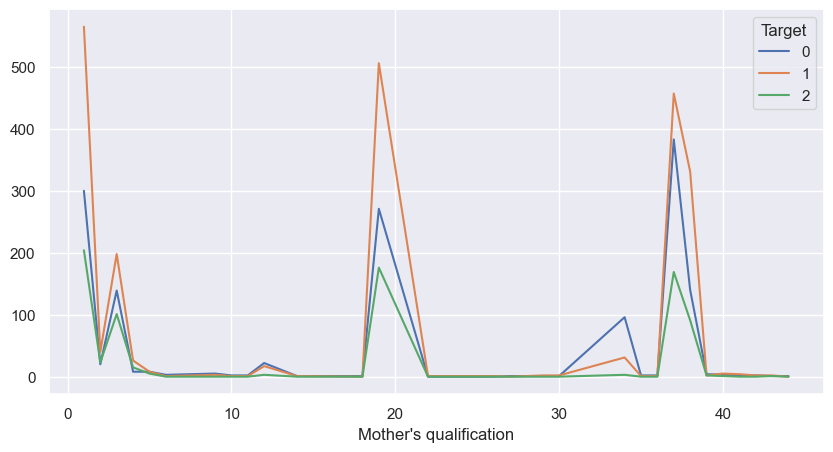

<Figure size 1500x600 with 0 Axes>

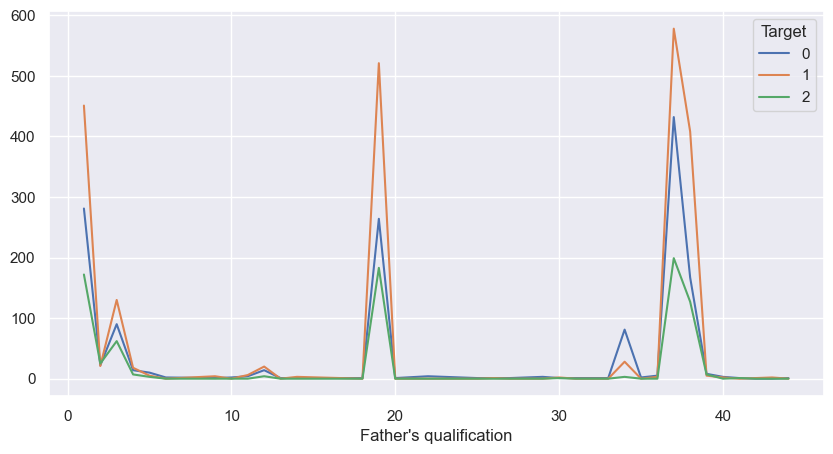

<Figure size 1500x600 with 0 Axes>

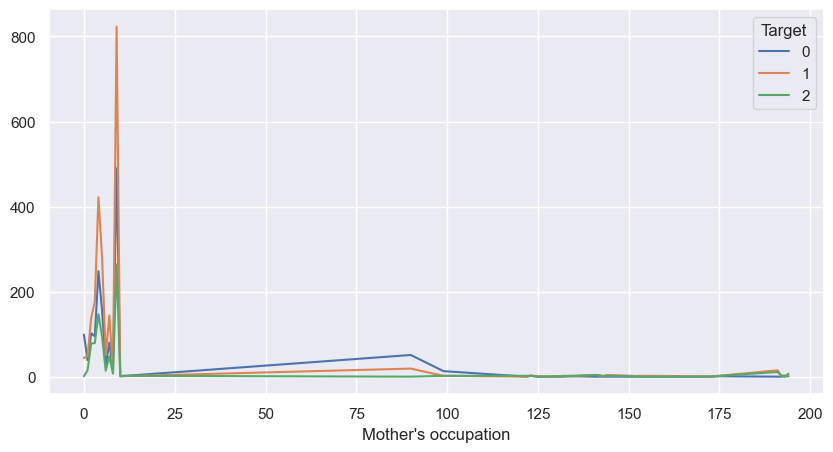

<Figure size 1500x600 with 0 Axes>

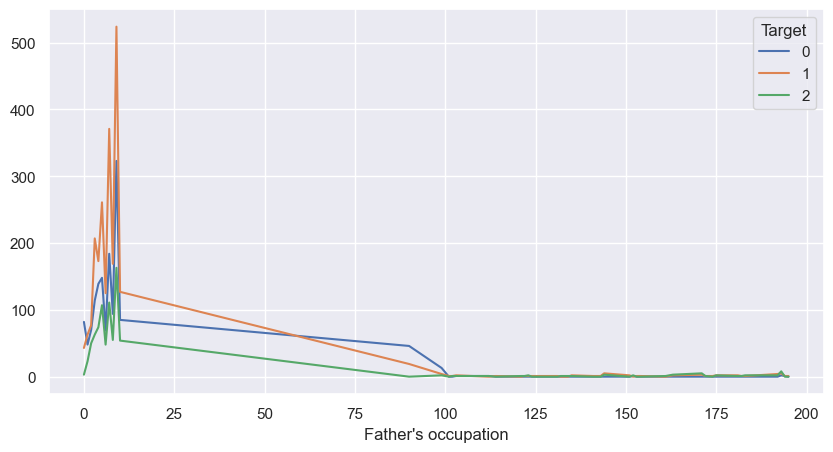

<Figure size 1500x600 with 0 Axes>

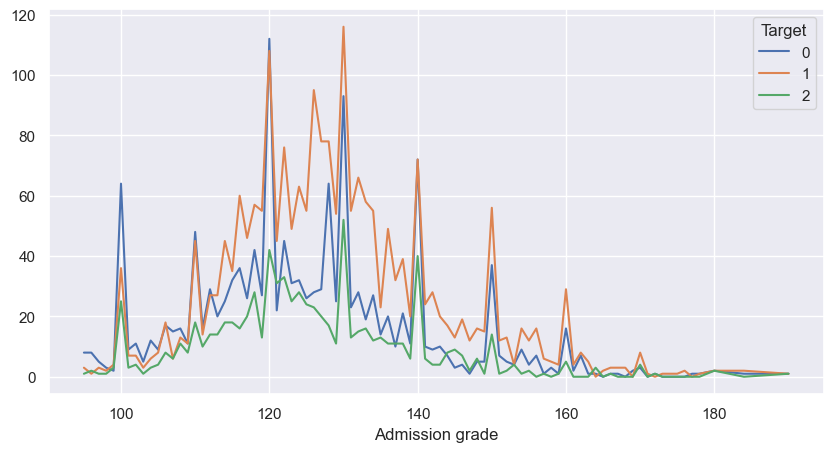

<Figure size 1500x600 with 0 Axes>

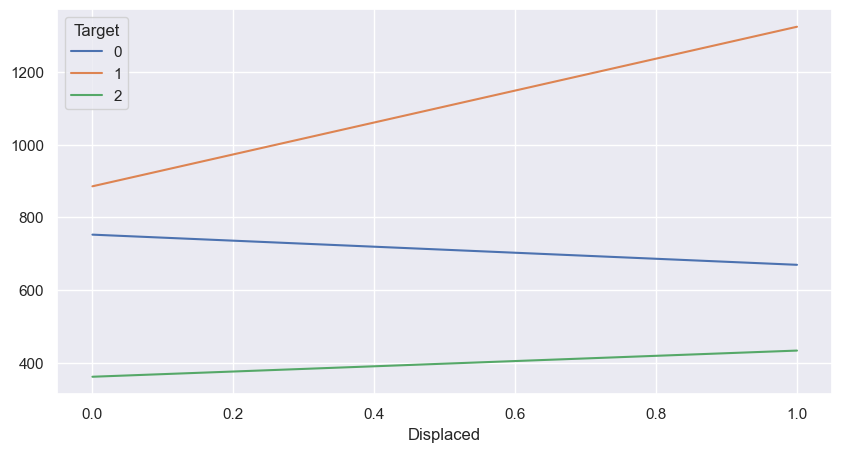

<Figure size 1500x600 with 0 Axes>

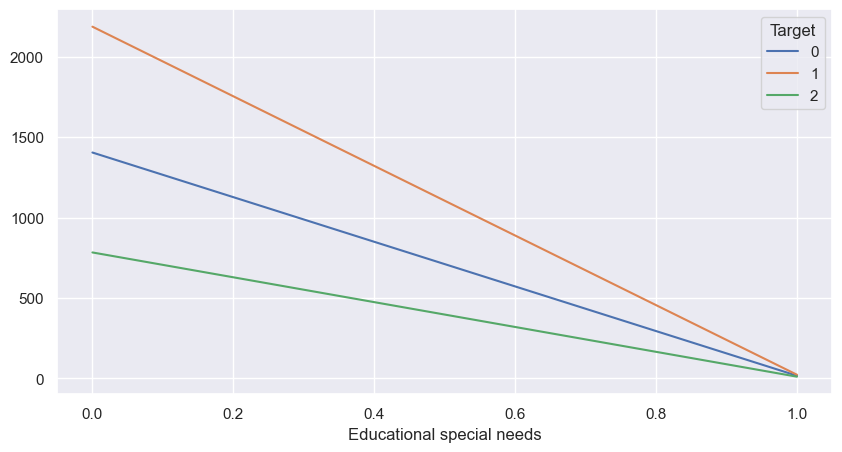

<Figure size 1500x600 with 0 Axes>

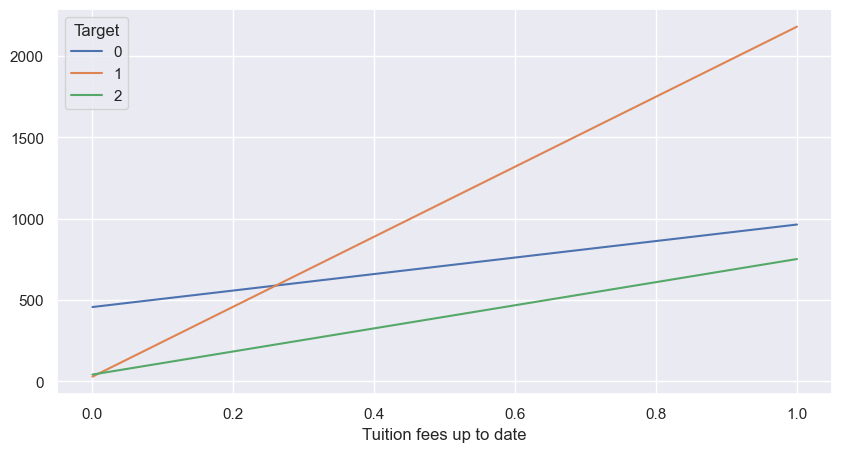

<Figure size 1500x600 with 0 Axes>

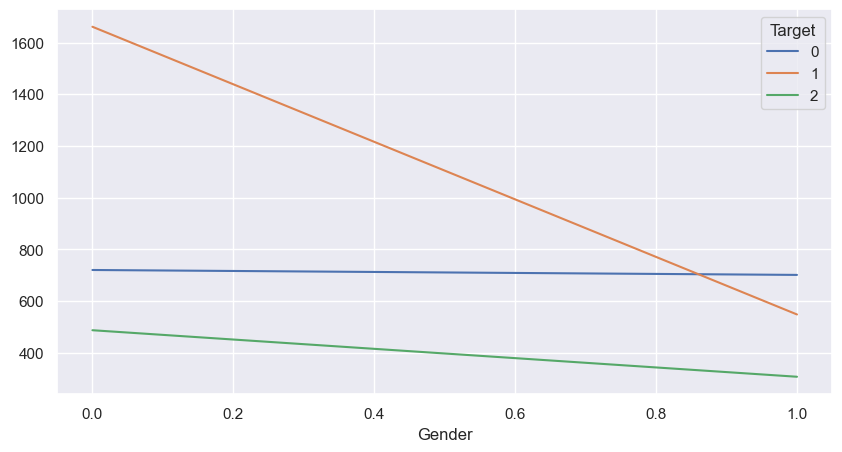

<Figure size 1500x600 with 0 Axes>

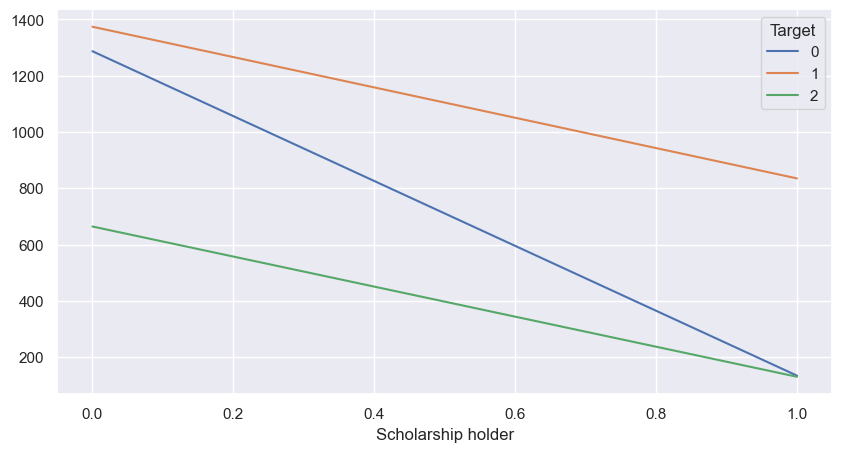

<Figure size 1500x600 with 0 Axes>

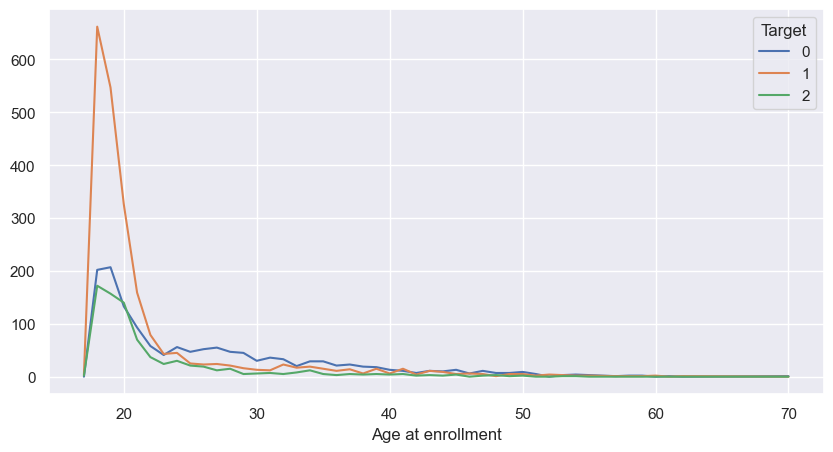

<Figure size 1500x600 with 0 Axes>

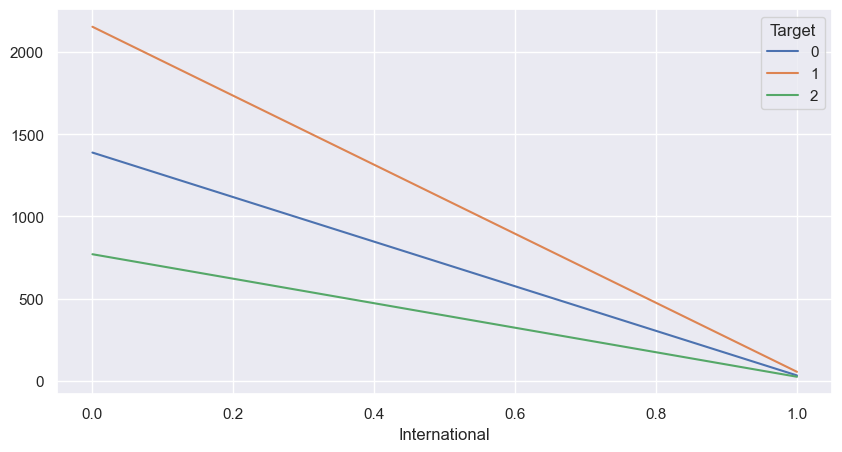

<Figure size 1500x600 with 0 Axes>

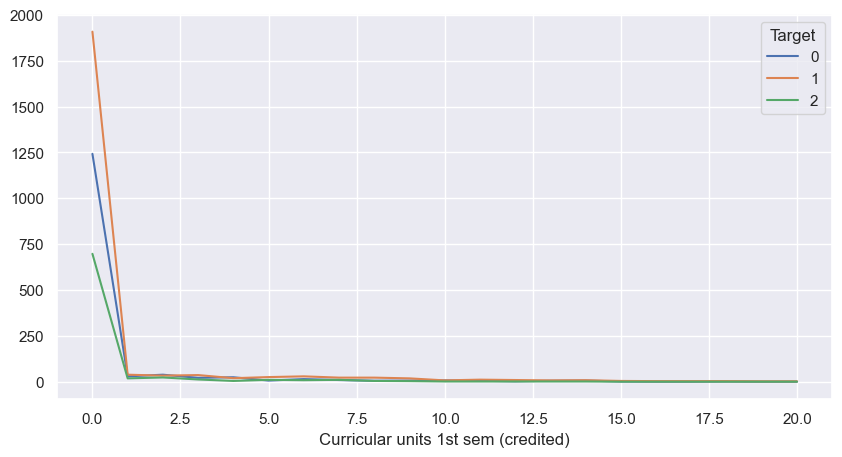

<Figure size 1500x600 with 0 Axes>

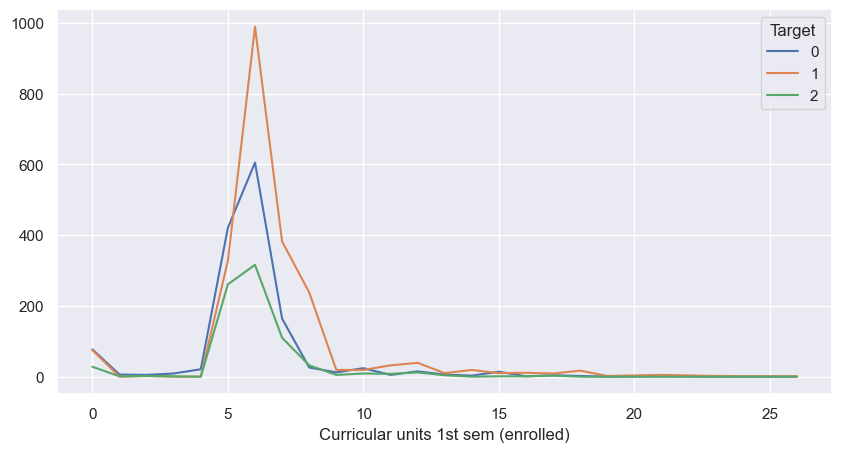

<Figure size 1500x600 with 0 Axes>

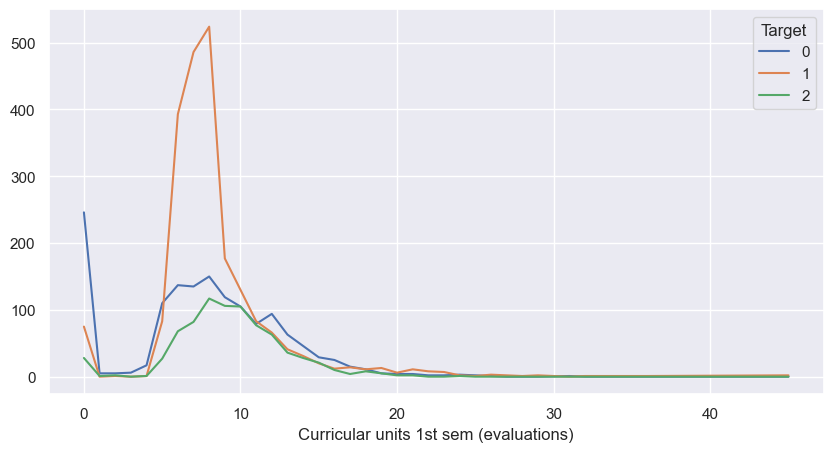

<Figure size 1500x600 with 0 Axes>

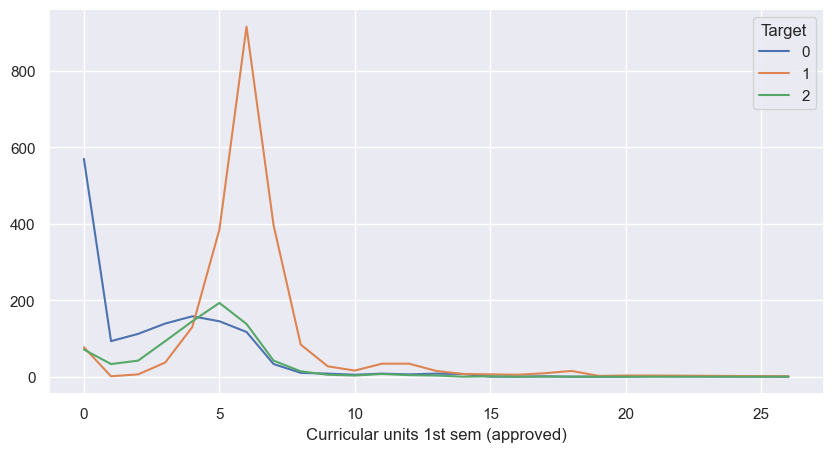

<Figure size 1500x600 with 0 Axes>

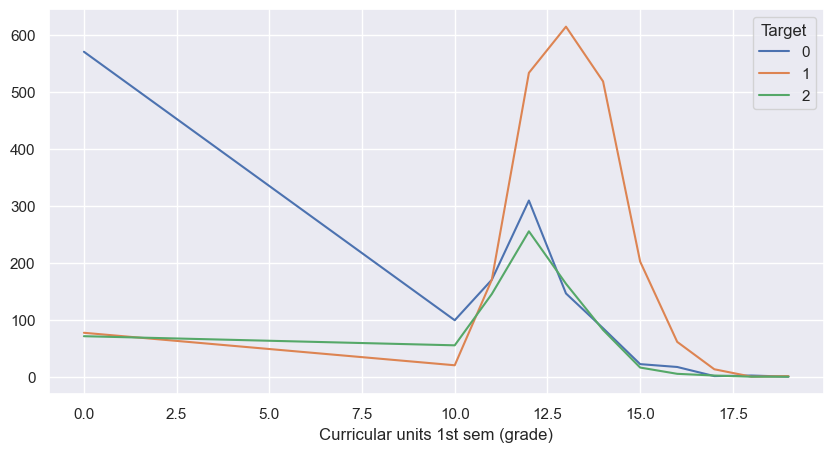

<Figure size 1500x600 with 0 Axes>

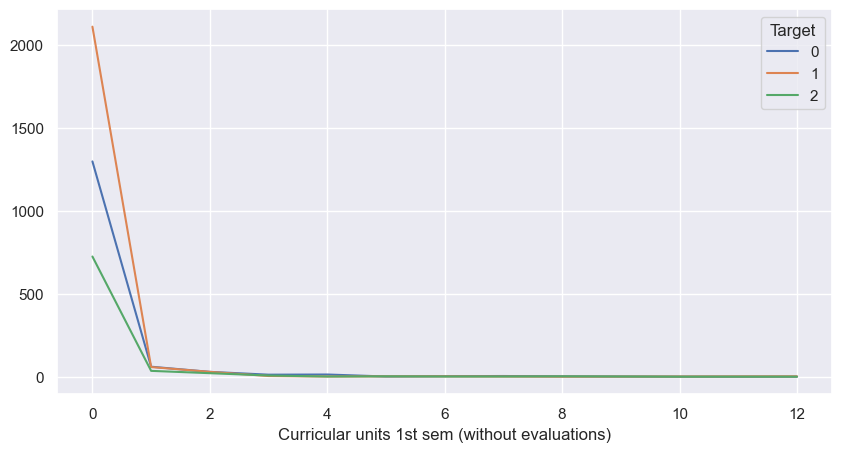

<Figure size 1500x600 with 0 Axes>

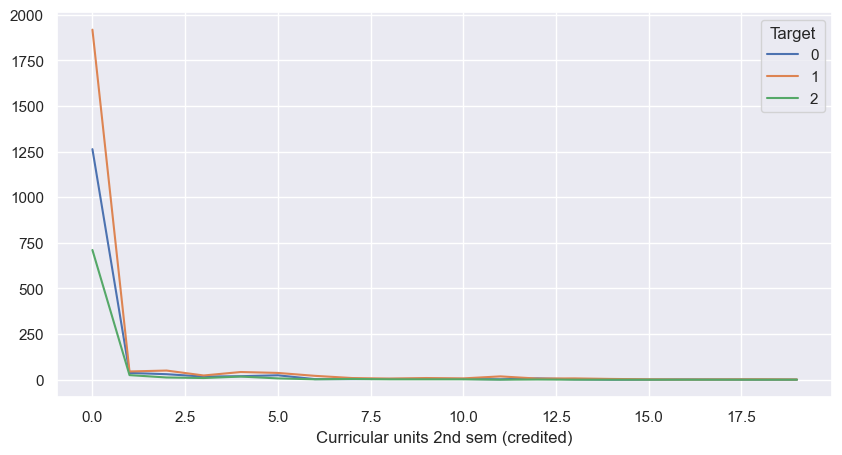

<Figure size 1500x600 with 0 Axes>

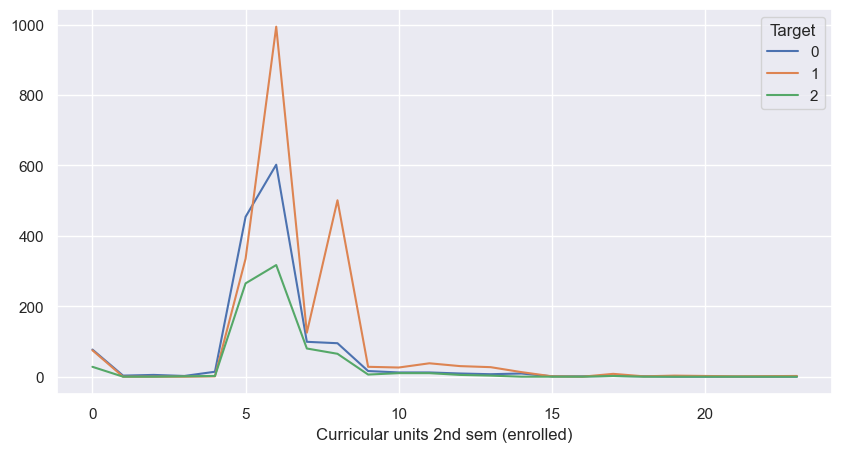

<Figure size 1500x600 with 0 Axes>

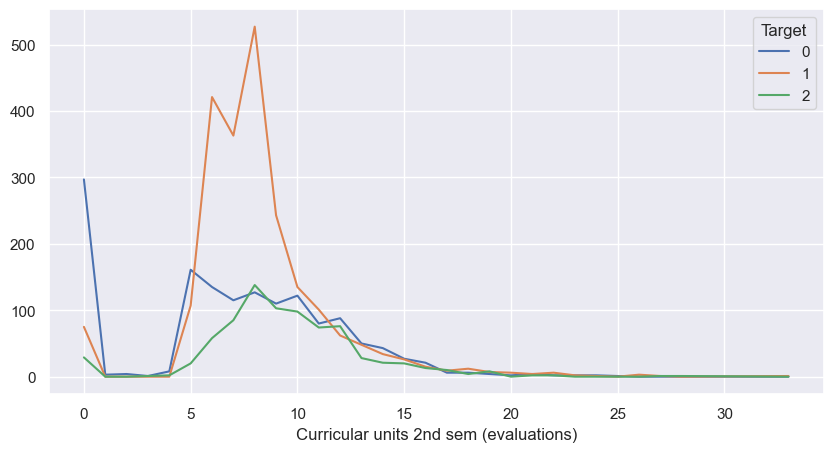

<Figure size 1500x600 with 0 Axes>

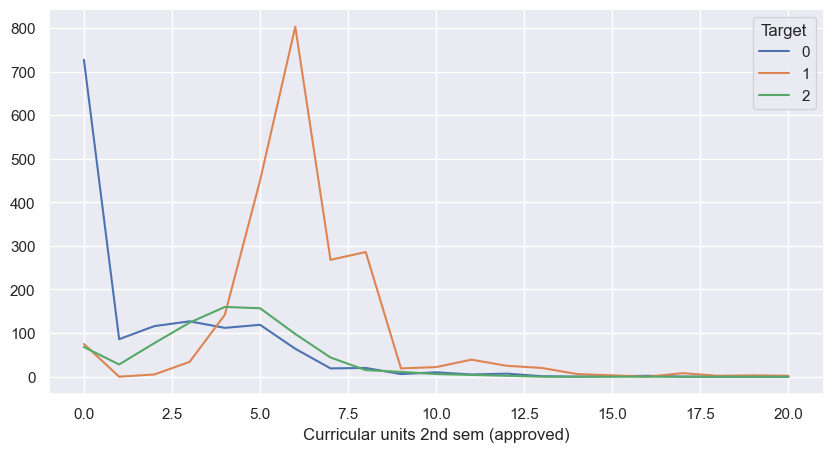

<Figure size 1500x600 with 0 Axes>

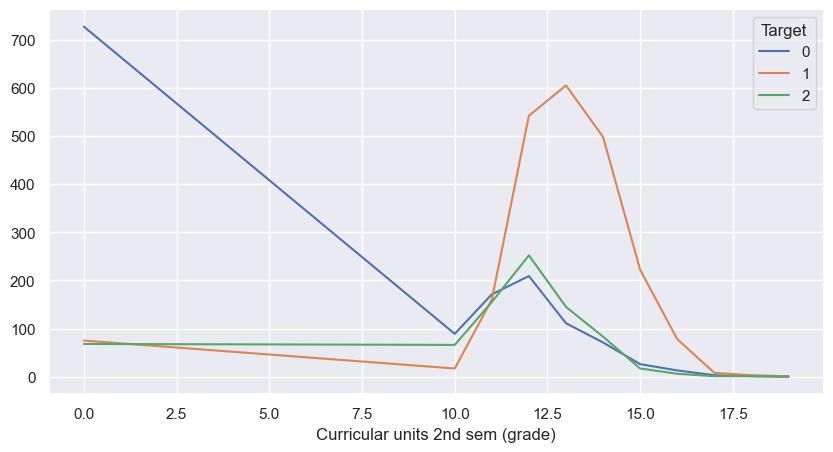

<Figure size 1500x600 with 0 Axes>

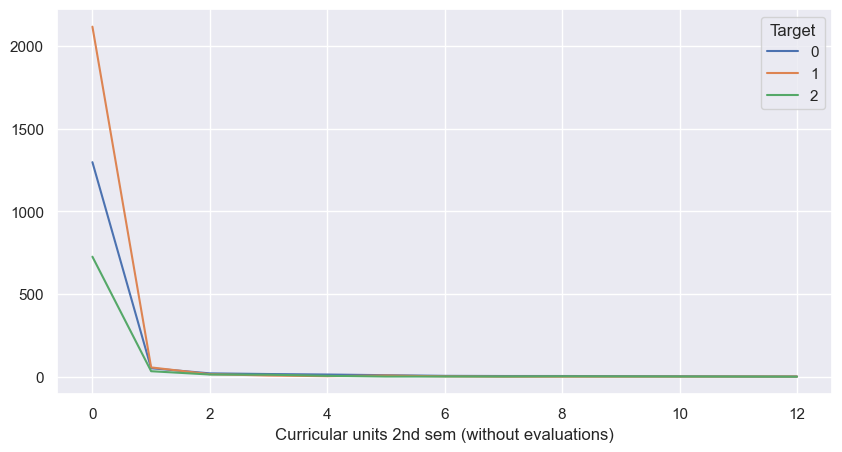

<Figure size 1500x600 with 0 Axes>

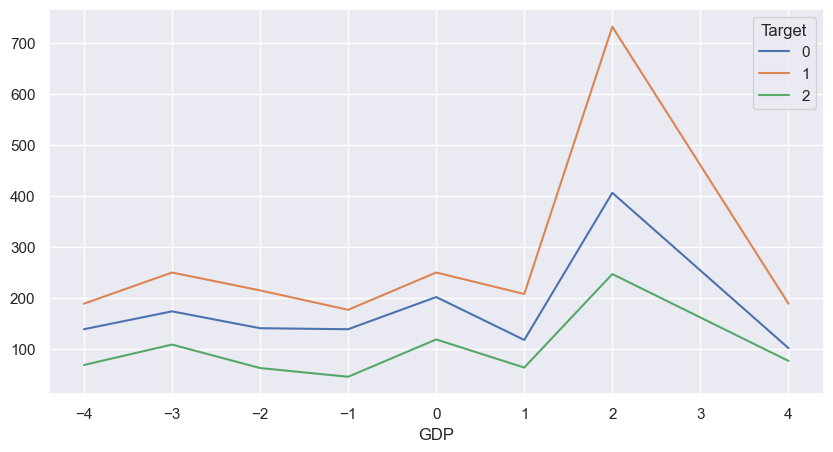

In [61]:
# creating line plots for cross-tabulations between each feature in df2 and the target variable Target.
# This can be a useful way to visualize the relationship between categorical variables and the target.
for i in df2.columns:
  plt.figure(figsize=(15,6))
  pd.crosstab(index=df2[i],columns=df1['Target']).plot(kind='line')
  plt.show()

In [62]:
df_corr = df1.corr()
df_corr

,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nationality,Mother's qualification,Father's qualification,Mother's occupation,Father's occupation,Admission grade,...,Curricular units 1st sem (grade),Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),GDP,Target
Course,1.000000,-0.043151,0.006654,-0.081073,-0.033923,0.054543,0.050724,0.031265,0.028881,-0.125120,...,0.388551,0.034514,-0.089817,0.401539,0.278797,0.198032,0.347852,0.030816,-0.022412,0.024210
Daytime/evening attendance\t,-0.043151,1.000000,-0.071871,0.052926,0.018530,-0.204767,-0.139894,-0.019067,-0.015477,0.008219,...,0.065506,0.045630,-0.111953,0.000371,0.014610,0.034022,0.050776,-0.004229,0.026390,0.066439
Previous qualification,0.006654,-0.071871,1.000000,0.103792,-0.029214,-0.013190,-0.006614,0.014822,0.016263,0.184318,...,0.000846,0.002887,0.143031,0.056179,0.114850,-0.008632,0.003527,0.005102,0.072609,-0.027984
Previous qualification (grade),-0.081073,0.052926,0.103792,1.000000,0.053903,-0.060908,-0.035358,-0.011535,-0.019378,0.581067,...,0.060965,-0.003963,-0.018421,-0.031591,-0.061337,0.050663,0.053656,-0.019093,-0.052347,0.025483
Nationality,-0.033923,0.018530,-0.029214,0.053903,1.000000,-0.049946,-0.085282,0.043187,0.020626,0.028349,...,0.000361,0.009145,-0.007278,-0.020113,-0.025721,-0.017880,-0.008845,-0.014041,0.036233,0.002098
Mother's qualification,0.054543,-0.204767,-0.013190,-0.060908,-0.049946,1.000000,0.535140,0.076772,0.052329,-0.054713,...,-0.035874,0.003183,0.042771,0.035150,0.021033,-0.014858,-0.031335,0.021305,-0.092137,-0.075941
Father's qualification,0.050724,-0.139894,-0.006614,-0.035358,-0.085282,0.535140,1.000000,0.054911,0.063043,-0.051956,...,-0.008875,-0.017333,0.042666,0.024380,0.009514,0.005285,-0.008949,-0.007430,-0.077705,-0.035183
Mother's occupation,0.031265,-0.019067,0.014822,-0.011535,0.043187,0.076772,0.054911,1.000000,0.910472,-0.040289,...,-0.015926,0.014218,0.000753,-0.006512,0.000633,-0.031861,-0.020585,0.013091,0.124583,0.051664
Father's occupation,0.028881,-0.015477,0.016263,-0.019378,0.020626,0.052329,0.063043,0.910472,1.000000,-0.037972,...,-0.008513,0.000043,-0.011025,-0.014098,-0.004087,-0.030411,-0.016155,-0.007664,0.131822,0.051455
Admission grade,-0.125120,0.008219,0.184318,0.581067,0.028349,-0.054713,-0.051956,-0.040289,-0.037972,1.000000,...,0.073476,0.008792,0.039645,-0.042061,-0.057253,0.076354,0.073982,-0.013346,-0.016403,0.038623


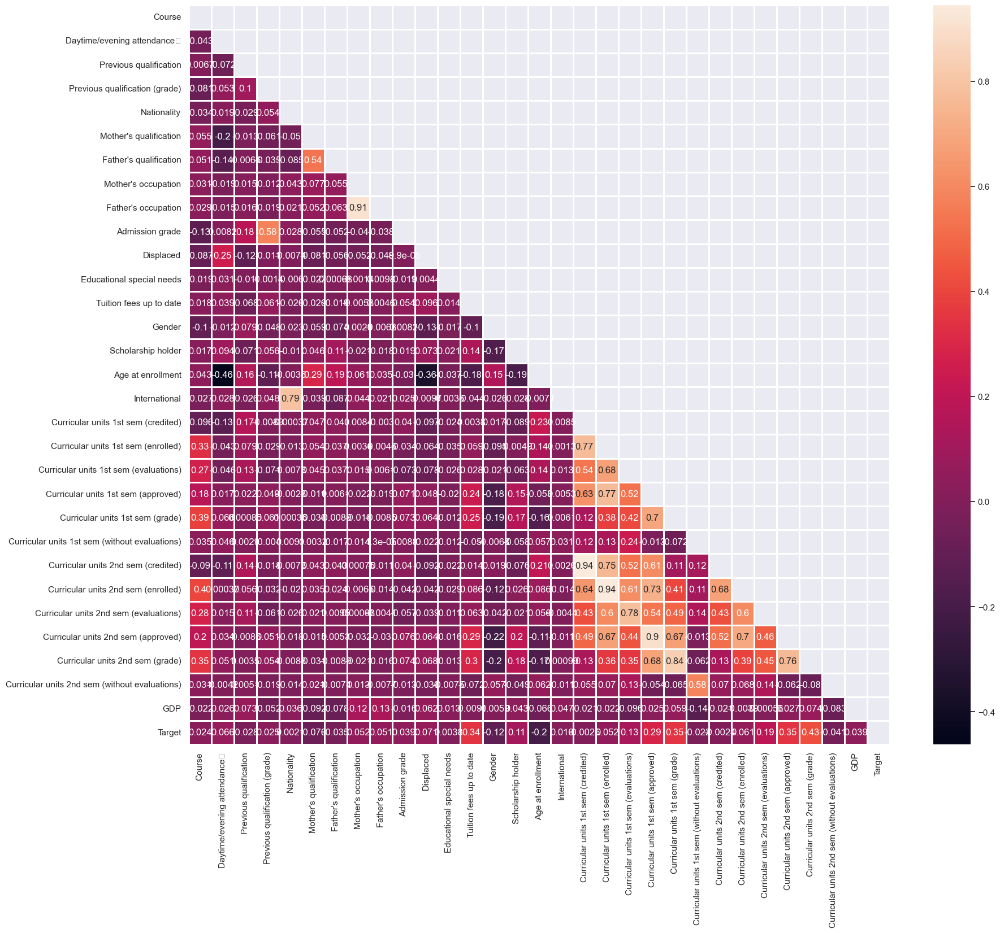

In [63]:
# Creating a heatmap of the correlation matrix (df_corr) using the seaborn library.
# This is a great way to visualize the correlation between different features in dataset.
plt.figure(figsize=(20, 17))
matrix = np.triu(df_corr)
sns.heatmap(df_corr, annot=True, linewidth=.8, mask=matrix, cmap="rocket");
plt.show()

# Predictive Models

## Model Training
<b> Before we proceed, we need to split the data into features (X) and the target variable (y). <br>
Additionally, we'll split the dataset into training and testing sets.<br>
Assuming 'Target' is the target variable, and we want to use all other columns as features, we can use the following codes to training data.The Preprocessing as following codes:

<b> 1) Defining Features and Label

In [64]:
# Assuming X contains features  
x = df1.drop(columns='Target', axis=1) # features
x.head()

,Course,Daytime/evening attendance\t,Previous qualification,Previous qualification (grade),Nationality,Mother's qualification,Father's qualification,Mother's occupation,Father's occupation,Admission grade,...,Curricular units 1st sem (approved),Curricular units 1st sem (grade),Curricular units 1st sem (without evaluations),Curricular units 2nd sem (credited),Curricular units 2nd sem (enrolled),Curricular units 2nd sem (evaluations),Curricular units 2nd sem (approved),Curricular units 2nd sem (grade),Curricular units 2nd sem (without evaluations),GDP
0,171,1,1,122,1,19,12,5,9,127,...,0,0,0,0,0,0,0,0,0,2
1,9254,1,1,160,1,1,3,3,3,142,...,6,14,0,0,6,6,6,14,0,1
2,9070,1,1,122,1,37,37,9,9,125,...,0,0,0,0,6,0,0,0,0,2
3,9773,1,1,122,1,38,37,5,3,120,...,6,13,0,0,6,10,5,12,0,-3
4,8014,0,1,100,1,37,38,9,9,142,...,5,12,0,0,6,6,6,13,0,1


In [65]:
# Assuming y contains the target variable
y = df1['Target'] # label
y.head()

0    0
1    1
2    0
3    1
4    1
Name: Target, dtype: int64

<b>2) Splitting the data into training data and testing data

In [66]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=2)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((3539, 30), (885, 30), (3539,), (885,))

<b>3) Training the model

<b> i) Using RandomForestClassifier Model
 

In [67]:
from sklearn.ensemble import RandomForestClassifier     ## import Model

In [68]:
modelRandomForestClassifier = RandomForestClassifier()   ##  Select a Model

In [69]:
modelRandomForestClassifier.fit(X_train, y_train)       ## Train the Model

RandomForestClassifier()

In [70]:
X_train_prediction_random_forest = modelRandomForestClassifier.predict(X_train)  ## Evaluate the Model

In [71]:

# Instantiate the model
model_rf = RandomForestClassifier()

# Train the model
model_rf.fit(X_train, y_train)

# Predictions on the training set
y_train_pred_rf = model_rf.predict(X_train)

# Evaluate the model on training set
accuracy_train_rf = accuracy_score(y_train, y_train_pred_rf)
conf_matrix_train_rf = confusion_matrix(y_train, y_train_pred_rf)
class_report_train_rf = classification_report(y_train, y_train_pred_rf)

# Predictions on the testing set
y_test_pred_rf = model_rf.predict(X_test)

# Evaluate the model on testing set
accuracy_test_rf = accuracy_score(y_test, y_test_pred_rf)
conf_matrix_test_rf = confusion_matrix(y_test, y_test_pred_rf)
class_report_test_rf = classification_report(y_test, y_test_pred_rf)

# Display results for training set
print("Random Forest Classifier - Training Set:")
print(f"Training Accuracy: {accuracy_train_rf}")
print("Confusion Matrix:\n", conf_matrix_train_rf)
print("Classification Report:\n", class_report_train_rf)

# Display results for testing set
print("\nRandom Forest Classifier - Testing Set:")
print(f"Testing Accuracy: {accuracy_test_rf}")
print("Confusion Matrix:\n", conf_matrix_test_rf)
print("Classification Report:\n", class_report_test_rf)


Random Forest Classifier - Training Set:
Training Accuracy: 0.9997174343034756
Confusion Matrix:
 [[1140    0    0]
 [   0 1758    0]
 [   0    1  640]]
Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00      1140
           1       1.00      1.00      1.00      1758
           2       1.00      1.00      1.00       641

    accuracy                           1.00      3539
   macro avg       1.00      1.00      1.00      3539
weighted avg       1.00      1.00      1.00      3539


Random Forest Classifier - Testing Set:
Testing Accuracy: 0.768361581920904
Confusion Matrix:
 [[206  52  23]
 [ 14 412  25]
 [ 33  58  62]]
Classification Report:
               precision    recall  f1-score   support

           0       0.81      0.73      0.77       281
           1       0.79      0.91      0.85       451
           2       0.56      0.41      0.47       153

    accuracy                           0.77       885
   m

<b>ii) Using DecisionTree Model

In [72]:
from sklearn.tree import DecisionTreeClassifier
modelDecisionTree = DecisionTreeClassifier()
modelDecisionTree.fit(X_train, y_train)

DecisionTreeClassifier()

In [73]:


# Instantiate the model
model_decision_tree = DecisionTreeClassifier()

# Train the model
model_decision_tree.fit(X_train, y_train)

# Predictions on the training set
y_train_pred_decision_tree = model_decision_tree.predict(X_train)

# Evaluate the model on training set
accuracy_train_decision_tree = accuracy_score(y_train, y_train_pred_decision_tree)
conf_matrix_train_decision_tree = confusion_matrix(y_train, y_train_pred_decision_tree)
class_report_train_decision_tree = classification_report(y_train, y_train_pred_decision_tree)

# Predictions on the testing set
y_test_pred_decision_tree = model_decision_tree.predict(X_test)

# Evaluate the model on testing set
accuracy_test_decision_tree = accuracy_score(y_test, y_test_pred_decision_tree)
conf_matrix_test_decision_tree = confusion_matrix(y_test, y_test_pred_decision_tree)
class_report_test_decision_tree = classification_report(y_test, y_test_pred_decision_tree)

# Display results for training set
print("Decision Tree - Training Set:")
print(f"Training Accuracy: {accuracy_train_decision_tree}")
print("Confusion Matrix:\n", conf_matrix_train_decision_tree)
print("Classification Report:\n", class_report_train_decision_tree)

# Display results for testing set
print("\nDecision Tree - Testing Set:")
print(f"Testing Accuracy: {accuracy_test_decision_tree}")
print("Confusion Matrix:\n", conf_matrix_test_decision_tree)
print("Classification Report:\n", class_report_test_decision_tree)


Decision Tree - Training Set:
Training Accuracy: 1.0
Confusion Matrix:
 [[1140    0    0]
 [   0 1758    0]
 [   0    0  641]]
Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00      1140
           1       1.00      1.00      1.00      1758
           2       1.00      1.00      1.00       641

    accuracy                           1.00      3539
   macro avg       1.00      1.00      1.00      3539
weighted avg       1.00      1.00      1.00      3539


Decision Tree - Testing Set:
Testing Accuracy: 0.6576271186440678
Confusion Matrix:
 [[187  44  50]
 [ 48 336  67]
 [ 46  48  59]]
Classification Report:
               precision    recall  f1-score   support

           0       0.67      0.67      0.67       281
           1       0.79      0.75      0.76       451
           2       0.34      0.39      0.36       153

    accuracy                           0.66       885
   macro avg       0.60      0.60      0

<b>iii) Using Support Vector Machine

In [74]:
from sklearn import svm   ## import Model
modelSVM = svm.SVC()
modelSVM.fit(X_train, y_train)

SVC()

In [75]:
from sklearn.svm import SVC

# Instantiate the model
model_svm = SVC()

# Train the model
model_svm.fit(X_train, y_train)

# Predictions on the training set
y_train_pred_svm = model_svm.predict(X_train)

# Evaluate the model on training set
accuracy_train_svm = accuracy_score(y_train, y_train_pred_svm)
conf_matrix_train_svm = confusion_matrix(y_train, y_train_pred_svm)
class_report_train_svm = classification_report(y_train, y_train_pred_svm)

# Predictions on the testing set
y_test_pred_svm = model_svm.predict(X_test)

# Evaluate the model on testing set
accuracy_test_svm = accuracy_score(y_test, y_test_pred_svm)
conf_matrix_test_svm = confusion_matrix(y_test, y_test_pred_svm)
class_report_test_svm = classification_report(y_test, y_test_pred_svm)

# Display results for training set
print("Support Vector Machine - Training Set:")
print(f"Training Accuracy: {accuracy_train_svm}")
print("Confusion Matrix:\n", conf_matrix_train_svm)
print("Classification Report:\n", class_report_train_svm)

# Display results for testing set
print("\nSupport Vector Machine - Testing Set:")
print(f"Testing Accuracy: {accuracy_test_svm}")
print("Confusion Matrix:\n", conf_matrix_test_svm)
print("Classification Report:\n", class_report_test_svm)


Support Vector Machine - Training Set:
Training Accuracy: 0.49675049448996894
Confusion Matrix:
 [[   0 1140    0]
 [   0 1758    0]
 [   0  641    0]]
Classification Report:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00      1140
           1       0.50      1.00      0.66      1758
           2       0.00      0.00      0.00       641

    accuracy                           0.50      3539
   macro avg       0.17      0.33      0.22      3539
weighted avg       0.25      0.50      0.33      3539


Support Vector Machine - Testing Set:
Testing Accuracy: 0.5096045197740113
Confusion Matrix:
 [[  0 281   0]
 [  0 451   0]
 [  0 153   0]]
Classification Report:
               precision    recall  f1-score   support

           0       0.00      0.00      0.00       281
           1       0.51      1.00      0.68       451
           2       0.00      0.00      0.00       153

    accuracy                           0.51       885
   mac

<b>iv) Using AdaBoost Model

In [76]:
from sklearn.ensemble import AdaBoostClassifier

# Instantiate the model
model_adaboost = AdaBoostClassifier()

# Train the model
model_adaboost.fit(X_train, y_train)

# Predictions on the training set
y_train_pred_adaboost = model_adaboost.predict(X_train)

# Evaluate the model on the training set
accuracy_train_adaboost = accuracy_score(y_train, y_train_pred_adaboost)
conf_matrix_train_adaboost = confusion_matrix(y_train, y_train_pred_adaboost)
class_report_train_adaboost = classification_report(y_train, y_train_pred_adaboost)

# Predictions on the testing set
y_test_pred_adaboost = model_adaboost.predict(X_test)

# Evaluate the model on the testing set
accuracy_test_adaboost = accuracy_score(y_test, y_test_pred_adaboost)
conf_matrix_test_adaboost = confusion_matrix(y_test, y_test_pred_adaboost)
class_report_test_adaboost = classification_report(y_test, y_test_pred_adaboost)

# Display results for training set
print("AdaBoost - Training Set:")
print(f"Training Accuracy: {accuracy_train_adaboost}")
print("Confusion Matrix:\n", conf_matrix_train_adaboost)
print("Classification Report:\n", class_report_train_adaboost)

# Display results for testing set
print("\nAdaBoost - Testing Set:")
print(f"Testing Accuracy: {accuracy_test_adaboost}")
print("Confusion Matrix:\n", conf_matrix_test_adaboost)
print("Classification Report:\n", class_report_test_adaboost)


AdaBoost - Training Set:
Training Accuracy: 0.7657530375812376
Confusion Matrix:
 [[ 880  114  146]
 [  64 1571  123]
 [ 152  230  259]]
Classification Report:
               precision    recall  f1-score   support

           0       0.80      0.77      0.79      1140
           1       0.82      0.89      0.86      1758
           2       0.49      0.40      0.44       641

    accuracy                           0.77      3539
   macro avg       0.70      0.69      0.70      3539
weighted avg       0.76      0.77      0.76      3539


AdaBoost - Testing Set:
Testing Accuracy: 0.7548022598870057
Confusion Matrix:
 [[201  47  33]
 [ 22 404  25]
 [ 31  59  63]]
Classification Report:
               precision    recall  f1-score   support

           0       0.79      0.72      0.75       281
           1       0.79      0.90      0.84       451
           2       0.52      0.41      0.46       153

    accuracy                           0.75       885
   macro avg       0.70      0.67  

<b>v) Using Neural Network Model

In [77]:
from sklearn.neural_network import MLPClassifier

# Instantiate the model
model_neural_network = MLPClassifier()

# Train the model
model_neural_network.fit(X_train, y_train)

# Predictions on the training set
y_train_pred_nn = model_neural_network.predict(X_train)

# Evaluate the model on the training set
accuracy_train_nn = accuracy_score(y_train, y_train_pred_nn)
conf_matrix_train_nn = confusion_matrix(y_train, y_train_pred_nn)
class_report_train_nn = classification_report(y_train, y_train_pred_nn)

# Predictions on the testing set
y_test_pred_nn = model_neural_network.predict(X_test)

# Evaluate the model on the testing set
accuracy_test_nn = accuracy_score(y_test, y_test_pred_nn)
conf_matrix_test_nn = confusion_matrix(y_test, y_test_pred_nn)
class_report_test_nn = classification_report(y_test, y_test_pred_nn)

# Display results for training set
print("Neural Network - Training Set:")
print(f"Training Accuracy: {accuracy_train_nn}")
print("Confusion Matrix:\n", conf_matrix_train_nn)
print("Classification Report:\n", class_report_train_nn)

# Display results for testing set
print("\nNeural Network - Testing Set:")
print(f"Testing Accuracy: {accuracy_test_nn}")
print("Confusion Matrix:\n", conf_matrix_test_nn)
print("Classification Report:\n", class_report_test_nn)


Neural Network - Training Set:
Training Accuracy: 0.6459451822548743
Confusion Matrix:
 [[ 561  573    6]
 [  41 1715    2]
 [  51  580   10]]
Classification Report:
               precision    recall  f1-score   support

           0       0.86      0.49      0.63      1140
           1       0.60      0.98      0.74      1758
           2       0.56      0.02      0.03       641

    accuracy                           0.65      3539
   macro avg       0.67      0.49      0.47      3539
weighted avg       0.67      0.65      0.58      3539


Neural Network - Testing Set:
Testing Accuracy: 0.6338983050847458
Confusion Matrix:
 [[124 156   1]
 [ 14 434   3]
 [ 12 138   3]]
Classification Report:
               precision    recall  f1-score   support

           0       0.83      0.44      0.58       281
           1       0.60      0.96      0.74       451
           2       0.43      0.02      0.04       153

    accuracy                           0.63       885
   macro avg       0.62

<b> vi) Logistic Regression Model

In [78]:
from sklearn.linear_model import LogisticRegression

# Instantiate the model
model_logistic_regression = LogisticRegression()

# Train the model
model_logistic_regression.fit(X_train, y_train)

# Predictions on the training set
y_train_pred_lr = model_logistic_regression.predict(X_train)

# Evaluate the model on the training set
accuracy_train_lr = accuracy_score(y_train, y_train_pred_lr)
conf_matrix_train_lr = confusion_matrix(y_train, y_train_pred_lr)
class_report_train_lr = classification_report(y_train, y_train_pred_lr)

# Predictions on the testing set
y_test_pred_lr = model_logistic_regression.predict(X_test)

# Evaluate the model on the testing set
accuracy_test_lr = accuracy_score(y_test, y_test_pred_lr)
conf_matrix_test_lr = confusion_matrix(y_test, y_test_pred_lr)
class_report_test_lr = classification_report(y_test, y_test_pred_lr)

# Display results for training set
print("Logistic Regression - Training Set:")
print(f"Training Accuracy: {accuracy_train_lr}")
print("Confusion Matrix:\n", conf_matrix_train_lr)
print("Classification Report:\n", class_report_train_lr)

# Display results for testing set
print("\nLogistic Regression - Testing Set:")
print(f"Testing Accuracy: {accuracy_test_lr}")
print("Confusion Matrix:\n", conf_matrix_test_lr)
print("Classification Report:\n", class_report_test_lr)


Logistic Regression - Training Set:
Training Accuracy: 0.6798530658378072
Confusion Matrix:
 [[ 745  394    1]
 [ 100 1654    4]
 [ 130  504    7]]
Classification Report:
               precision    recall  f1-score   support

           0       0.76      0.65      0.70      1140
           1       0.65      0.94      0.77      1758
           2       0.58      0.01      0.02       641

    accuracy                           0.68      3539
   macro avg       0.67      0.54      0.50      3539
weighted avg       0.67      0.68      0.61      3539


Logistic Regression - Testing Set:
Testing Accuracy: 0.6802259887005649
Confusion Matrix:
 [[172 107   2]
 [ 27 424   0]
 [ 33 114   6]]
Classification Report:
               precision    recall  f1-score   support

           0       0.74      0.61      0.67       281
           1       0.66      0.94      0.77       451
           2       0.75      0.04      0.07       153

    accuracy                           0.68       885
   macro avg 

### Creating a dataframe out of all the Scores of the all models

In [79]:


from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report

# Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

# Dictionary to store results
results = {
    "Model": [],
    "Train Accuracy": [],
    "Test Accuracy": [],
    "Train Precision": [],
    "Test Precision": [],
    "Train Recall": [],
    "Test Recall": [],
    "Train F1-Score": [],
    "Test F1-Score": [],
}

# List of models to try
models = {
    "Random Forest": RandomForestClassifier(),
    "SVM": SVC(),
    "AdaBoost": AdaBoostClassifier(),
    "Neural Network": MLPClassifier(),
    "Logistic Regression": LogisticRegression() ,
    "Decision Tree": DecisionTreeClassifier(),
}

# Train and evaluate each model
for name, model in models.items():
    print(f"Training and evaluating {name}...")
    
    # Train the model
    model.fit(X_train, y_train)
    
    # Predictions on the training set
    y_train_pred = model.predict(X_train)
    
    # Predictions on the testing set
    y_test_pred = model.predict(X_test)
    
    # Calculate metrics
    accuracy_train = accuracy_score(y_train, y_train_pred)
    accuracy_test = accuracy_score(y_test, y_test_pred)
    
    precision_train = precision_score(y_train, y_train_pred, average='weighted')
    precision_test = precision_score(y_test, y_test_pred, average='weighted')
    
    recall_train = recall_score(y_train, y_train_pred, average='weighted')
    recall_test = recall_score(y_test, y_test_pred, average='weighted')
    
    f1_train = f1_score(y_train, y_train_pred, average='weighted')
    f1_test = f1_score(y_test, y_test_pred, average='weighted')
    
    # Store results in the dictionary
    results["Model"].append(name)
    results["Train Accuracy"].append(accuracy_train)
    results["Test Accuracy"].append(accuracy_test)
    results["Train Precision"].append(precision_train)
    results["Test Precision"].append(precision_test)
    results["Train Recall"].append(recall_train)
    results["Test Recall"].append(recall_test)
    results["Train F1-Score"].append(f1_train)
    results["Test F1-Score"].append(f1_test)
    
    # Display results
    print(f"\n{30*'='}\n{name}\n{30*'='}")
    print(f"Training Accuracy: {accuracy_train}")
    print(f"Testing Accuracy: {accuracy_test}")
    print(f"Training Precision: {precision_train}")
    print(f"Testing Precision: {precision_test}")
    print(f"Training Recall: {recall_train}")
    print(f"Testing Recall: {recall_test}")
    print(f"Training F1-Score: {f1_train}")
    print(f"Testing F1-Score: {f1_test}")
    print("\n\n")

# Create a DataFrame from the results dictionary
results_df = pd.DataFrame(results)

# Display the DataFrame
print(results_df)


Training and evaluating Random Forest...

Random Forest
Training Accuracy: 1.0
Testing Accuracy: 0.7661016949152543
Training Precision: 1.0
Testing Precision: 0.7528751063426324
Training Recall: 1.0
Testing Recall: 0.7661016949152543
Training F1-Score: 1.0
Testing F1-Score: 0.7533933440844933



Training and evaluating SVM...

SVM
Training Accuracy: 0.5060751624752755
Testing Accuracy: 0.47231638418079097
Training Precision: 0.2561120700743765
Testing Precision: 0.22308276676561653
Training Recall: 0.5060751624752755
Testing Recall: 0.47231638418079097
Training F1-Score: 0.3401052968079619
Testing F1-Score: 0.3030364521681821



Training and evaluating AdaBoost...

AdaBoost
Training Accuracy: 0.7714043515117265
Testing Accuracy: 0.7401129943502824
Training Precision: 0.755746200006817
Testing Precision: 0.7203285364923975
Training Recall: 0.7714043515117265
Testing Recall: 0.7401129943502824
Training F1-Score: 0.7593706258287294
Testing F1-Score: 0.724692283167532



Training and evalu

In [80]:
results_df

,Model,Train Accuracy,Test Accuracy,Train Precision,Test Precision,Train Recall,Test Recall,Train F1-Score,Test F1-Score
0,Random Forest,1.000000,0.766102,1.000000,0.752875,1.000000,0.766102,1.000000,0.753393
1,SVM,0.506075,0.472316,0.256112,0.223083,0.506075,0.472316,0.340105,0.303036
2,AdaBoost,0.771404,0.740113,0.755746,0.720329,0.771404,0.740113,0.759371,0.724692
3,Neural Network,0.588019,0.553672,0.702102,0.622320,0.588019,0.553672,0.493812,0.460359
4,Logistic Regression,0.687482,0.677966,0.671771,0.669304,0.687482,0.677966,0.631829,0.621715
5,Decision Tree,1.000000,0.685876,1.000000,0.684601,1.000000,0.685876,1.000000,0.685120


### Explore Results

#### Exploring the results of a predictive modeling project involves analyzing various aspects to gain insights into the model's performance and understand its behavior. Here are some common steps in exploring results:

<b>1. Extract and display feature importances and visualizea feature importance with a bar plot

                                           Feature  Importance
26             Curricular units 2nd sem (approved)    0.360544
9                                  Admission grade    0.054042
3                   Previous qualification (grade)    0.052061
12                         Tuition fees up to date    0.044201
15                               Age at enrollment    0.042397
24             Curricular units 2nd sem (enrolled)    0.042000
0                                           Course    0.039570
29                                             GDP    0.039132
19          Curricular units 1st sem (evaluations)    0.037940
25          Curricular units 2nd sem (evaluations)    0.036719
20             Curricular units 1st sem (approved)    0.033955
8                              Father's occupation    0.031272
27                Curricular units 2nd sem (grade)    0.028933
5                           Mother's qualification    0.026899
7                              Mother's occupation    0

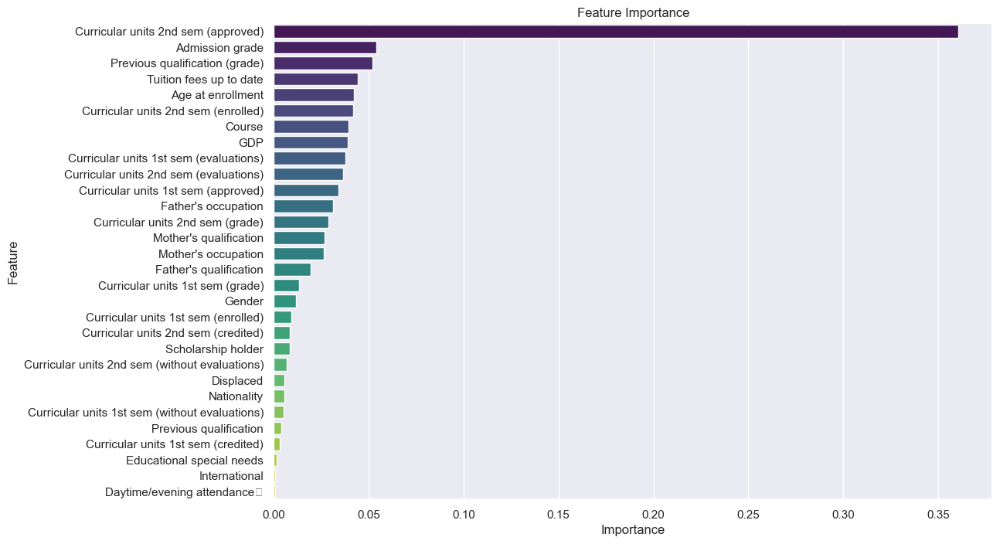

In [81]:
# Assuming 'model' is trained model (e.g., RandomForestClassifier)
feature_importances = model.feature_importances_

# Create a DataFrame to display feature importance scores
feature_importance_df = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': feature_importances
})

# Sort the DataFrame by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Print the feature importance DataFrame
print(feature_importance_df)

# Visualize feature importance with a bar plot
plt.figure(figsize=(12, 8))
sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis')
plt.title('Feature Importance')
plt.show()


In [82]:
## displays the feature importances of the model
feature_importance_df

,Feature,Importance
26,Curricular units 2nd sem (approved),0.360544
9,Admission grade,0.054042
3,Previous qualification (grade),0.052061
12,Tuition fees up to date,0.044201
15,Age at enrollment,0.042397
24,Curricular units 2nd sem (enrolled),0.042000
0,Course,0.039570
29,GDP,0.039132
19,Curricular units 1st sem (evaluations),0.037940
25,Curricular units 2nd sem (evaluations),0.036719


<b>2. Classification Report<br>
<b> Generate a classification report to get precision, recall, and F1-score for each class.

In [83]:

from sklearn.metrics import classification_report

# Assign best model to a clear variable
best_model = model_rf
class_report = classification_report(y_train, y_train_pred_rf)
print(class_report)



              precision    recall  f1-score   support

           0       0.31      0.32      0.31      1105
           1       0.50      0.49      0.50      1791
           2       0.16      0.16      0.16       643

    accuracy                           0.38      3539
   macro avg       0.32      0.32      0.32      3539
weighted avg       0.38      0.38      0.38      3539



<b>3. Correlation of each feature in the DataFrame  with the target variable 'Target' and then plots these correlations in a bar chart

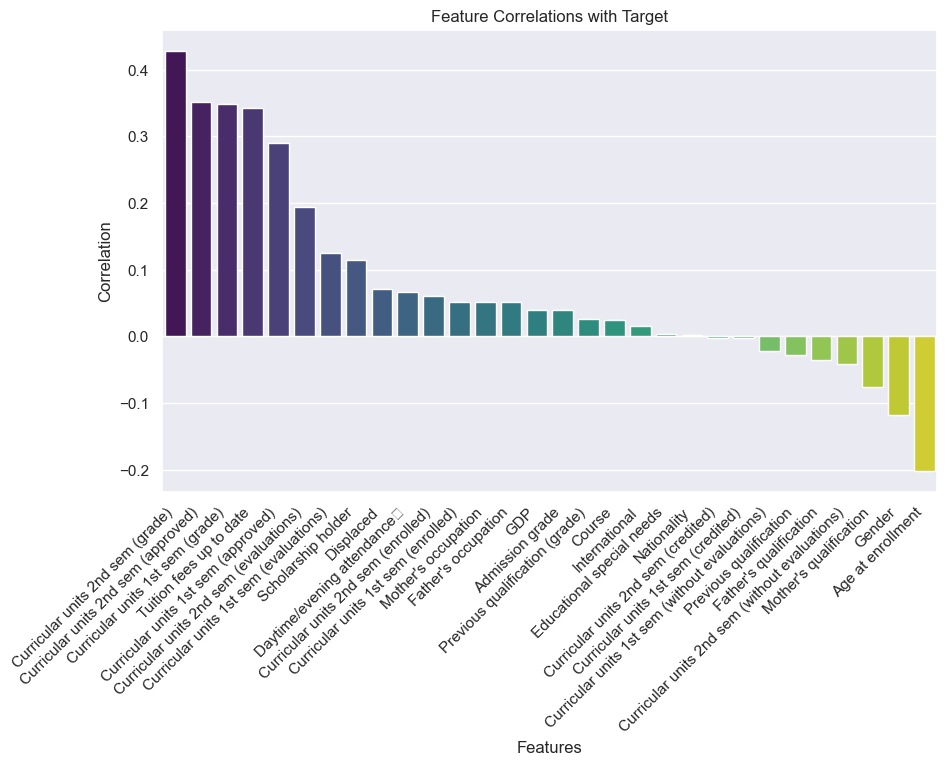

In [84]:
# Assuming 'df1' contains both features and the target variable 'Target'
correlation_with_target = df1.corr()['Target'].sort_values(ascending=False)

# Set up the matplotlib figure size
plt.figure(figsize=(10, 6))

# Plot the correlations with the target (excluding the target itself)
correlation_with_target.drop('Target').plot(kind='bar')
sns.barplot(x=correlation_with_target.drop('Target').index, y=correlation_with_target.drop('Target').values, palette='viridis')

# Add a title to the bar chart
plt.title("Feature Correlations with Target")

# Add labels to the x and y axes
plt.xlabel("Features")
plt.ylabel("Correlation")
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility

# Display the bar chart
plt.show()




<b>4. Visualizing the combined ROC curves for multi-class classification and presents predictions for 10 randomly selected students using each of the predictive models tested.



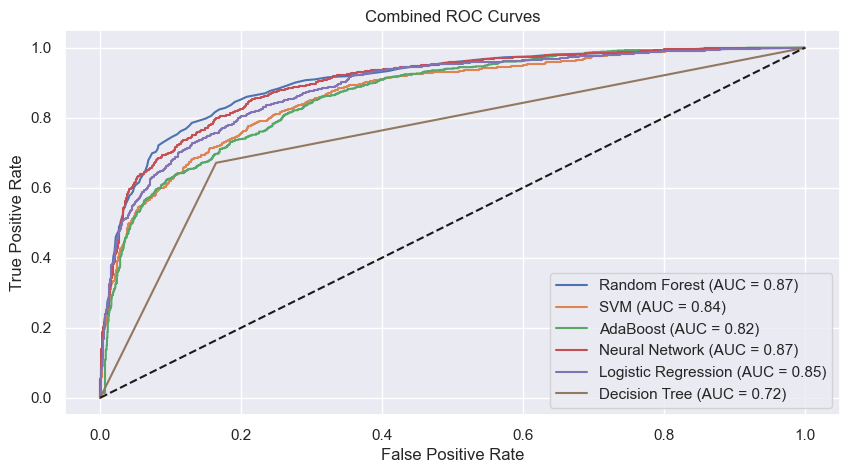


Model: Random Forest
AUC ROC: 0.87
Precision: 0.71
Recall: 0.67
Accuracy: 0.77
F1 Score: 0.68

Model: SVM
AUC ROC: 0.84
Precision: 0.47
Recall: 0.49
Accuracy: 0.64
F1 Score: 0.45

Model: AdaBoost
AUC ROC: 0.82
Precision: 0.67
Recall: 0.64
Accuracy: 0.74
F1 Score: 0.65

Model: Neural Network
AUC ROC: 0.87
Precision: 0.64
Recall: 0.63
Accuracy: 0.74
F1 Score: 0.62

Model: Logistic Regression
AUC ROC: 0.85
Precision: 0.65
Recall: 0.62
Accuracy: 0.72
F1 Score: 0.62

Model: Decision Tree
AUC ROC: 0.72
Precision: 0.60
Recall: 0.60
Accuracy: 0.67
F1 Score: 0.60

Predictions using Random Forest:
[0 1 1 1 0 2 1 1 1 1]

Predictions using SVM:
[0 1 1 1 0 1 1 1 1 1]

Predictions using AdaBoost:
[0 1 1 1 0 2 1 1 1 1]

Predictions using Neural Network:
[0 1 1 2 0 2 1 1 1 1]

Predictions using Logistic Regression:
[0 1 1 1 0 2 1 1 1 1]

Predictions using Decision Tree:
[2 1 1 2 0 2 1 1 1 1]


In [85]:



# Categorical Columns
categorical_columns = [
    'Course', 'Daytime/evening attendance\t',
    'Previous qualification', 'Nationality', "Mother's qualification", "Father's qualification",
    "Mother's occupation", "Father's occupation", 'Displaced', 'Educational special needs',
   'Tuition fees up to date', 'Gender', 'Scholarship holder', 'International'
]


# Preprocess the categorical columns
label_encoder = LabelEncoder()
for column in categorical_columns:
    df1[column] = label_encoder.fit_transform(df1[column])

# Prepare the data
x = df1.drop(columns='Target', axis=1)  # Features
y = df1['Target']  # Labels

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

# List of models to try
models = {
    "Random Forest": RandomForestClassifier(),
    "SVM": SVC(probability=True),
    "AdaBoost": AdaBoostClassifier(),
    "Neural Network": MLPClassifier(),
    "Logistic Regression": LogisticRegression(),
    "Decision Tree": DecisionTreeClassifier()
}

# Create a dictionary to store evaluation metrics
evaluation_metrics = {}

# Evaluate each model
for model_name, model in models.items():
    model.fit(X_train, y_train)
    y_pred_proba = model.predict_proba(X_test)
    
    # Calculate evaluation metrics
    auc_roc = roc_auc_score(pd.get_dummies(y_test), y_pred_proba, multi_class='ovr', average='macro')
    y_pred = model.predict(X_test)
    precision = precision_score(y_test, y_pred, average='macro')
    recall = recall_score(y_test, y_pred, average='macro')
    accuracy = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred, average='macro')
    
    # Store evaluation metrics in the dictionary
    evaluation_metrics[model_name] = {
        'AUC ROC': auc_roc,
        'Precision': precision,
        'Recall': recall,
        'Accuracy': accuracy,
        'F1 Score': f1
    }
    
    # Plot ROC curve for each class (multi-class scenario)
    fpr, tpr, _ = roc_curve(pd.get_dummies(y_test).values.ravel(), y_pred_proba.ravel())
    plt.plot(fpr, tpr, label=f'{model_name} (AUC = {auc_roc:.2f})')

# Plot combined ROC curves
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Combined ROC Curves')
plt.legend(loc='lower right')
plt.show()

# Display evaluation metrics for each model
for model_name, metrics in evaluation_metrics.items():
    print(f"\nModel: {model_name}")
    for metric_name, metric_value in metrics.items():
        print(f"{metric_name}: {metric_value:.2f}")

# Predictions for 10 students using each model
sample_students = x.sample(10, random_state=42)
for model_name, model in models.items():
    predictions = model.predict(sample_students)
    print(f"\nPredictions using {model_name}:")
    print(predictions)


The results provide insights into the effectiveness of different models in predicting student success based on the given features. The results from this shows that the Random Forest model has the highest AUC at 0.87, which means that it is the most effective predictive model which backs up the earlier model testing.

#  Conclusion


<b> This project served to analyze all of the factors that could affect the success of students and their graduation rates. To do this, 6 different classification models, were built, trained, and tested in order to find out which one was the most effective as a predictive model. The testing of all of the models showed that the Random Forest model was the most effective at predicting the success (graduation vs dropout rates) of students, based on the attributes used from the dataset, with an accuracy rate of 77%. This is further confirmed with the combined ROC curves which show that the Random Forest model has the highest AUC value at 0.87. Based on this, the final model selection for this project was the Random Forest Model, because of its high accuracy in predicting the success of a student in the classroom, which makes it a suitable model for the purposes of this project.

In [86]:
import platform
import os
from datetime import datetime
import getpass

# Get system information
system_info = {
    'System': platform.system(),
    'Release': platform.release(),
    'Version': platform.version(),
    'Architecture': platform.architecture(),
    'Processor': platform.processor(),
    'Python Version': platform.python_version(),
    'Username': getpass.getuser(),
    'Current Working Directory': os.getcwd(),
    'Last Update': datetime.now().strftime("%Y-%m-%d %H:%M:%S"),
}

# Display system information
for key, value in system_info.items():
    print(f"{key}: {value}")


System: Windows
Release: 10
Version: 10.0.22621
Architecture: ('64bit', 'WindowsPE')
Processor: Intel64 Family 6 Model 140 Stepping 1, GenuineIntel
Python Version: 3.9.12
Username: naiem
Current Working Directory: C:\Users\naiem\OneDrive\Desktop\CAPSTONE PROJ_ 44-688\Capstone-Project
Last Update: 2023-11-23 02:48:57
